# Generative Adversarial Networks
In this assignment, you’ll get hands-on experience coding and training GANs. This assignment is divided into two parts: in the first part, we will implement a specific type of GAN designed to process images, called a Conditional GAN (CGAN). We’ll train the CGAN to generate images from samples of random noise. In the second part, we will interpolate some images for that you will be given a model.

**Note:** Please attempt this assignment on Google Colab, since that will speed up the training process. 

In [71]:
import os
import keras
import random
import numpy as np
from glob import glob
import tensorflow as tf
import keras.backend as K
from keras.layers import *
from scipy.stats import norm
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import tensorflow_datasets as tfds
from keras.utils import to_categorical
from keras.models import Sequential, Model
from keras.initializers import RandomNormal
from mpl_toolkits.axes_grid1 import ImageGrid
from keras.utils.generic_utils import Progbar
from keras.optimizers import Adam, SGD, RMSprop
from keras.preprocessing.image import ImageDataGenerator
from google_drive_downloader import GoogleDriveDownloader as gdd
import os.path
import os
from numpy.random import randn
from numpy.random import randint
from tensorflow.python.keras.preprocessing import image as k_image
from keras.models import load_model

In [72]:
from google.colab import drive
drive.mount('/drive', force_remount=True)

Mounted at /drive


**NOTE** 
1. You need to change your notebook name to CS437_DL_HW5_[YOUR ID] 
2. Just upload the Notebook, you don't need to zip it 

In [5]:
# Use these variables
ROLLNUMBER = 21100157
BATCH_SIZE = 64   # take a small batch size so that your runtime won't crash
IMAGE_SHAPE = None
CHANNELS = 3
NOISE_DIM = 100
EPOCHS = 100

## Task 1| Conditional GANS

For the first part of this assignment, we will implement a Conditioanl GAN (CGAN). Conditional Generative Adversarial Network is a type of GAN that involves the conditional generation of images by a generator model. You can find the paper to under the concept.

https://arxiv.org/pdf/1411.1784.pdf

*   STL-10 is the tensorflow Prefetch dataset, you need to convert it to numpy arrays | https://cs.stanford.edu/~acoates/stl10/
*   Combine the train and test dataset so the total size of the training set would be 13000. 



In [6]:
## Helper Functions
def sample_noise():
    return np.reshape(np.random.randn(NOISE_DIM * BATCH_SIZE),(BATCH_SIZE,NOISE_DIM))

def load_data():
    dataloader = tfds.load("Stl10", as_supervised=True)
    train, test = dataloader["train"], dataloader["test"]
    return (train, test)

def create_image_grid(array, ncols=None):
    num_images, cell_h, cell_w, channels = array.shape
    if not ncols:
        ncols = int(np.sqrt(num_images))
    nrows = int(np.math.floor(num_images / float(ncols)))
    result = np.zeros((cell_h*nrows, cell_w*ncols, channels), dtype=array.dtype)
    for i in range(0, nrows):
        for j in range(0, ncols):
            result[i*cell_h:(i+1)*cell_h, j*cell_w:(j+1)*cell_w, :] = array[i*ncols+j]

    if channels == 1:
        result = result.squeeze()
    return result

def display_image_grid(images, num_rows, num_cols, title_text):

    fig = plt.figure(figsize=(num_cols*3., num_rows*3.), )
    grid = ImageGrid(fig, 111, nrows_ncols=(num_rows, num_cols), axes_pad=0.15)

    for ax, im in zip(grid, images):
        im = im/np.amax(im)
        im = np.clip(im, 0, 1)
        ax.imshow(im)
        ax.axis("off")
    
    plt.suptitle(title_text, fontsize=20)
    plt.show()

### Step 1 | Load the dataset




In [7]:
# WRITE YOUR CODE HERE
myData = load_data()

Shuffling and writing examples to /root/tensorflow_datasets/stl10/1.0.0.incompleteG8184V/stl10-train.tfrecord


Shuffling and writing examples to /root/tensorflow_datasets/stl10/1.0.0.incompleteG8184V/stl10-test.tfrecord


Shuffling and writing examples to /root/tensorflow_datasets/stl10/1.0.0.incompleteG8184V/stl10-unlabelled.tfrecord


Dataset stl10 downloaded and prepared to /root/tensorflow_datasets/stl10/1.0.0. Subsequent calls will reuse this data.


In [8]:
myData

(<PrefetchDataset shapes: ((96, 96, 3), ()), types: (tf.uint8, tf.int64)>,
 <PrefetchDataset shapes: ((96, 96, 3), ()), types: (tf.uint8, tf.int64)>)

**Note**| Dataset is in PrefetchDataset shape, you need to extract the images and labels out of it. After that you may want to apply preprocessing i.e., changing the d-type and labels to one-hot labels

https://www.tensorflow.org/datasets/performances

In [9]:
# WRITE YOUR CODE HERE

x, y = myData # xtrain and xtest actually

x = (
    x.map(
        lambda image, label: (
            (tf.image.convert_image_dtype(image, dtype=tf.float32) - 0.5) / 0.5, # changing dtypes
            label,
        )
    )
)

y = (
    y.map(
        lambda image, label: (
            (tf.image.convert_image_dtype(image, dtype=tf.float32) - 0.5) /0.5,
            label,
        )
    )
)

print(x)

print('')

print(y)

<MapDataset shapes: ((96, 96, 3), ()), types: (tf.float32, tf.int64)>

<MapDataset shapes: ((96, 96, 3), ()), types: (tf.float32, tf.int64)>


#### Combine the X_train and X_test and their labels as you are not required the test set to evaluate Gan.

In [10]:
# WRITE YOUR CODE HERE

X_train = []
Y_train = []

for tup in x:
  X_train.append(tup[0]) # image
  Y_train.append(tup[1]) # label

for tup in y:
  X_train.append(tup[0]) # image
  Y_train.append(tup[1]) # label

After that your X_train.shape yeilds (13000, 96, 96, 3)

In [11]:
np.array(X_train).shape

(13000, 96, 96, 3)

#### Displaying dataset images for visualization

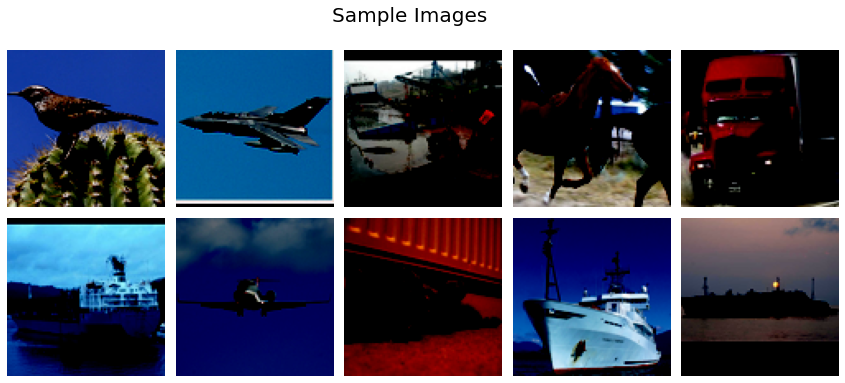

In [12]:
sample_images = X_train[100:110]
display_image_grid(sample_images, 2, 5, "Sample Images")

#### Numpy arrays conversion of dataset

In [13]:
X_train = np.array(X_train)
Y_train = np.array(Y_train)

### Step 2 | Implementing the Discriminator Network
The discriminator network distinguishes between real and fake samples using conditional probability.

**Some Important points**:
- Pass in the following arguments in your Convolutional Layers: padding='same',use_bias=False
- Concatenate the input image and label (see the comparison of Gan vs CGAN)
- After the last convolutional layer, Flatten the output and then add the final dense layer for prediction
- Use LeakyRelu and BatchNormalization after each convolution if required
- It's the 2 input and single output model

Implement the discriminator in the cell below:

In [14]:
print(X_train[0].shape) # shape of image (our input shape will hence be this)
print(Y_train) # 10 classes

(96, 96, 3)
[1 0 8 ... 9 8 8]


In [15]:
inputShape = (96, 96, 3)
nb_class = 10

In [31]:
def define_discriminator():
  # WRITE YOUR CODE HERE
  global inputShape
  global nb_class
  # first input
  input1 = Input(shape=inputShape)
  # second input
  input2 = Input(shape=(1,))
  embLayer = Embedding(nb_class, 50)(input2) # Embedding layer (input dim, output dim)
  embLayer = Dense(inputShape[0] * inputShape[1] * inputShape[2])(embLayer) # 96 * 96 * 3
  embLayer = Reshape((inputShape[0], inputShape[1], inputShape[2]))(embLayer)
  # concatenating
  conc = Concatenate()([input1, embLayer])
  # parameters for Conv2D layers
  filters = 128
  kernSize = (3, 3) 
  stride = (2, 2)
  # Conv2D layers and activation layers
  myLayer = Conv2D(filters=filters, kernel_size=kernSize, strides=stride, use_bias=False, padding='same', kernel_initializer=RandomNormal(stddev=0.02))(conc)
  myLayer = LeakyReLU(alpha=0.2)(myLayer)
  myLayer = Conv2D(filters=filters, kernel_size=kernSize, strides=stride, use_bias=False,  padding='same',kernel_initializer=RandomNormal(stddev=0.02))(myLayer)
  myLayer = LeakyReLU(alpha=0.2)(myLayer)
  myLayer = Conv2D(filters=filters, kernel_size=kernSize, strides=stride, use_bias=False,  padding='same',kernel_initializer=RandomNormal(stddev=0.02))(myLayer)
  myLayer = LeakyReLU(alpha=0.2)(myLayer)
  myLayer = Conv2D(filters=filters, kernel_size=kernSize, strides=stride, use_bias=False,  padding='same',kernel_initializer=RandomNormal(stddev=0.02))(myLayer)
  myLayer = LeakyReLU(alpha=0.2)(myLayer)
  # flattening after last Conv2D layer
  myLayer = Flatten()(myLayer)
	# myLayer = Dropout(0.4)(myLayer)
  # final dense layer for prediction
  finalLayer = Dense(1, activation='sigmoid')(myLayer)
  # 2 input, single output model
  model = Model([input1, input2], finalLayer)
  # compiling
  optimizer = Adam(lr=0.0002, beta_1=0.5)
  model.compile(loss='binary_crossentropy', optimizer=optimizer, metrics=['accuracy'])
  return model

Calling define_discriminator and compiling it

In [32]:
myDiscriminator = define_discriminator()

Summary of discriminator

In [33]:
myDiscriminator.summary()

Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_6 (InputLayer)            [(None, 1)]          0                                            
__________________________________________________________________________________________________
embedding_2 (Embedding)         (None, 1, 50)        500         input_6[0][0]                    
__________________________________________________________________________________________________
dense_4 (Dense)                 (None, 1, 27648)     1410048     embedding_2[0][0]                
__________________________________________________________________________________________________
input_5 (InputLayer)            [(None, 96, 96, 3)]  0                                            
____________________________________________________________________________________________

### Step 3 | Implementing the Generator Network
Now, we will implement the generator of the CGAN.

**Some important points:**
- All intermediate Convolutional/ Conv2DTranspose layers will have relu/ leakyrelu activation except the last one, which will have tanh.
- To improve the performance you can use kernel_initializer, Batchnormalization layer which suits you the best

Implement the generator in the cell below

In [81]:
def define_generator(latentDimension):
  # WRITE YOUR CODE HERE
  global inputShape
  global nb_class
  # first input
  input1 = Input(shape=(latentDimension,))
  input_1 = Dense(128 * 6 * 6)(input1)
  input_1 = LeakyReLU(alpha=0.2)(input_1)
  input_1 = Reshape((6, 6, 128))(input_1)
  # second input
  input2 = Input(shape=(1,))
  embLayer = Embedding(nb_class, 50)(input2) # Embedding layer (input dim, output dim)
  embLayer = Dense(6 * 6)(embLayer)
  embLayer = Reshape((6, 6, 1))(embLayer)
  # concatenating
  conc = Concatenate()([input_1, embLayer])
  # parameters for Conv2D layers
  filters = 128
  kernSize = (4, 4) 
  stride = (2, 2)
  # Conv2D layers and activation layers
  input_1 = Conv2DTranspose(filters=filters, kernel_size=kernSize, strides=stride, padding='same', kernel_initializer=RandomNormal(stddev=0.02))(conc)
  input_1 = LeakyReLU(alpha=0.2)(input_1)
  input_1 = Conv2DTranspose(filters=filters, kernel_size=kernSize, strides=stride, padding='same', kernel_initializer=RandomNormal(stddev=0.02))(input_1)
  input_1 = LeakyReLU(alpha=0.2)(input_1)
  input_1 = Conv2DTranspose(filters=filters, kernel_size=kernSize, strides=stride, padding='same', kernel_initializer=RandomNormal(stddev=0.02))(input_1)
  input_1 = LeakyReLU(alpha=0.2)(input_1)
  input_1 = Conv2DTranspose(filters=filters, kernel_size=kernSize, strides=stride, padding='same', kernel_initializer=RandomNormal(stddev=0.02))(input_1)
  input_1 = LeakyReLU(alpha=0.2)(input_1)
  # last layer with tanh activation
  finalLayer = Conv2D(filters=3, kernel_size=(7, 7), activation='tanh', padding='same', kernel_initializer=RandomNormal(stddev=0.02))(input_1)
  # 2 input, single output model
  model = Model([input1, input2], finalLayer)
  return model

Calling above function and printing summary of generator

In [36]:
myGenerator = define_generator(100)
myGenerator.summary()

Model: "model_4"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_7 (InputLayer)            [(None, 100)]        0                                            
__________________________________________________________________________________________________
input_8 (InputLayer)            [(None, 1)]          0                                            
__________________________________________________________________________________________________
dense_6 (Dense)                 (None, 4608)         465408      input_7[0][0]                    
__________________________________________________________________________________________________
embedding_3 (Embedding)         (None, 1, 50)        500         input_8[0][0]                    
____________________________________________________________________________________________

### Step 4 | CGAN Training
Next, you will implement the training loop for the CGAN. The pseudo-code is given below.

**Algorithm:**    
1. Draw m training examples {x<sup>(1)</sup>,...,x<sup>(m)</sup>} from the data distribution p<sub>data</sub>.
2. Draw m noise samples {z<sup>(1)</sup>,...,z<sup>(m)</sup>} from the noise distribution p<sub>z</sub>.    
3. Generate fake images from the noise: G(z<sup>(i)</sup>) for i in {1,....,m}.    
4. Train discriminator (D) on real/fake data conditioned on their respective one-hot labels and then update the parameters.
5. Draw m new noise samples {z<sup>(1)</sup>,...,z<sup>(m)</sup>} from the noise distribution p<sub>z</sub>.    
6. Generate fake images from the noise: G(z<sup>(i)</sup>) for i in {1,....,m}.    
7. Freeze the discriminator.
8. Compute generator's loss then update the parameters.
9. Unfreeze the discriminator.

Before we move to writing the training loop, we will need to create a "combined" model that will attach the discriminator over the generator. This model will be used to train the generator as the discriminator will act as an adversary for the generator and force it to generate realistic images.

In this function below you need to create a model that:
- Takes noise z as input
- Gets a fake image generated from the generator using this noise z
- "Freezes" the discriminator (Setting all layers of the discriminator as untrainable)
- Outputs the output of the discriminator based on the input z.
Remember to compile the model before returning it.

In [22]:
def define_gan(g_model, d_model):
  # WRITE YOUR CODE HERE
  d_model.trainable = False
  noise, label = g_model.input
  output = g_model.output
  finalOutput = d_model([output, label]) # this is output from GAN
  model = Model([noise, label], finalOutput)
  # compiling
  optimizer = Adam(lr=0.0002, beta_1=0.5)
  model.compile(loss='binary_crossentropy', optimizer=optimizer)
  return model

Creating combined model and printing summary

In [23]:
myGan = define_gan(myGenerator, myDiscriminator)
myGan.summary()

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 100)]        0                                            
__________________________________________________________________________________________________
input_4 (InputLayer)            [(None, 1)]          0                                            
__________________________________________________________________________________________________
dense_2 (Dense)                 (None, 4608)         465408      input_3[0][0]                    
__________________________________________________________________________________________________
embedding_1 (Embedding)         (None, 1, 50)        500         input_4[0][0]                    
____________________________________________________________________________________________

#### Scale Images to the Range [-1,1]
We already know that normalizing images improves training for any model. We will scale our images in the range [-1,1] since we are using a tanh activation in our generator. This will make the fake generated images and real images in the same range and will enable our discriminator to learn better.    
Implement the following function to normalize a numpy array containing images. 

**Note:** Fill it, If you haven't done that already. See if it helps in the training or not and add your comment below.

In [90]:
'''
Add your Comment

normalizing images had better affect/results
'''

'\nAdd your Comment\n\nnormalizing images had better affect/results\n'

In [24]:
def normalize(images):
    # WRITE YOUR CODE HERE
    images = (images - 127.5) / 127.5
    # END HERE
    return 

#### Use Label Smoothing
Normally, we use hard labels 1s and 0s to train our GANs. Researchers have suggested to smooth labels and use "soft" labels . This is said to have a "regularizing" effect on the training.

#### Real Label Smoothing
For Real labels, i.e. 1s, we will smooth the labels uniformly between [0.7,1.2]. Use np.random.random for this.

In [25]:
def smooth_real_labels(y):
    # WRITE YOUR CODE HERE
    for i in range(len(y)):
      y[i] = np.random.uniform(low=0.7, high=1.2)
    # END HERE
    return y

#### Fake Label Smoothing

In [26]:
def smooth_fake_labels(y):
    # WRITE YOUR CODE HERE
    for i in range(len(y)):
      y[i] = np.random.uniform(low=0.0, high=0.3)
    # END HERE
    return y

Write your training loop in the cell bellow. Some important points to keep in mind:
- You need to compile the discriminator after creating an instance using build_discriminator()
- To train your models, we won't make use of <code>fit</code> instead we will use <code>train_on_batch</code> to train our model over batches. This method will return your model's loss over a particular batch, which you will use to output and store your history of losses.
- Additionally, we will be generating samples after some epochs and storing the result on disk. You can modify according to your need.

In [27]:
# You can modify accordingly
def save_samples(generated_images,step,save_at="/"):
    sample_image = create_image_grid(generated_images)
    img = k_image.array_to_img(sample_image)
    img.save(os.path.join(BASE_DIR,save_at, 'generated_image_' + str(step) + '.png'))

#### Training the GAN


In [ ]:
# Setup Models here

# Models already defined above with the following names
# myDiscriminator, myGenerator, and myGan

In [79]:
def show_plot(examples, n):
	for i in range(n * n):
		plt.subplot(n, n, 1 + i)
		plt.axis('off')
		plt.imshow(examples[i, :, :, 0], cmap='gray_r')
	plt.show()


def generate_real_samples(dataset, n_samples):
  images, labels = dataset
  ix = randint(0, images.shape[0], n_samples)
  X, labels = images[ix], labels[ix]
  y = np.ones((n_samples, 1))
  return [X, labels], y


def generate_latent_point(latent_dim, n_samples, n_classes=10):
  x_input = randn(latent_dim * n_samples)
  z_input = x_input.reshape(n_samples, latent_dim)
  labels = randint(0, n_classes, n_samples)
  return [z_input, labels]


def generate_fake_samples(generator, latent_dim, n_samples):
  z_input, labels_input = generate_latent_point(latent_dim, n_samples)
  images = generator.predict([z_input, labels_input])
  y = np.zeros((n_samples, 1))
  return [images, labels_input], y


def plot_generated(examples, n,ep):
  for i in range(n*n):
    plt.subplot(n, n, 1 + i)
    plt.axis('off')
    plt.imshow(examples[i])
  plt.savefig('results_'+str(ep)+'.png')
  plt.show()
  

def summarize_performance(g_model,i): 
  latent_points,labels = generate_latent_point(100, 100)
  X = g_model.predict([latent_points,labels])
  X = (X + 1)/2
  plot_generated(X, 10,i)

def load_real_samples(x, y):
  return [x, y]

In [66]:
def train(g_model, d_model, gan_model, dataset, latent_dim, n_epochs=100, n_batch=128):
  bat_per_epo = int(dataset[0].shape[0] / n_batch)
  half_batch = int(n_batch / 2)

  all_disc_loss = []
  all_gen_loss = []

  for i in range(n_epochs):
    epoch_gen_loss = []
    epoch_disc_loss = []
    for j in range(bat_per_epo):
      d_model.trainable = True
      [X_real, labels_real], y_real = generate_real_samples(dataset, half_batch)
      d_loss1, _ = d_model.train_on_batch([X_real, labels_real], y_real)
      [X_fake, labels], y_fake = generate_fake_samples(g_model, latent_dim, half_batch)
      d_loss2, _ = d_model.train_on_batch([X_fake, labels], y_fake)
      [z_input, labels_input] = generate_latent_point(latent_dim, n_batch)

      disc_loss = (d_loss1 + d_loss2) / 2.0
      epoch_disc_loss.append(disc_loss)

      y_gan = np.ones((n_batch, 1))
      d_model.trainable = False
      g_loss = gan_model.train_on_batch([z_input, labels_input], y_gan)

      gen_loss = g_loss
      epoch_gen_loss.append(gen_loss)

      print('>%d, %d/%d, d1=%.3f, d2=%.3f g=%.3f' %
      (i+1, j+1, bat_per_epo, d_loss1, d_loss2, g_loss))

    avg_epoch_disc_loss = np.array(epoch_disc_loss).mean()
    avg_epoch_gen_loss = np.array(epoch_gen_loss).mean()
    all_disc_loss.append(avg_epoch_disc_loss)
    all_gen_loss.append(avg_epoch_gen_loss)

    if (i+1) % 1 == 0:
      summarize_performance(g_model,i)
    g_model.save('part1_cgan_generator.h5')
  return all_disc_loss, all_gen_loss

In [67]:
latent_dim = 100
# create the discriminator
d_model = define_discriminator()
# create the generator
g_model = define_generator(latent_dim)
# create the gan
gan_model = define_gan(g_model, d_model)
# load image data
dataset = load_real_samples(X_train, Y_train)

>1, 1/101, d1=0.698, d2=0.693 g=0.693
>1, 2/101, d1=0.684, d2=0.693 g=0.693
>1, 3/101, d1=0.665, d2=0.694 g=0.693
>1, 4/101, d1=0.633, d2=0.695 g=0.691
>1, 5/101, d1=0.556, d2=0.699 g=0.687
>1, 6/101, d1=0.411, d2=0.712 g=0.673
>1, 7/101, d1=0.224, d2=0.755 g=0.637
>1, 8/101, d1=0.090, d2=0.848 g=0.593
>1, 9/101, d1=0.049, d2=0.949 g=0.580
>1, 10/101, d1=0.049, d2=0.963 g=0.623
>1, 11/101, d1=0.078, d2=0.844 g=0.704
>1, 12/101, d1=0.096, d2=0.688 g=0.805
>1, 13/101, d1=0.110, d2=0.618 g=0.926
>1, 14/101, d1=0.122, d2=0.603 g=0.969
>1, 15/101, d1=0.100, d2=0.615 g=0.911
>1, 16/101, d1=0.110, d2=0.644 g=0.814
>1, 17/101, d1=0.142, d2=0.717 g=0.738
>1, 18/101, d1=0.103, d2=0.797 g=0.650
>1, 19/101, d1=0.107, d2=0.979 g=0.567
>1, 20/101, d1=0.135, d2=1.337 g=0.488
>1, 21/101, d1=0.117, d2=1.590 g=0.451
>1, 22/101, d1=0.159, d2=1.504 g=0.475
>1, 23/101, d1=0.301, d2=1.228 g=0.580
>1, 24/101, d1=0.496, d2=0.884 g=0.773
>1, 25/101, d1=0.613, d2=0.627 g=1.041
>1, 26/101, d1=0.701, d2=0.525 g=1

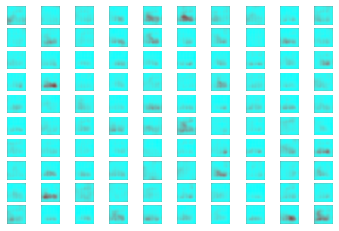

>2, 1/101, d1=0.342, d2=0.000 g=9.418
>2, 2/101, d1=0.420, d2=0.003 g=5.524
>2, 3/101, d1=0.115, d2=0.219 g=2.481
>2, 4/101, d1=0.101, d2=2.976 g=1.029
>2, 5/101, d1=0.069, d2=4.830 g=1.266
>2, 6/101, d1=0.916, d2=1.483 g=3.509
>2, 7/101, d1=2.798, d2=0.520 g=1.122
>2, 8/101, d1=0.074, d2=1.347 g=1.321
>2, 9/101, d1=0.217, d2=0.795 g=2.277
>2, 10/101, d1=0.737, d2=0.929 g=2.253
>2, 11/101, d1=0.892, d2=0.841 g=1.438
>2, 12/101, d1=1.678, d2=1.056 g=0.840
>2, 13/101, d1=1.145, d2=0.922 g=0.720
>2, 14/101, d1=1.071, d2=0.913 g=0.717
>2, 15/101, d1=0.831, d2=0.745 g=0.836
>2, 16/101, d1=0.831, d2=0.639 g=0.916
>2, 17/101, d1=0.779, d2=0.588 g=0.968
>2, 18/101, d1=0.678, d2=0.546 g=1.064
>2, 19/101, d1=0.692, d2=0.490 g=1.070
>2, 20/101, d1=0.705, d2=0.468 g=1.096
>2, 21/101, d1=0.653, d2=0.470 g=1.149
>2, 22/101, d1=0.626, d2=0.451 g=1.222
>2, 23/101, d1=0.514, d2=0.404 g=1.299
>2, 24/101, d1=0.532, d2=0.387 g=1.338
>2, 25/101, d1=0.562, d2=0.402 g=1.378
>2, 26/101, d1=0.515, d2=0.433 g=1

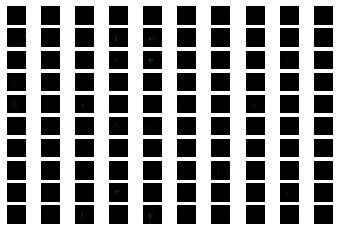

>3, 1/101, d1=1.071, d2=0.151 g=2.302
>3, 2/101, d1=0.900, d2=0.166 g=2.281
>3, 3/101, d1=0.760, d2=0.162 g=2.332
>3, 4/101, d1=0.878, d2=0.156 g=2.341
>3, 5/101, d1=0.870, d2=0.166 g=2.273
>3, 6/101, d1=0.808, d2=0.168 g=2.277
>3, 7/101, d1=0.782, d2=0.151 g=2.376
>3, 8/101, d1=0.837, d2=0.154 g=2.319
>3, 9/101, d1=0.770, d2=0.162 g=2.337
>3, 10/101, d1=0.740, d2=0.142 g=2.445
>3, 11/101, d1=0.740, d2=0.137 g=2.445
>3, 12/101, d1=0.657, d2=0.134 g=2.543
>3, 13/101, d1=0.707, d2=0.126 g=2.520
>3, 14/101, d1=0.638, d2=0.136 g=2.494
>3, 15/101, d1=0.684, d2=0.129 g=2.552
>3, 16/101, d1=0.691, d2=0.141 g=2.440
>3, 17/101, d1=0.607, d2=0.135 g=2.566
>3, 18/101, d1=0.563, d2=0.118 g=2.669
>3, 19/101, d1=0.633, d2=0.113 g=2.628
>3, 20/101, d1=0.697, d2=0.138 g=2.507
>3, 21/101, d1=0.401, d2=0.109 g=2.756
>3, 22/101, d1=0.522, d2=0.113 g=2.792
>3, 23/101, d1=0.325, d2=0.078 g=3.033
>3, 24/101, d1=0.653, d2=0.093 g=2.822
>3, 25/101, d1=0.462, d2=0.100 g=2.819
>3, 26/101, d1=0.472, d2=0.117 g=2

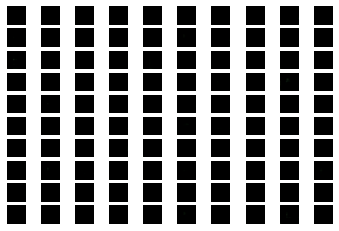

>4, 1/101, d1=0.036, d2=0.011 g=4.899
>4, 2/101, d1=0.050, d2=0.024 g=4.881
>4, 3/101, d1=0.050, d2=0.013 g=4.846
>4, 4/101, d1=0.037, d2=0.017 g=4.813
>4, 5/101, d1=0.057, d2=0.022 g=4.774
>4, 6/101, d1=0.010, d2=0.008 g=5.200
>4, 7/101, d1=0.028, d2=0.008 g=4.947
>4, 8/101, d1=0.006, d2=0.008 g=5.167
>4, 9/101, d1=0.032, d2=0.012 g=4.842
>4, 10/101, d1=0.016, d2=0.011 g=5.058
>4, 11/101, d1=0.008, d2=0.007 g=5.374
>4, 12/101, d1=0.106, d2=0.016 g=4.690
>4, 13/101, d1=0.014, d2=0.012 g=5.054
>4, 14/101, d1=0.015, d2=0.007 g=5.197
>4, 15/101, d1=0.008, d2=0.006 g=5.351
>4, 16/101, d1=0.019, d2=0.007 g=5.216
>4, 17/101, d1=0.012, d2=0.008 g=5.241
>4, 18/101, d1=0.013, d2=0.007 g=5.342
>4, 19/101, d1=0.005, d2=0.005 g=5.553
>4, 20/101, d1=0.064, d2=0.027 g=5.247
>4, 21/101, d1=0.020, d2=0.005 g=5.555
>4, 22/101, d1=0.029, d2=0.006 g=5.105
>4, 23/101, d1=0.003, d2=0.007 g=5.400
>4, 24/101, d1=0.012, d2=0.006 g=5.354
>4, 25/101, d1=0.007, d2=0.005 g=5.524
>4, 26/101, d1=0.026, d2=0.007 g=5

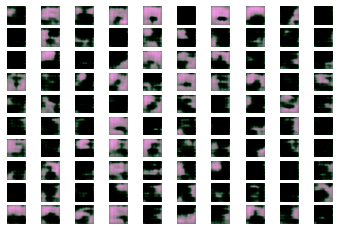

>5, 1/101, d1=0.223, d2=0.368 g=3.434
>5, 2/101, d1=0.191, d2=0.257 g=3.424
>5, 3/101, d1=0.403, d2=0.418 g=3.239
>5, 4/101, d1=0.314, d2=0.541 g=2.601
>5, 5/101, d1=0.420, d2=0.912 g=1.726
>5, 6/101, d1=0.501, d2=1.729 g=0.697
>5, 7/101, d1=0.719, d2=0.531 g=1.728
>5, 8/101, d1=0.509, d2=0.389 g=1.933
>5, 9/101, d1=0.390, d2=0.591 g=1.410
>5, 10/101, d1=0.293, d2=0.867 g=1.154
>5, 11/101, d1=0.520, d2=0.569 g=1.407
>5, 12/101, d1=0.658, d2=0.405 g=1.685
>5, 13/101, d1=0.505, d2=0.374 g=1.814
>5, 14/101, d1=0.543, d2=0.399 g=1.576
>5, 15/101, d1=0.439, d2=0.520 g=1.560
>5, 16/101, d1=0.548, d2=0.523 g=1.628
>5, 17/101, d1=0.652, d2=0.569 g=1.687
>5, 18/101, d1=0.585, d2=0.448 g=1.797
>5, 19/101, d1=0.786, d2=0.528 g=1.711
>5, 20/101, d1=0.749, d2=0.514 g=1.529
>5, 21/101, d1=0.559, d2=0.436 g=1.763
>5, 22/101, d1=0.654, d2=0.530 g=1.806
>5, 23/101, d1=0.593, d2=0.742 g=1.681
>5, 24/101, d1=0.700, d2=0.681 g=1.581
>5, 25/101, d1=0.592, d2=0.917 g=1.850
>5, 26/101, d1=0.532, d2=0.468 g=1

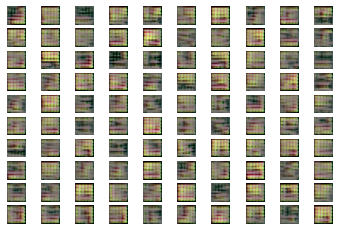

>6, 1/101, d1=0.556, d2=0.806 g=1.232
>6, 2/101, d1=0.662, d2=0.630 g=1.345
>6, 3/101, d1=0.720, d2=0.551 g=1.506
>6, 4/101, d1=0.756, d2=0.595 g=1.394
>6, 5/101, d1=0.626, d2=0.612 g=1.613
>6, 6/101, d1=0.797, d2=0.548 g=1.551
>6, 7/101, d1=0.762, d2=0.588 g=1.570
>6, 8/101, d1=0.763, d2=0.527 g=1.576
>6, 9/101, d1=0.641, d2=0.514 g=1.773
>6, 10/101, d1=0.796, d2=0.504 g=1.822
>6, 11/101, d1=0.811, d2=0.488 g=1.651
>6, 12/101, d1=0.855, d2=0.533 g=1.606
>6, 13/101, d1=0.687, d2=0.456 g=1.776
>6, 14/101, d1=0.823, d2=0.446 g=1.541
>6, 15/101, d1=0.696, d2=0.548 g=1.611
>6, 16/101, d1=0.562, d2=0.459 g=1.702
>6, 17/101, d1=0.604, d2=0.422 g=1.645
>6, 18/101, d1=0.586, d2=0.446 g=1.854
>6, 19/101, d1=0.780, d2=0.480 g=1.733
>6, 20/101, d1=0.767, d2=0.532 g=1.628
>6, 21/101, d1=0.668, d2=0.538 g=1.759
>6, 22/101, d1=0.719, d2=0.496 g=1.546
>6, 23/101, d1=0.685, d2=0.585 g=1.468
>6, 24/101, d1=0.662, d2=0.570 g=1.439
>6, 25/101, d1=0.707, d2=0.626 g=1.288
>6, 26/101, d1=0.543, d2=0.583 g=1

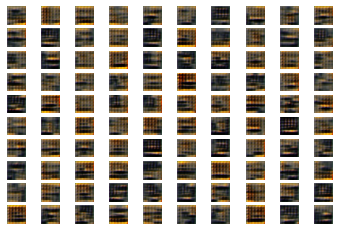

>7, 1/101, d1=0.645, d2=0.444 g=1.492
>7, 2/101, d1=0.606, d2=0.388 g=1.632
>7, 3/101, d1=0.536, d2=0.348 g=1.624
>7, 4/101, d1=0.512, d2=0.409 g=1.459
>7, 5/101, d1=0.490, d2=0.457 g=1.543
>7, 6/101, d1=0.505, d2=0.427 g=1.561
>7, 7/101, d1=0.533, d2=0.372 g=1.560
>7, 8/101, d1=0.500, d2=0.430 g=1.733
>7, 9/101, d1=0.543, d2=0.396 g=1.552
>7, 10/101, d1=0.474, d2=0.579 g=1.282
>7, 11/101, d1=0.498, d2=0.809 g=1.055
>7, 12/101, d1=0.632, d2=0.912 g=0.911
>7, 13/101, d1=0.589, d2=0.913 g=1.055
>7, 14/101, d1=0.799, d2=0.648 g=1.032
>7, 15/101, d1=0.754, d2=0.617 g=1.087
>7, 16/101, d1=0.590, d2=0.616 g=1.180
>7, 17/101, d1=0.644, d2=0.543 g=1.206
>7, 18/101, d1=0.538, d2=0.563 g=1.247
>7, 19/101, d1=0.544, d2=0.437 g=1.140
>7, 20/101, d1=0.662, d2=0.529 g=1.148
>7, 21/101, d1=0.504, d2=0.581 g=1.133
>7, 22/101, d1=0.438, d2=0.580 g=1.131
>7, 23/101, d1=0.489, d2=0.599 g=1.013
>7, 24/101, d1=0.541, d2=0.721 g=0.967
>7, 25/101, d1=0.572, d2=0.731 g=0.948
>7, 26/101, d1=0.669, d2=0.841 g=0

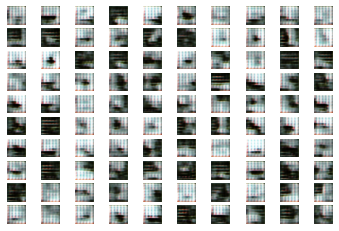

>8, 1/101, d1=0.662, d2=0.539 g=1.133
>8, 2/101, d1=0.572, d2=0.582 g=1.021
>8, 3/101, d1=0.532, d2=0.546 g=1.010
>8, 4/101, d1=0.520, d2=0.601 g=0.981
>8, 5/101, d1=0.547, d2=0.633 g=0.986
>8, 6/101, d1=0.543, d2=0.621 g=0.931
>8, 7/101, d1=0.610, d2=0.635 g=0.922
>8, 8/101, d1=0.561, d2=0.611 g=0.914
>8, 9/101, d1=0.544, d2=0.577 g=0.945
>8, 10/101, d1=0.577, d2=0.616 g=0.941
>8, 11/101, d1=0.589, d2=0.570 g=0.973
>8, 12/101, d1=0.495, d2=0.579 g=1.001
>8, 13/101, d1=0.505, d2=0.530 g=1.029
>8, 14/101, d1=0.519, d2=0.528 g=1.082
>8, 15/101, d1=0.497, d2=0.494 g=1.153
>8, 16/101, d1=0.586, d2=0.471 g=1.134
>8, 17/101, d1=0.537, d2=0.528 g=1.099
>8, 18/101, d1=0.372, d2=0.536 g=1.079
>8, 19/101, d1=0.458, d2=0.649 g=1.086
>8, 20/101, d1=0.451, d2=0.627 g=1.092
>8, 21/101, d1=0.500, d2=0.667 g=0.952
>8, 22/101, d1=0.523, d2=0.788 g=0.996
>8, 23/101, d1=0.648, d2=0.782 g=1.077
>8, 24/101, d1=0.653, d2=0.726 g=1.006
>8, 25/101, d1=0.691, d2=0.717 g=1.168
>8, 26/101, d1=0.837, d2=0.624 g=1

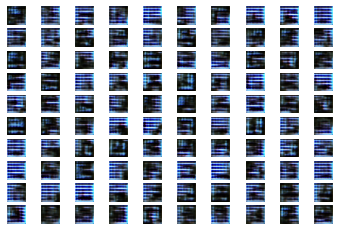

>9, 1/101, d1=0.733, d2=0.327 g=1.542
>9, 2/101, d1=0.704, d2=0.315 g=1.522
>9, 3/101, d1=0.642, d2=0.381 g=1.357
>9, 4/101, d1=0.575, d2=0.450 g=1.226
>9, 5/101, d1=0.594, d2=0.486 g=1.160
>9, 6/101, d1=0.550, d2=0.514 g=1.152
>9, 7/101, d1=0.602, d2=0.548 g=1.142
>9, 8/101, d1=0.580, d2=0.540 g=1.122
>9, 9/101, d1=0.564, d2=0.564 g=1.137
>9, 10/101, d1=0.648, d2=0.538 g=1.050
>9, 11/101, d1=0.587, d2=0.562 g=1.030
>9, 12/101, d1=0.629, d2=0.567 g=1.059
>9, 13/101, d1=0.625, d2=0.609 g=1.064
>9, 14/101, d1=0.613, d2=0.600 g=1.083
>9, 15/101, d1=0.669, d2=0.582 g=1.166
>9, 16/101, d1=0.663, d2=0.541 g=1.323
>9, 17/101, d1=0.706, d2=0.423 g=1.477
>9, 18/101, d1=0.679, d2=0.433 g=1.506
>9, 19/101, d1=0.657, d2=0.422 g=1.455
>9, 20/101, d1=0.650, d2=0.413 g=1.358
>9, 21/101, d1=0.569, d2=0.449 g=1.314
>9, 22/101, d1=0.620, d2=0.468 g=1.275
>9, 23/101, d1=0.600, d2=0.539 g=1.139
>9, 24/101, d1=0.555, d2=0.540 g=1.131
>9, 25/101, d1=0.567, d2=0.514 g=1.061
>9, 26/101, d1=0.567, d2=0.597 g=1

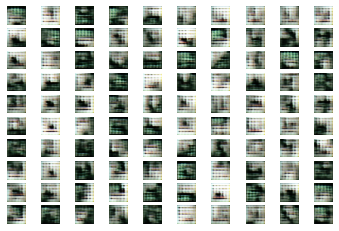

>10, 1/101, d1=0.742, d2=0.639 g=1.190
>10, 2/101, d1=0.618, d2=0.707 g=1.163
>10, 3/101, d1=0.786, d2=0.675 g=1.084
>10, 4/101, d1=0.883, d2=0.644 g=1.099
>10, 5/101, d1=0.690, d2=0.613 g=0.988
>10, 6/101, d1=0.921, d2=0.736 g=0.861
>10, 7/101, d1=0.734, d2=0.759 g=0.801
>10, 8/101, d1=0.647, d2=0.790 g=0.823
>10, 9/101, d1=0.676, d2=0.685 g=0.899
>10, 10/101, d1=0.579, d2=0.607 g=0.985
>10, 11/101, d1=0.649, d2=0.561 g=1.054
>10, 12/101, d1=0.569, d2=0.549 g=1.141
>10, 13/101, d1=0.503, d2=0.494 g=1.134
>10, 14/101, d1=0.483, d2=0.580 g=1.096
>10, 15/101, d1=0.513, d2=0.599 g=1.002
>10, 16/101, d1=0.507, d2=0.688 g=0.929
>10, 17/101, d1=0.515, d2=0.792 g=0.883
>10, 18/101, d1=0.380, d2=0.711 g=1.027
>10, 19/101, d1=0.568, d2=0.545 g=1.273
>10, 20/101, d1=0.592, d2=0.493 g=1.325
>10, 21/101, d1=0.514, d2=0.433 g=1.413
>10, 22/101, d1=0.566, d2=0.461 g=1.280
>10, 23/101, d1=0.530, d2=0.590 g=1.158
>10, 24/101, d1=0.547, d2=0.565 g=1.181
>10, 25/101, d1=0.535, d2=0.631 g=1.186
>10, 26/1

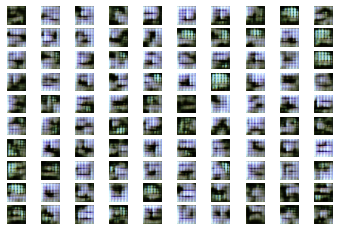

>11, 1/101, d1=0.624, d2=0.499 g=1.206
>11, 2/101, d1=0.730, d2=0.481 g=1.179
>11, 3/101, d1=0.594, d2=0.552 g=1.215
>11, 4/101, d1=0.648, d2=0.495 g=1.200
>11, 5/101, d1=0.657, d2=0.525 g=1.159
>11, 6/101, d1=0.620, d2=0.542 g=1.164
>11, 7/101, d1=0.654, d2=0.544 g=1.298
>11, 8/101, d1=0.654, d2=0.574 g=1.202
>11, 9/101, d1=0.776, d2=0.615 g=0.988
>11, 10/101, d1=0.696, d2=0.684 g=1.056
>11, 11/101, d1=0.656, d2=0.647 g=1.076
>11, 12/101, d1=0.708, d2=0.544 g=1.191
>11, 13/101, d1=0.672, d2=0.478 g=1.228
>11, 14/101, d1=0.620, d2=0.496 g=1.279
>11, 15/101, d1=0.684, d2=0.502 g=1.244
>11, 16/101, d1=0.637, d2=0.550 g=1.149
>11, 17/101, d1=0.649, d2=0.593 g=1.062
>11, 18/101, d1=0.739, d2=0.634 g=0.950
>11, 19/101, d1=0.647, d2=0.676 g=0.913
>11, 20/101, d1=0.659, d2=0.708 g=0.914
>11, 21/101, d1=0.645, d2=0.661 g=1.007
>11, 22/101, d1=0.648, d2=0.704 g=0.958
>11, 23/101, d1=0.628, d2=0.669 g=0.874
>11, 24/101, d1=0.688, d2=0.693 g=0.952
>11, 25/101, d1=0.659, d2=0.643 g=0.979
>11, 26/1

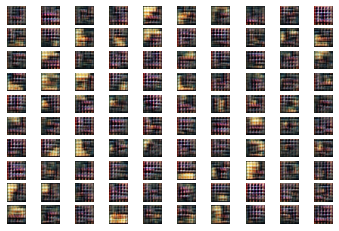

>12, 1/101, d1=0.649, d2=0.455 g=1.490
>12, 2/101, d1=0.766, d2=0.539 g=1.316
>12, 3/101, d1=0.727, d2=0.618 g=1.142
>12, 4/101, d1=0.601, d2=0.612 g=1.070
>12, 5/101, d1=0.555, d2=0.635 g=1.013
>12, 6/101, d1=0.643, d2=0.620 g=0.921
>12, 7/101, d1=0.544, d2=0.602 g=0.946
>12, 8/101, d1=0.519, d2=0.666 g=0.931
>12, 9/101, d1=0.558, d2=0.626 g=1.102
>12, 10/101, d1=0.458, d2=0.537 g=1.311
>12, 11/101, d1=0.509, d2=0.490 g=1.272
>12, 12/101, d1=0.519, d2=0.571 g=1.181
>12, 13/101, d1=0.512, d2=0.684 g=1.044
>12, 14/101, d1=0.524, d2=0.925 g=0.923
>12, 15/101, d1=0.551, d2=0.884 g=1.051
>12, 16/101, d1=0.705, d2=0.649 g=1.158
>12, 17/101, d1=0.701, d2=0.504 g=1.335
>12, 18/101, d1=0.654, d2=0.441 g=1.466
>12, 19/101, d1=0.745, d2=0.374 g=1.381
>12, 20/101, d1=0.742, d2=0.401 g=1.366
>12, 21/101, d1=0.600, d2=0.441 g=1.269
>12, 22/101, d1=0.654, d2=0.586 g=1.088
>12, 23/101, d1=0.559, d2=0.545 g=1.006
>12, 24/101, d1=0.592, d2=0.719 g=0.879
>12, 25/101, d1=0.585, d2=0.794 g=0.863
>12, 26/1

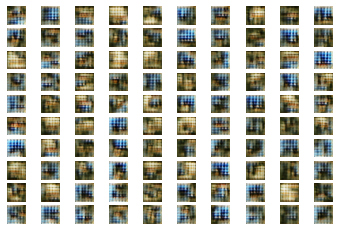

>13, 1/101, d1=0.698, d2=0.622 g=1.126
>13, 2/101, d1=0.720, d2=0.604 g=1.116
>13, 3/101, d1=0.758, d2=0.587 g=1.232
>13, 4/101, d1=0.703, d2=0.499 g=1.355
>13, 5/101, d1=0.632, d2=0.486 g=1.440
>13, 6/101, d1=0.608, d2=0.412 g=1.390
>13, 7/101, d1=0.578, d2=0.579 g=1.257
>13, 8/101, d1=0.529, d2=0.672 g=0.980
>13, 9/101, d1=0.528, d2=0.673 g=0.884
>13, 10/101, d1=0.614, d2=0.779 g=0.852
>13, 11/101, d1=0.626, d2=0.744 g=0.885
>13, 12/101, d1=0.637, d2=0.706 g=0.934
>13, 13/101, d1=0.656, d2=0.659 g=0.971
>13, 14/101, d1=0.633, d2=0.592 g=1.052
>13, 15/101, d1=0.619, d2=0.538 g=1.073
>13, 16/101, d1=0.676, d2=0.544 g=1.081
>13, 17/101, d1=0.610, d2=0.564 g=1.031
>13, 18/101, d1=0.599, d2=0.532 g=1.057
>13, 19/101, d1=0.588, d2=0.536 g=1.051
>13, 20/101, d1=0.575, d2=0.573 g=0.998
>13, 21/101, d1=0.623, d2=0.566 g=1.032
>13, 22/101, d1=0.615, d2=0.576 g=1.011
>13, 23/101, d1=0.574, d2=0.597 g=1.007
>13, 24/101, d1=0.572, d2=0.551 g=1.046
>13, 25/101, d1=0.554, d2=0.592 g=1.048
>13, 26/1

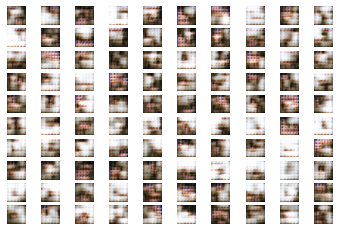

>14, 1/101, d1=0.489, d2=0.391 g=1.880
>14, 2/101, d1=0.475, d2=0.416 g=1.922
>14, 3/101, d1=0.499, d2=0.348 g=1.817
>14, 4/101, d1=0.566, d2=0.615 g=1.468
>14, 5/101, d1=0.539, d2=0.580 g=1.363
>14, 6/101, d1=0.635, d2=0.782 g=1.083
>14, 7/101, d1=0.666, d2=0.729 g=1.069
>14, 8/101, d1=0.804, d2=0.747 g=1.150
>14, 9/101, d1=0.651, d2=0.765 g=1.315
>14, 10/101, d1=0.747, d2=0.509 g=1.395
>14, 11/101, d1=0.773, d2=0.430 g=1.406
>14, 12/101, d1=0.676, d2=0.456 g=1.358
>14, 13/101, d1=0.677, d2=0.489 g=1.203
>14, 14/101, d1=0.598, d2=0.515 g=1.237
>14, 15/101, d1=0.619, d2=0.532 g=1.146
>14, 16/101, d1=0.673, d2=0.554 g=1.112
>14, 17/101, d1=0.612, d2=0.647 g=1.161
>14, 18/101, d1=0.585, d2=0.556 g=1.204
>14, 19/101, d1=0.729, d2=0.569 g=1.122
>14, 20/101, d1=0.657, d2=0.720 g=1.059
>14, 21/101, d1=0.584, d2=0.646 g=1.096
>14, 22/101, d1=0.757, d2=0.626 g=1.133
>14, 23/101, d1=0.648, d2=0.613 g=1.065
>14, 24/101, d1=0.672, d2=0.559 g=1.123
>14, 25/101, d1=0.668, d2=0.588 g=1.126
>14, 26/1

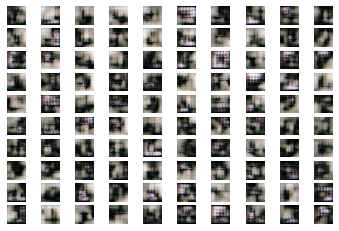

>15, 1/101, d1=0.610, d2=0.606 g=0.953
>15, 2/101, d1=0.697, d2=0.702 g=0.942
>15, 3/101, d1=0.684, d2=0.722 g=0.908
>15, 4/101, d1=0.644, d2=0.669 g=0.929
>15, 5/101, d1=0.722, d2=0.704 g=1.008
>15, 6/101, d1=0.754, d2=0.586 g=1.039
>15, 7/101, d1=0.752, d2=0.535 g=1.103
>15, 8/101, d1=0.748, d2=0.522 g=1.187
>15, 9/101, d1=0.699, d2=0.485 g=1.265
>15, 10/101, d1=0.715, d2=0.459 g=1.257
>15, 11/101, d1=0.656, d2=0.478 g=1.218
>15, 12/101, d1=0.641, d2=0.495 g=1.182
>15, 13/101, d1=0.624, d2=0.453 g=1.195
>15, 14/101, d1=0.613, d2=0.485 g=1.193
>15, 15/101, d1=0.616, d2=0.456 g=1.244
>15, 16/101, d1=0.640, d2=0.470 g=1.226
>15, 17/101, d1=0.602, d2=0.538 g=1.232
>15, 18/101, d1=0.669, d2=0.474 g=1.355
>15, 19/101, d1=0.498, d2=0.485 g=1.381
>15, 20/101, d1=0.748, d2=0.508 g=1.070
>15, 21/101, d1=0.631, d2=0.599 g=1.016
>15, 22/101, d1=0.670, d2=0.559 g=1.028
>15, 23/101, d1=0.632, d2=0.662 g=0.959
>15, 24/101, d1=0.569, d2=0.719 g=0.946
>15, 25/101, d1=0.594, d2=0.650 g=0.972
>15, 26/1

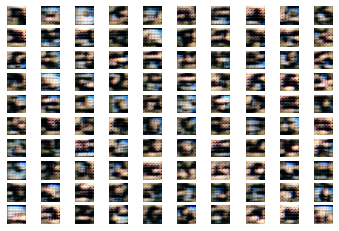

>16, 1/101, d1=0.709, d2=0.566 g=1.234
>16, 2/101, d1=0.767, d2=0.523 g=1.363
>16, 3/101, d1=0.655, d2=0.468 g=1.324
>16, 4/101, d1=0.664, d2=0.494 g=1.377
>16, 5/101, d1=0.768, d2=0.555 g=1.130
>16, 6/101, d1=0.728, d2=0.688 g=0.951
>16, 7/101, d1=0.639, d2=0.702 g=1.064
>16, 8/101, d1=0.674, d2=0.553 g=1.157
>16, 9/101, d1=0.667, d2=0.555 g=1.182
>16, 10/101, d1=0.733, d2=0.539 g=1.103
>16, 11/101, d1=0.669, d2=0.607 g=1.001
>16, 12/101, d1=0.597, d2=0.591 g=0.948
>16, 13/101, d1=0.562, d2=0.595 g=0.948
>16, 14/101, d1=0.575, d2=0.622 g=0.947
>16, 15/101, d1=0.592, d2=0.607 g=0.943
>16, 16/101, d1=0.586, d2=0.603 g=0.959
>16, 17/101, d1=0.565, d2=0.609 g=0.986
>16, 18/101, d1=0.582, d2=0.567 g=1.020
>16, 19/101, d1=0.577, d2=0.556 g=0.976
>16, 20/101, d1=0.514, d2=0.594 g=1.035
>16, 21/101, d1=0.526, d2=0.562 g=1.054
>16, 22/101, d1=0.520, d2=0.493 g=1.074
>16, 23/101, d1=0.531, d2=0.518 g=1.027
>16, 24/101, d1=0.598, d2=0.550 g=1.085
>16, 25/101, d1=0.514, d2=0.551 g=1.076
>16, 26/1

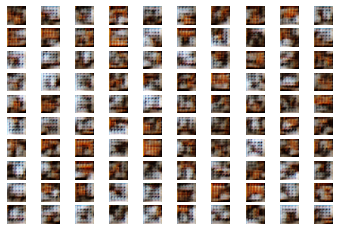

>17, 1/101, d1=0.483, d2=0.509 g=1.275
>17, 2/101, d1=0.513, d2=0.554 g=1.352
>17, 3/101, d1=0.503, d2=0.583 g=1.388
>17, 4/101, d1=0.564, d2=0.645 g=1.214
>17, 5/101, d1=0.496, d2=0.517 g=1.318
>17, 6/101, d1=0.615, d2=0.467 g=1.346
>17, 7/101, d1=0.706, d2=0.528 g=1.233
>17, 8/101, d1=0.508, d2=0.505 g=1.244
>17, 9/101, d1=0.491, d2=0.440 g=1.280
>17, 10/101, d1=0.505, d2=0.621 g=1.130
>17, 11/101, d1=0.449, d2=0.701 g=1.036
>17, 12/101, d1=0.581, d2=0.815 g=1.005
>17, 13/101, d1=0.550, d2=0.739 g=1.132
>17, 14/101, d1=0.663, d2=0.727 g=1.354
>17, 15/101, d1=0.714, d2=0.566 g=1.401
>17, 16/101, d1=0.670, d2=0.528 g=1.364
>17, 17/101, d1=0.618, d2=0.510 g=1.368
>17, 18/101, d1=0.505, d2=0.538 g=1.459
>17, 19/101, d1=0.473, d2=0.915 g=1.397
>17, 20/101, d1=0.640, d2=0.946 g=1.299
>17, 21/101, d1=0.762, d2=0.778 g=1.166
>17, 22/101, d1=0.738, d2=0.679 g=1.242
>17, 23/101, d1=0.716, d2=0.632 g=1.251
>17, 24/101, d1=0.728, d2=0.615 g=1.164
>17, 25/101, d1=0.560, d2=0.606 g=1.070
>17, 26/1

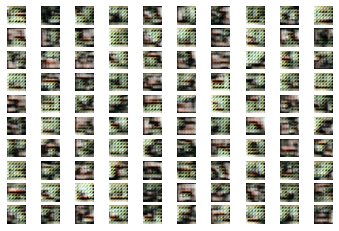

>18, 1/101, d1=0.560, d2=0.484 g=1.397
>18, 2/101, d1=0.518, d2=0.511 g=1.339
>18, 3/101, d1=0.650, d2=0.471 g=1.273
>18, 4/101, d1=0.624, d2=0.577 g=1.149
>18, 5/101, d1=0.523, d2=0.621 g=1.278
>18, 6/101, d1=0.529, d2=0.557 g=1.490
>18, 7/101, d1=0.558, d2=0.394 g=1.497
>18, 8/101, d1=0.536, d2=0.435 g=1.363
>18, 9/101, d1=0.587, d2=0.556 g=1.266
>18, 10/101, d1=0.580, d2=0.531 g=1.285
>18, 11/101, d1=0.642, d2=0.546 g=1.184
>18, 12/101, d1=0.502, d2=0.566 g=1.275
>18, 13/101, d1=0.501, d2=0.548 g=1.301
>18, 14/101, d1=0.598, d2=0.584 g=1.124
>18, 15/101, d1=0.590, d2=0.674 g=1.065
>18, 16/101, d1=0.505, d2=0.684 g=1.064
>18, 17/101, d1=0.516, d2=0.667 g=1.022
>18, 18/101, d1=0.445, d2=0.623 g=1.121
>18, 19/101, d1=0.541, d2=0.596 g=1.028
>18, 20/101, d1=0.449, d2=0.589 g=0.988
>18, 21/101, d1=0.420, d2=0.719 g=1.022
>18, 22/101, d1=0.522, d2=0.594 g=1.102
>18, 23/101, d1=0.459, d2=0.615 g=1.097
>18, 24/101, d1=0.564, d2=0.582 g=1.043
>18, 25/101, d1=0.381, d2=0.587 g=1.120
>18, 26/1

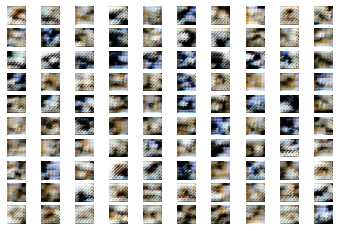

>19, 1/101, d1=0.588, d2=0.596 g=1.092
>19, 2/101, d1=0.504, d2=0.668 g=0.881
>19, 3/101, d1=0.502, d2=0.731 g=0.931
>19, 4/101, d1=0.571, d2=0.600 g=1.114
>19, 5/101, d1=0.674, d2=0.493 g=1.218
>19, 6/101, d1=0.722, d2=0.551 g=1.259
>19, 7/101, d1=0.713, d2=0.537 g=1.268
>19, 8/101, d1=0.638, d2=0.582 g=1.160
>19, 9/101, d1=0.568, d2=0.501 g=1.253
>19, 10/101, d1=0.618, d2=0.531 g=1.160
>19, 11/101, d1=0.630, d2=0.550 g=1.226
>19, 12/101, d1=0.636, d2=0.668 g=1.187
>19, 13/101, d1=0.550, d2=0.621 g=1.093
>19, 14/101, d1=0.505, d2=0.632 g=1.008
>19, 15/101, d1=0.545, d2=0.581 g=1.197
>19, 16/101, d1=0.630, d2=0.475 g=1.244
>19, 17/101, d1=0.719, d2=0.564 g=1.126
>19, 18/101, d1=0.579, d2=0.556 g=1.033
>19, 19/101, d1=0.655, d2=0.595 g=1.048
>19, 20/101, d1=0.566, d2=0.649 g=0.986
>19, 21/101, d1=0.565, d2=0.562 g=1.053
>19, 22/101, d1=0.552, d2=0.568 g=1.138
>19, 23/101, d1=0.666, d2=0.556 g=1.104
>19, 24/101, d1=0.632, d2=0.628 g=1.122
>19, 25/101, d1=0.613, d2=0.566 g=1.107
>19, 26/1

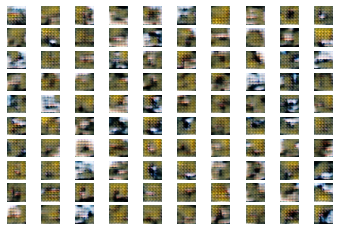

>20, 1/101, d1=0.594, d2=0.541 g=1.257
>20, 2/101, d1=0.585, d2=0.525 g=1.243
>20, 3/101, d1=0.541, d2=0.511 g=1.270
>20, 4/101, d1=0.566, d2=0.509 g=1.199
>20, 5/101, d1=0.530, d2=0.553 g=1.058
>20, 6/101, d1=0.630, d2=0.660 g=1.055
>20, 7/101, d1=0.591, d2=0.546 g=1.117
>20, 8/101, d1=0.507, d2=0.562 g=1.197
>20, 9/101, d1=0.584, d2=0.639 g=1.133
>20, 10/101, d1=0.535, d2=0.541 g=1.140
>20, 11/101, d1=0.540, d2=0.605 g=1.096
>20, 12/101, d1=0.528, d2=0.664 g=1.128
>20, 13/101, d1=0.653, d2=0.662 g=1.082
>20, 14/101, d1=0.596, d2=0.573 g=1.178
>20, 15/101, d1=0.675, d2=0.520 g=1.344
>20, 16/101, d1=0.547, d2=0.557 g=1.286
>20, 17/101, d1=0.690, d2=0.499 g=1.262
>20, 18/101, d1=0.572, d2=0.518 g=1.210
>20, 19/101, d1=0.674, d2=0.620 g=1.101
>20, 20/101, d1=0.596, d2=0.608 g=1.108
>20, 21/101, d1=0.553, d2=0.649 g=1.109
>20, 22/101, d1=0.562, d2=0.596 g=0.977
>20, 23/101, d1=0.457, d2=0.623 g=1.010
>20, 24/101, d1=0.459, d2=0.593 g=1.020
>20, 25/101, d1=0.474, d2=0.596 g=0.988
>20, 26/1

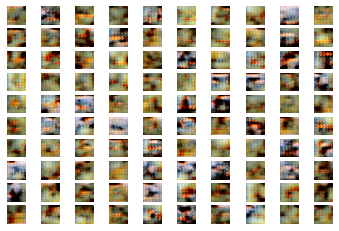

>21, 1/101, d1=0.672, d2=0.437 g=1.508
>21, 2/101, d1=0.650, d2=0.474 g=1.382
>21, 3/101, d1=0.636, d2=0.632 g=1.121
>21, 4/101, d1=0.584, d2=0.624 g=1.109
>21, 5/101, d1=0.591, d2=0.543 g=1.196
>21, 6/101, d1=0.554, d2=0.518 g=1.320
>21, 7/101, d1=0.588, d2=0.527 g=1.225
>21, 8/101, d1=0.668, d2=0.616 g=1.153
>21, 9/101, d1=0.582, d2=0.614 g=1.268
>21, 10/101, d1=0.557, d2=0.513 g=1.283
>21, 11/101, d1=0.491, d2=0.476 g=1.235
>21, 12/101, d1=0.659, d2=0.517 g=1.058
>21, 13/101, d1=0.495, d2=0.592 g=1.067
>21, 14/101, d1=0.599, d2=0.643 g=1.002
>21, 15/101, d1=0.533, d2=0.691 g=1.079
>21, 16/101, d1=0.568, d2=0.622 g=1.171
>21, 17/101, d1=0.640, d2=0.562 g=1.249
>21, 18/101, d1=0.542, d2=0.479 g=1.382
>21, 19/101, d1=0.605, d2=0.453 g=1.367
>21, 20/101, d1=0.545, d2=0.456 g=1.348
>21, 21/101, d1=0.544, d2=0.508 g=1.253
>21, 22/101, d1=0.531, d2=0.556 g=1.245
>21, 23/101, d1=0.512, d2=0.564 g=1.204
>21, 24/101, d1=0.682, d2=0.637 g=1.157
>21, 25/101, d1=0.638, d2=0.588 g=1.097
>21, 26/1

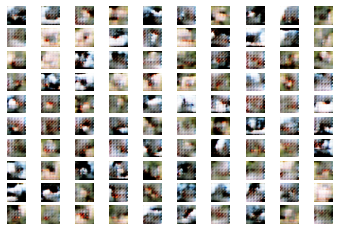

>22, 1/101, d1=0.581, d2=0.554 g=1.208
>22, 2/101, d1=0.610, d2=0.617 g=1.100
>22, 3/101, d1=0.567, d2=0.647 g=1.102
>22, 4/101, d1=0.680, d2=0.575 g=1.158
>22, 5/101, d1=0.590, d2=0.585 g=1.226
>22, 6/101, d1=0.556, d2=0.609 g=1.284
>22, 7/101, d1=0.633, d2=0.543 g=1.243
>22, 8/101, d1=0.560, d2=0.532 g=1.274
>22, 9/101, d1=0.698, d2=0.583 g=1.153
>22, 10/101, d1=0.652, d2=0.663 g=1.098
>22, 11/101, d1=0.679, d2=0.588 g=1.134
>22, 12/101, d1=0.621, d2=0.606 g=1.209
>22, 13/101, d1=0.663, d2=0.549 g=1.227
>22, 14/101, d1=0.604, d2=0.573 g=1.169
>22, 15/101, d1=0.702, d2=0.576 g=1.205
>22, 16/101, d1=0.615, d2=0.535 g=1.213
>22, 17/101, d1=0.704, d2=0.522 g=1.195
>22, 18/101, d1=0.617, d2=0.520 g=1.165
>22, 19/101, d1=0.565, d2=0.597 g=1.168
>22, 20/101, d1=0.578, d2=0.583 g=1.157
>22, 21/101, d1=0.655, d2=0.563 g=1.098
>22, 22/101, d1=0.570, d2=0.570 g=1.128
>22, 23/101, d1=0.570, d2=0.593 g=1.055
>22, 24/101, d1=0.488, d2=0.597 g=1.133
>22, 25/101, d1=0.568, d2=0.573 g=1.227
>22, 26/1

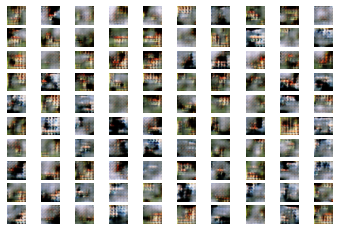

>23, 1/101, d1=0.535, d2=0.588 g=1.091
>23, 2/101, d1=0.548, d2=0.599 g=1.199
>23, 3/101, d1=0.603, d2=0.615 g=1.147
>23, 4/101, d1=0.603, d2=0.569 g=1.108
>23, 5/101, d1=0.590, d2=0.592 g=1.109
>23, 6/101, d1=0.568, d2=0.651 g=1.132
>23, 7/101, d1=0.620, d2=0.650 g=1.090
>23, 8/101, d1=0.595, d2=0.582 g=1.197
>23, 9/101, d1=0.586, d2=0.548 g=1.256
>23, 10/101, d1=0.672, d2=0.554 g=1.194
>23, 11/101, d1=0.560, d2=0.527 g=1.110
>23, 12/101, d1=0.569, d2=0.602 g=1.078
>23, 13/101, d1=0.624, d2=0.604 g=1.170
>23, 14/101, d1=0.576, d2=0.555 g=1.083
>23, 15/101, d1=0.501, d2=0.534 g=1.109
>23, 16/101, d1=0.633, d2=0.596 g=1.234
>23, 17/101, d1=0.623, d2=0.502 g=1.182
>23, 18/101, d1=0.653, d2=0.530 g=1.143
>23, 19/101, d1=0.675, d2=0.619 g=1.171
>23, 20/101, d1=0.513, d2=0.524 g=1.280
>23, 21/101, d1=0.630, d2=0.620 g=1.355
>23, 22/101, d1=0.675, d2=0.531 g=1.388
>23, 23/101, d1=0.690, d2=0.481 g=1.452
>23, 24/101, d1=0.737, d2=0.483 g=1.427
>23, 25/101, d1=0.630, d2=0.520 g=1.447
>23, 26/1

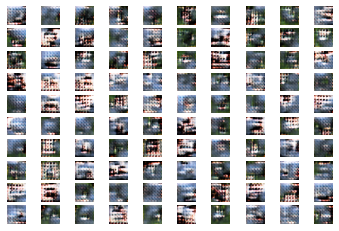

>24, 1/101, d1=0.543, d2=0.694 g=1.307
>24, 2/101, d1=0.654, d2=0.534 g=1.307
>24, 3/101, d1=0.667, d2=0.590 g=1.250
>24, 4/101, d1=0.660, d2=0.534 g=1.225
>24, 5/101, d1=0.554, d2=0.563 g=1.218
>24, 6/101, d1=0.555, d2=0.542 g=1.352
>24, 7/101, d1=0.608, d2=0.511 g=1.369
>24, 8/101, d1=0.593, d2=0.503 g=1.359
>24, 9/101, d1=0.618, d2=0.472 g=1.345
>24, 10/101, d1=0.699, d2=0.509 g=1.350
>24, 11/101, d1=0.548, d2=0.422 g=1.518
>24, 12/101, d1=0.696, d2=0.415 g=1.422
>24, 13/101, d1=0.620, d2=0.515 g=1.249
>24, 14/101, d1=0.645, d2=0.561 g=1.145
>24, 15/101, d1=0.514, d2=0.651 g=1.189
>24, 16/101, d1=0.571, d2=0.625 g=1.146
>24, 17/101, d1=0.625, d2=0.628 g=1.122
>24, 18/101, d1=0.632, d2=0.622 g=1.115
>24, 19/101, d1=0.796, d2=0.642 g=1.021
>24, 20/101, d1=0.650, d2=0.728 g=1.015
>24, 21/101, d1=0.690, d2=0.662 g=1.166
>24, 22/101, d1=0.809, d2=0.568 g=1.336
>24, 23/101, d1=0.691, d2=0.534 g=1.471
>24, 24/101, d1=0.595, d2=0.559 g=1.360
>24, 25/101, d1=0.598, d2=0.665 g=1.244
>24, 26/1

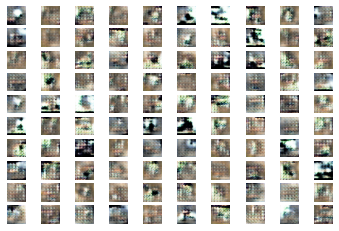

>25, 1/101, d1=0.551, d2=0.676 g=1.044
>25, 2/101, d1=0.645, d2=0.608 g=1.123
>25, 3/101, d1=0.631, d2=0.552 g=1.211
>25, 4/101, d1=0.637, d2=0.596 g=1.051
>25, 5/101, d1=0.597, d2=0.624 g=1.063
>25, 6/101, d1=0.633, d2=0.647 g=1.017
>25, 7/101, d1=0.580, d2=0.624 g=1.106
>25, 8/101, d1=0.692, d2=0.519 g=1.279
>25, 9/101, d1=0.774, d2=0.564 g=1.136
>25, 10/101, d1=0.596, d2=0.699 g=1.030
>25, 11/101, d1=0.641, d2=0.644 g=1.032
>25, 12/101, d1=0.615, d2=0.602 g=1.094
>25, 13/101, d1=0.701, d2=0.514 g=1.202
>25, 14/101, d1=0.635, d2=0.550 g=1.211
>25, 15/101, d1=0.732, d2=0.560 g=0.988
>25, 16/101, d1=0.614, d2=0.592 g=1.027
>25, 17/101, d1=0.620, d2=0.689 g=0.932
>25, 18/101, d1=0.637, d2=0.743 g=0.937
>25, 19/101, d1=0.704, d2=0.632 g=0.970
>25, 20/101, d1=0.642, d2=0.543 g=1.160
>25, 21/101, d1=0.692, d2=0.549 g=1.207
>25, 22/101, d1=0.693, d2=0.535 g=1.110
>25, 23/101, d1=0.704, d2=0.622 g=0.923
>25, 24/101, d1=0.667, d2=0.853 g=0.890
>25, 25/101, d1=0.687, d2=0.677 g=1.264
>25, 26/1

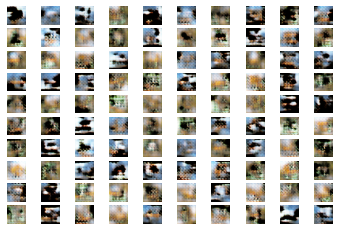

>26, 1/101, d1=0.601, d2=0.677 g=0.904
>26, 2/101, d1=0.587, d2=0.658 g=0.989
>26, 3/101, d1=0.650, d2=0.700 g=0.943
>26, 4/101, d1=0.626, d2=0.689 g=0.976
>26, 5/101, d1=0.740, d2=0.705 g=1.047
>26, 6/101, d1=0.729, d2=0.656 g=1.065
>26, 7/101, d1=0.643, d2=0.550 g=1.183
>26, 8/101, d1=0.771, d2=0.556 g=1.100
>26, 9/101, d1=0.676, d2=0.599 g=1.097
>26, 10/101, d1=0.754, d2=0.602 g=0.979
>26, 11/101, d1=0.695, d2=0.658 g=0.936
>26, 12/101, d1=0.684, d2=0.694 g=0.873
>26, 13/101, d1=0.664, d2=0.665 g=0.957
>26, 14/101, d1=0.635, d2=0.637 g=1.018
>26, 15/101, d1=0.673, d2=0.630 g=0.985
>26, 16/101, d1=0.621, d2=0.599 g=0.941
>26, 17/101, d1=0.632, d2=0.614 g=0.897
>26, 18/101, d1=0.594, d2=0.712 g=0.848
>26, 19/101, d1=0.533, d2=0.626 g=0.980
>26, 20/101, d1=0.608, d2=0.621 g=0.926
>26, 21/101, d1=0.526, d2=0.625 g=0.941
>26, 22/101, d1=0.542, d2=0.597 g=1.053
>26, 23/101, d1=0.538, d2=0.564 g=1.021
>26, 24/101, d1=0.561, d2=0.552 g=1.114
>26, 25/101, d1=0.474, d2=0.558 g=1.116
>26, 26/1

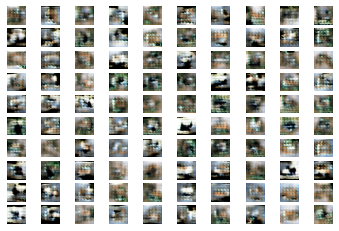

>27, 1/101, d1=0.633, d2=0.661 g=1.004
>27, 2/101, d1=0.615, d2=0.645 g=0.968
>27, 3/101, d1=0.583, d2=0.609 g=0.991
>27, 4/101, d1=0.563, d2=0.618 g=1.047
>27, 5/101, d1=0.602, d2=0.512 g=1.090
>27, 6/101, d1=0.561, d2=0.491 g=1.130
>27, 7/101, d1=0.565, d2=0.497 g=1.223
>27, 8/101, d1=0.624, d2=0.515 g=1.173
>27, 9/101, d1=0.603, d2=0.525 g=1.063
>27, 10/101, d1=0.573, d2=0.573 g=1.012
>27, 11/101, d1=0.524, d2=0.679 g=1.007
>27, 12/101, d1=0.575, d2=0.638 g=0.996
>27, 13/101, d1=0.581, d2=0.665 g=1.184
>27, 14/101, d1=0.687, d2=0.539 g=1.386
>27, 15/101, d1=0.765, d2=0.474 g=1.460
>27, 16/101, d1=0.717, d2=0.487 g=1.335
>27, 17/101, d1=0.604, d2=0.595 g=1.271
>27, 18/101, d1=0.668, d2=1.121 g=1.122
>27, 19/101, d1=0.811, d2=0.862 g=1.655
>27, 20/101, d1=0.917, d2=0.326 g=1.759
>27, 21/101, d1=0.832, d2=0.306 g=1.893
>27, 22/101, d1=0.710, d2=0.441 g=1.499
>27, 23/101, d1=0.586, d2=0.552 g=1.460
>27, 24/101, d1=0.672, d2=0.676 g=1.499
>27, 25/101, d1=0.572, d2=0.689 g=1.338
>27, 26/1

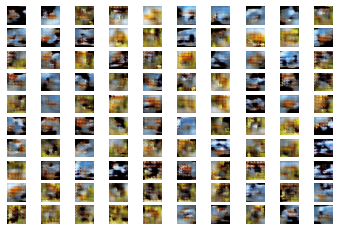

>28, 1/101, d1=0.590, d2=0.514 g=1.209
>28, 2/101, d1=0.553, d2=0.569 g=1.180
>28, 3/101, d1=0.692, d2=0.677 g=1.056
>28, 4/101, d1=0.616, d2=0.714 g=1.037
>28, 5/101, d1=0.715, d2=0.616 g=1.115
>28, 6/101, d1=0.731, d2=0.607 g=1.087
>28, 7/101, d1=0.747, d2=0.572 g=1.051
>28, 8/101, d1=0.615, d2=0.578 g=1.151
>28, 9/101, d1=0.601, d2=0.554 g=1.164
>28, 10/101, d1=0.692, d2=0.524 g=1.057
>28, 11/101, d1=0.642, d2=0.588 g=1.087
>28, 12/101, d1=0.542, d2=0.581 g=1.072
>28, 13/101, d1=0.620, d2=0.647 g=1.040
>28, 14/101, d1=0.627, d2=0.583 g=0.999
>28, 15/101, d1=0.577, d2=0.617 g=1.039
>28, 16/101, d1=0.551, d2=0.666 g=1.091
>28, 17/101, d1=0.629, d2=0.519 g=1.062
>28, 18/101, d1=0.669, d2=0.585 g=1.103
>28, 19/101, d1=0.581, d2=0.548 g=1.125
>28, 20/101, d1=0.728, d2=0.566 g=1.081
>28, 21/101, d1=0.625, d2=0.613 g=1.063
>28, 22/101, d1=0.634, d2=0.640 g=1.080
>28, 23/101, d1=0.602, d2=0.588 g=1.131
>28, 24/101, d1=0.593, d2=0.581 g=1.211
>28, 25/101, d1=0.647, d2=0.507 g=1.266
>28, 26/1

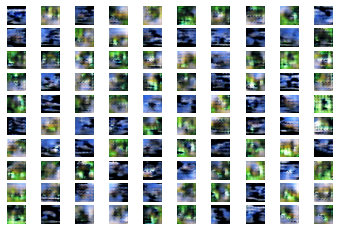

>29, 1/101, d1=0.970, d2=0.502 g=1.550
>29, 2/101, d1=0.731, d2=0.448 g=1.589
>29, 3/101, d1=0.562, d2=0.389 g=1.607
>29, 4/101, d1=0.579, d2=0.555 g=1.464
>29, 5/101, d1=0.573, d2=0.581 g=1.031
>29, 6/101, d1=0.571, d2=0.780 g=0.908
>29, 7/101, d1=0.677, d2=0.727 g=0.927
>29, 8/101, d1=0.679, d2=0.621 g=1.033
>29, 9/101, d1=0.709, d2=0.588 g=1.164
>29, 10/101, d1=0.642, d2=0.636 g=1.109
>29, 11/101, d1=0.650, d2=0.624 g=1.100
>29, 12/101, d1=0.659, d2=0.591 g=1.123
>29, 13/101, d1=0.622, d2=0.452 g=1.359
>29, 14/101, d1=0.656, d2=0.408 g=1.487
>29, 15/101, d1=0.599, d2=0.445 g=1.341
>29, 16/101, d1=0.661, d2=0.575 g=1.112
>29, 17/101, d1=0.544, d2=0.690 g=1.016
>29, 18/101, d1=0.511, d2=0.652 g=1.000
>29, 19/101, d1=0.498, d2=0.672 g=0.979
>29, 20/101, d1=0.582, d2=0.669 g=1.035
>29, 21/101, d1=0.515, d2=0.619 g=1.113
>29, 22/101, d1=0.644, d2=0.572 g=1.197
>29, 23/101, d1=0.611, d2=0.477 g=1.262
>29, 24/101, d1=0.741, d2=0.501 g=1.205
>29, 25/101, d1=0.631, d2=0.559 g=1.111
>29, 26/1

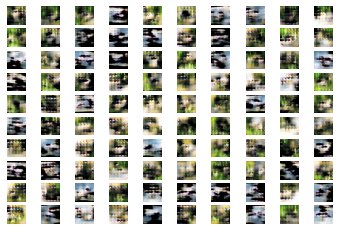

>30, 1/101, d1=0.693, d2=0.636 g=1.105
>30, 2/101, d1=0.755, d2=0.680 g=1.193
>30, 3/101, d1=0.838, d2=0.539 g=1.144
>30, 4/101, d1=0.680, d2=0.503 g=1.180
>30, 5/101, d1=0.686, d2=0.537 g=1.097
>30, 6/101, d1=0.620, d2=0.566 g=1.056
>30, 7/101, d1=0.664, d2=0.626 g=1.085
>30, 8/101, d1=0.576, d2=0.589 g=1.127
>30, 9/101, d1=0.758, d2=0.565 g=1.059
>30, 10/101, d1=0.648, d2=0.609 g=1.055
>30, 11/101, d1=0.597, d2=0.628 g=1.031
>30, 12/101, d1=0.610, d2=0.597 g=1.076
>30, 13/101, d1=0.684, d2=0.598 g=1.028
>30, 14/101, d1=0.581, d2=0.588 g=1.083
>30, 15/101, d1=0.626, d2=0.641 g=1.047
>30, 16/101, d1=0.550, d2=0.615 g=1.075
>30, 17/101, d1=0.574, d2=0.589 g=1.052
>30, 18/101, d1=0.624, d2=0.563 g=1.176
>30, 19/101, d1=0.631, d2=0.611 g=1.054
>30, 20/101, d1=0.598, d2=0.657 g=1.067
>30, 21/101, d1=0.691, d2=0.586 g=1.152
>30, 22/101, d1=0.670, d2=0.582 g=1.073
>30, 23/101, d1=0.605, d2=0.601 g=1.043
>30, 24/101, d1=0.590, d2=0.607 g=1.028
>30, 25/101, d1=0.627, d2=0.548 g=1.040
>30, 26/1

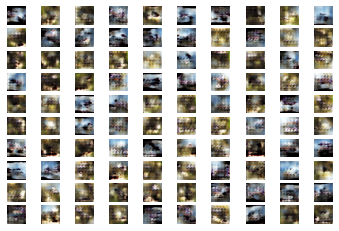

>31, 1/101, d1=0.654, d2=0.586 g=1.195
>31, 2/101, d1=0.695, d2=0.538 g=1.188
>31, 3/101, d1=0.677, d2=0.587 g=1.171
>31, 4/101, d1=0.628, d2=0.563 g=1.322
>31, 5/101, d1=0.658, d2=0.537 g=1.231
>31, 6/101, d1=0.727, d2=0.530 g=1.199
>31, 7/101, d1=0.726, d2=0.503 g=1.154
>31, 8/101, d1=0.632, d2=0.642 g=1.187
>31, 9/101, d1=0.716, d2=0.617 g=1.209
>31, 10/101, d1=0.788, d2=0.441 g=1.264
>31, 11/101, d1=0.706, d2=0.506 g=1.240
>31, 12/101, d1=0.672, d2=0.489 g=1.127
>31, 13/101, d1=0.594, d2=0.536 g=1.116
>31, 14/101, d1=0.580, d2=0.562 g=1.110
>31, 15/101, d1=0.615, d2=0.544 g=1.153
>31, 16/101, d1=0.635, d2=0.542 g=1.107
>31, 17/101, d1=0.512, d2=0.570 g=1.119
>31, 18/101, d1=0.613, d2=0.529 g=1.197
>31, 19/101, d1=0.542, d2=0.522 g=1.134
>31, 20/101, d1=0.526, d2=0.591 g=1.077
>31, 21/101, d1=0.553, d2=0.598 g=1.088
>31, 22/101, d1=0.628, d2=0.576 g=1.107
>31, 23/101, d1=0.636, d2=0.549 g=1.144
>31, 24/101, d1=0.695, d2=0.555 g=1.045
>31, 25/101, d1=0.570, d2=0.579 g=1.054
>31, 26/1

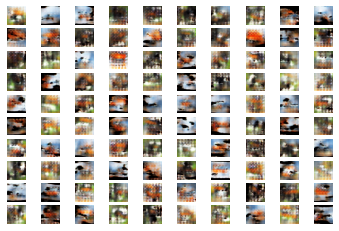

>32, 1/101, d1=0.636, d2=0.585 g=1.089
>32, 2/101, d1=0.572, d2=0.605 g=1.051
>32, 3/101, d1=0.598, d2=0.630 g=1.149
>32, 4/101, d1=0.604, d2=0.583 g=1.043
>32, 5/101, d1=0.632, d2=0.596 g=1.035
>32, 6/101, d1=0.606, d2=0.620 g=1.037
>32, 7/101, d1=0.628, d2=0.613 g=1.023
>32, 8/101, d1=0.617, d2=0.574 g=1.011
>32, 9/101, d1=0.679, d2=0.660 g=1.003
>32, 10/101, d1=0.611, d2=0.640 g=1.011
>32, 11/101, d1=0.610, d2=0.599 g=1.003
>32, 12/101, d1=0.639, d2=0.579 g=0.984
>32, 13/101, d1=0.611, d2=0.595 g=1.018
>32, 14/101, d1=0.586, d2=0.588 g=1.021
>32, 15/101, d1=0.627, d2=0.538 g=1.063
>32, 16/101, d1=0.615, d2=0.602 g=1.018
>32, 17/101, d1=0.617, d2=0.592 g=1.109
>32, 18/101, d1=0.623, d2=0.590 g=1.122
>32, 19/101, d1=0.584, d2=0.536 g=1.051
>32, 20/101, d1=0.656, d2=0.556 g=1.038
>32, 21/101, d1=0.647, d2=0.642 g=1.010
>32, 22/101, d1=0.705, d2=0.599 g=1.012
>32, 23/101, d1=0.644, d2=0.609 g=1.035
>32, 24/101, d1=0.679, d2=0.721 g=1.019
>32, 25/101, d1=0.681, d2=0.643 g=1.055
>32, 26/1

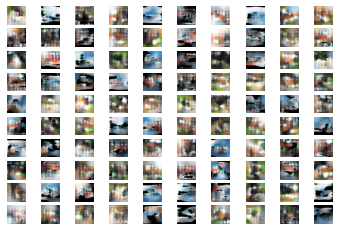

>33, 1/101, d1=0.597, d2=0.629 g=1.000
>33, 2/101, d1=0.700, d2=0.657 g=1.081
>33, 3/101, d1=0.692, d2=0.666 g=0.989
>33, 4/101, d1=0.641, d2=0.601 g=1.015
>33, 5/101, d1=0.578, d2=0.603 g=1.037
>33, 6/101, d1=0.638, d2=0.576 g=1.057
>33, 7/101, d1=0.631, d2=0.624 g=1.025
>33, 8/101, d1=0.613, d2=0.540 g=1.001
>33, 9/101, d1=0.636, d2=0.627 g=0.989
>33, 10/101, d1=0.656, d2=0.646 g=1.089
>33, 11/101, d1=0.573, d2=0.568 g=1.144
>33, 12/101, d1=0.699, d2=0.524 g=1.173
>33, 13/101, d1=0.686, d2=0.584 g=1.058
>33, 14/101, d1=0.588, d2=0.569 g=1.053
>33, 15/101, d1=0.637, d2=0.623 g=1.079
>33, 16/101, d1=0.637, d2=0.605 g=1.146
>33, 17/101, d1=0.609, d2=0.513 g=1.104
>33, 18/101, d1=0.645, d2=0.547 g=1.044
>33, 19/101, d1=0.642, d2=0.607 g=0.974
>33, 20/101, d1=0.645, d2=0.616 g=0.967
>33, 21/101, d1=0.600, d2=0.608 g=1.039
>33, 22/101, d1=0.588, d2=0.636 g=1.089
>33, 23/101, d1=0.610, d2=0.623 g=1.090
>33, 24/101, d1=0.711, d2=0.522 g=1.080
>33, 25/101, d1=0.615, d2=0.603 g=1.039
>33, 26/1

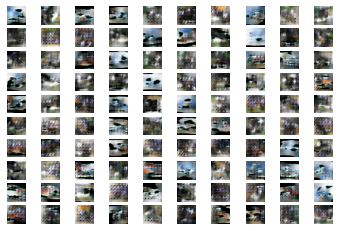

>34, 1/101, d1=0.712, d2=0.599 g=1.143
>34, 2/101, d1=0.722, d2=0.518 g=1.158
>34, 3/101, d1=0.763, d2=0.612 g=1.276
>34, 4/101, d1=0.738, d2=0.448 g=1.465
>34, 5/101, d1=0.639, d2=0.471 g=1.299
>34, 6/101, d1=0.655, d2=0.476 g=1.173
>34, 7/101, d1=0.552, d2=0.577 g=1.004
>34, 8/101, d1=0.542, d2=0.661 g=0.925
>34, 9/101, d1=0.505, d2=0.745 g=1.010
>34, 10/101, d1=0.629, d2=0.624 g=1.108
>34, 11/101, d1=0.606, d2=0.557 g=1.272
>34, 12/101, d1=0.645, d2=0.486 g=1.231
>34, 13/101, d1=0.566, d2=0.564 g=1.118
>34, 14/101, d1=0.582, d2=0.758 g=0.985
>34, 15/101, d1=0.809, d2=0.722 g=1.032
>34, 16/101, d1=0.662, d2=0.559 g=1.176
>34, 17/101, d1=0.709, d2=0.499 g=1.258
>34, 18/101, d1=0.638, d2=0.469 g=1.320
>34, 19/101, d1=0.609, d2=0.552 g=1.132
>34, 20/101, d1=0.697, d2=0.565 g=1.043
>34, 21/101, d1=0.623, d2=0.627 g=0.964
>34, 22/101, d1=0.569, d2=0.682 g=0.942
>34, 23/101, d1=0.615, d2=0.720 g=0.934
>34, 24/101, d1=0.575, d2=0.676 g=0.990
>34, 25/101, d1=0.707, d2=0.676 g=0.991
>34, 26/1

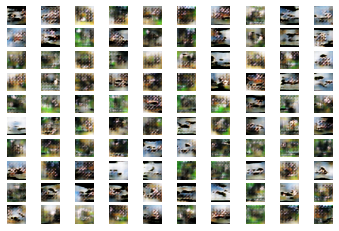

>35, 1/101, d1=0.611, d2=0.702 g=1.062
>35, 2/101, d1=0.613, d2=0.664 g=1.116
>35, 3/101, d1=0.674, d2=0.584 g=1.289
>35, 4/101, d1=0.762, d2=0.473 g=1.361
>35, 5/101, d1=0.737, d2=0.525 g=1.395
>35, 6/101, d1=0.655, d2=0.420 g=1.411
>35, 7/101, d1=0.573, d2=0.550 g=1.245
>35, 8/101, d1=0.528, d2=0.585 g=1.155
>35, 9/101, d1=0.527, d2=0.639 g=1.153
>35, 10/101, d1=0.770, d2=0.732 g=0.901
>35, 11/101, d1=0.552, d2=0.701 g=0.957
>35, 12/101, d1=0.602, d2=0.848 g=1.033
>35, 13/101, d1=0.624, d2=0.572 g=1.123
>35, 14/101, d1=0.708, d2=0.552 g=1.156
>35, 15/101, d1=0.715, d2=0.538 g=1.197
>35, 16/101, d1=0.617, d2=0.584 g=1.346
>35, 17/101, d1=0.680, d2=0.556 g=1.407
>35, 18/101, d1=0.554, d2=0.544 g=1.105
>35, 19/101, d1=0.574, d2=0.775 g=1.199
>35, 20/101, d1=0.701, d2=0.633 g=1.460
>35, 21/101, d1=0.768, d2=0.412 g=1.619
>35, 22/101, d1=0.730, d2=0.449 g=1.349
>35, 23/101, d1=0.691, d2=0.559 g=1.147
>35, 24/101, d1=0.545, d2=0.577 g=1.084
>35, 25/101, d1=0.529, d2=0.626 g=1.213
>35, 26/1

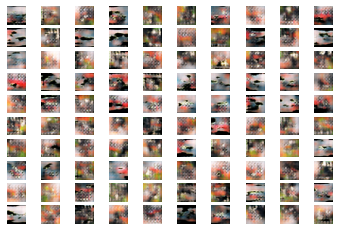

>36, 1/101, d1=0.725, d2=0.572 g=1.225
>36, 2/101, d1=0.601, d2=0.478 g=1.457
>36, 3/101, d1=0.658, d2=0.434 g=1.395
>36, 4/101, d1=0.612, d2=0.526 g=1.189
>36, 5/101, d1=0.645, d2=0.644 g=1.027
>36, 6/101, d1=0.538, d2=0.686 g=1.176
>36, 7/101, d1=0.595, d2=0.538 g=1.213
>36, 8/101, d1=0.629, d2=0.475 g=1.225
>36, 9/101, d1=0.622, d2=0.555 g=1.306
>36, 10/101, d1=0.685, d2=0.516 g=1.230
>36, 11/101, d1=0.576, d2=0.668 g=1.078
>36, 12/101, d1=0.594, d2=0.680 g=1.045
>36, 13/101, d1=0.556, d2=0.687 g=1.049
>36, 14/101, d1=0.574, d2=0.609 g=1.065
>36, 15/101, d1=0.709, d2=0.674 g=1.019
>36, 16/101, d1=0.655, d2=0.708 g=1.044
>36, 17/101, d1=0.657, d2=0.607 g=1.088
>36, 18/101, d1=0.668, d2=0.602 g=1.010
>36, 19/101, d1=0.628, d2=0.603 g=1.072
>36, 20/101, d1=0.670, d2=0.648 g=1.070
>36, 21/101, d1=0.634, d2=0.501 g=1.061
>36, 22/101, d1=0.564, d2=0.616 g=1.087
>36, 23/101, d1=0.622, d2=0.576 g=1.050
>36, 24/101, d1=0.679, d2=0.605 g=1.009
>36, 25/101, d1=0.628, d2=0.635 g=1.125
>36, 26/1

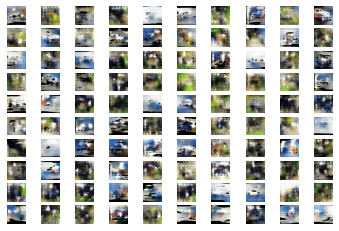

>37, 1/101, d1=0.659, d2=0.631 g=1.058
>37, 2/101, d1=0.633, d2=0.658 g=0.990
>37, 3/101, d1=0.572, d2=0.616 g=1.013
>37, 4/101, d1=0.586, d2=0.618 g=1.145
>37, 5/101, d1=0.658, d2=0.570 g=1.193
>37, 6/101, d1=0.697, d2=0.547 g=1.152
>37, 7/101, d1=0.801, d2=0.569 g=1.029
>37, 8/101, d1=0.661, d2=0.629 g=1.001
>37, 9/101, d1=0.668, d2=0.645 g=0.999
>37, 10/101, d1=0.572, d2=0.543 g=1.018
>37, 11/101, d1=0.528, d2=0.615 g=1.089
>37, 12/101, d1=0.646, d2=0.585 g=1.076
>37, 13/101, d1=0.626, d2=0.569 g=1.069
>37, 14/101, d1=0.611, d2=0.603 g=0.934
>37, 15/101, d1=0.555, d2=0.639 g=1.001
>37, 16/101, d1=0.520, d2=0.593 g=1.100
>37, 17/101, d1=0.600, d2=0.588 g=1.093
>37, 18/101, d1=0.654, d2=0.600 g=1.192
>37, 19/101, d1=0.656, d2=0.527 g=1.172
>37, 20/101, d1=0.615, d2=0.547 g=1.178
>37, 21/101, d1=0.598, d2=0.552 g=1.104
>37, 22/101, d1=0.617, d2=0.576 g=1.058
>37, 23/101, d1=0.533, d2=0.584 g=1.024
>37, 24/101, d1=0.598, d2=0.614 g=1.020
>37, 25/101, d1=0.628, d2=0.612 g=1.098
>37, 26/1

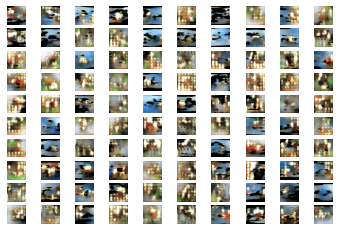

>38, 1/101, d1=0.596, d2=0.644 g=1.058
>38, 2/101, d1=0.696, d2=0.569 g=1.083
>38, 3/101, d1=0.616, d2=0.645 g=1.170
>38, 4/101, d1=0.715, d2=0.499 g=1.262
>38, 5/101, d1=0.600, d2=0.434 g=1.317
>38, 6/101, d1=0.776, d2=0.577 g=1.127
>38, 7/101, d1=0.617, d2=0.640 g=1.040
>38, 8/101, d1=0.637, d2=0.658 g=1.016
>38, 9/101, d1=0.650, d2=0.647 g=1.069
>38, 10/101, d1=0.674, d2=0.595 g=1.026
>38, 11/101, d1=0.764, d2=0.620 g=1.019
>38, 12/101, d1=0.651, d2=0.610 g=1.016
>38, 13/101, d1=0.659, d2=0.616 g=0.976
>38, 14/101, d1=0.627, d2=0.604 g=0.982
>38, 15/101, d1=0.632, d2=0.632 g=0.953
>38, 16/101, d1=0.610, d2=0.665 g=0.945
>38, 17/101, d1=0.578, d2=0.581 g=0.963
>38, 18/101, d1=0.542, d2=0.586 g=1.071
>38, 19/101, d1=0.489, d2=0.529 g=1.100
>38, 20/101, d1=0.492, d2=0.581 g=1.094
>38, 21/101, d1=0.558, d2=0.625 g=1.073
>38, 22/101, d1=0.466, d2=0.599 g=1.085
>38, 23/101, d1=0.519, d2=0.633 g=1.151
>38, 24/101, d1=0.577, d2=0.560 g=1.136
>38, 25/101, d1=0.637, d2=0.653 g=1.183
>38, 26/1

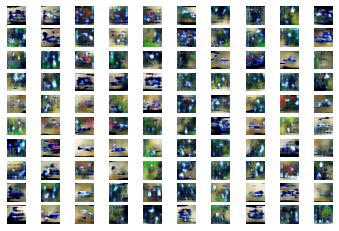

>39, 1/101, d1=0.686, d2=0.475 g=1.488
>39, 2/101, d1=0.772, d2=0.583 g=1.245
>39, 3/101, d1=0.749, d2=0.562 g=1.048
>39, 4/101, d1=0.555, d2=0.545 g=1.089
>39, 5/101, d1=0.491, d2=0.601 g=1.217
>39, 6/101, d1=0.595, d2=0.556 g=1.189
>39, 7/101, d1=0.543, d2=0.628 g=1.015
>39, 8/101, d1=0.608, d2=0.726 g=1.082
>39, 9/101, d1=0.721, d2=0.593 g=1.180
>39, 10/101, d1=0.665, d2=0.563 g=1.208
>39, 11/101, d1=0.614, d2=0.568 g=1.176
>39, 12/101, d1=0.587, d2=0.627 g=1.071
>39, 13/101, d1=0.578, d2=0.639 g=1.062
>39, 14/101, d1=0.680, d2=0.729 g=1.064
>39, 15/101, d1=0.662, d2=0.645 g=1.188
>39, 16/101, d1=0.607, d2=0.539 g=1.237
>39, 17/101, d1=0.750, d2=0.610 g=1.292
>39, 18/101, d1=0.761, d2=0.581 g=1.302
>39, 19/101, d1=0.716, d2=0.533 g=1.210
>39, 20/101, d1=0.663, d2=0.546 g=1.147
>39, 21/101, d1=0.589, d2=0.612 g=1.114
>39, 22/101, d1=0.567, d2=0.644 g=1.105
>39, 23/101, d1=0.679, d2=0.672 g=1.009
>39, 24/101, d1=0.674, d2=0.598 g=1.025
>39, 25/101, d1=0.578, d2=0.587 g=1.105
>39, 26/1

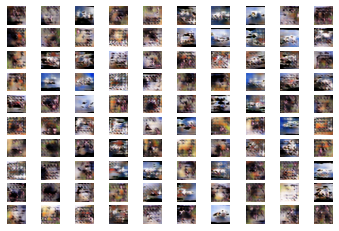

>40, 1/101, d1=0.648, d2=0.590 g=1.220
>40, 2/101, d1=0.698, d2=0.552 g=1.186
>40, 3/101, d1=0.670, d2=0.558 g=1.099
>40, 4/101, d1=0.654, d2=0.495 g=1.277
>40, 5/101, d1=0.601, d2=0.637 g=1.021
>40, 6/101, d1=0.501, d2=0.683 g=0.960
>40, 7/101, d1=0.561, d2=0.709 g=1.021
>40, 8/101, d1=0.577, d2=0.646 g=1.048
>40, 9/101, d1=0.672, d2=0.646 g=1.209
>40, 10/101, d1=0.688, d2=0.434 g=1.208
>40, 11/101, d1=0.633, d2=0.487 g=1.160
>40, 12/101, d1=0.628, d2=0.598 g=1.049
>40, 13/101, d1=0.647, d2=0.671 g=1.058
>40, 14/101, d1=0.546, d2=0.686 g=1.135
>40, 15/101, d1=0.578, d2=0.561 g=1.363
>40, 16/101, d1=0.747, d2=0.499 g=1.333
>40, 17/101, d1=0.640, d2=0.619 g=1.076
>40, 18/101, d1=0.735, d2=0.755 g=1.019
>40, 19/101, d1=0.618, d2=0.660 g=1.006
>40, 20/101, d1=0.624, d2=0.614 g=1.060
>40, 21/101, d1=0.635, d2=0.621 g=1.159
>40, 22/101, d1=0.668, d2=0.781 g=1.113
>40, 23/101, d1=0.628, d2=0.634 g=1.094
>40, 24/101, d1=0.694, d2=0.547 g=1.089
>40, 25/101, d1=0.655, d2=0.601 g=1.090
>40, 26/1

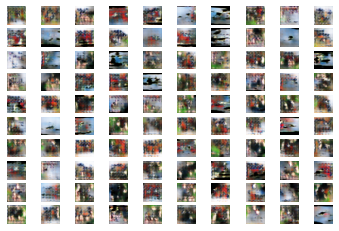

>41, 1/101, d1=0.601, d2=0.712 g=1.144
>41, 2/101, d1=0.615, d2=0.660 g=1.111
>41, 3/101, d1=0.633, d2=0.587 g=1.131
>41, 4/101, d1=0.682, d2=0.623 g=1.139
>41, 5/101, d1=0.657, d2=0.596 g=1.043
>41, 6/101, d1=0.712, d2=0.626 g=1.095
>41, 7/101, d1=0.699, d2=0.572 g=1.020
>41, 8/101, d1=0.671, d2=0.662 g=1.123
>41, 9/101, d1=0.603, d2=0.559 g=1.170
>41, 10/101, d1=0.740, d2=0.723 g=1.033
>41, 11/101, d1=0.656, d2=0.579 g=1.217
>41, 12/101, d1=0.736, d2=0.513 g=1.271
>41, 13/101, d1=0.747, d2=0.500 g=1.119
>41, 14/101, d1=0.693, d2=0.568 g=1.051
>41, 15/101, d1=0.669, d2=0.573 g=0.993
>41, 16/101, d1=0.616, d2=0.689 g=1.011
>41, 17/101, d1=0.599, d2=0.606 g=1.086
>41, 18/101, d1=0.555, d2=0.561 g=1.088
>41, 19/101, d1=0.687, d2=0.593 g=1.077
>41, 20/101, d1=0.606, d2=0.645 g=1.033
>41, 21/101, d1=0.550, d2=0.676 g=1.085
>41, 22/101, d1=0.646, d2=0.521 g=1.187
>41, 23/101, d1=0.614, d2=0.549 g=1.235
>41, 24/101, d1=0.682, d2=0.540 g=1.099
>41, 25/101, d1=0.623, d2=0.621 g=1.063
>41, 26/1

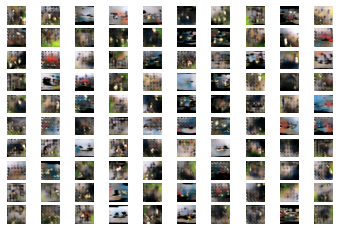

>42, 1/101, d1=0.554, d2=0.612 g=1.034
>42, 2/101, d1=0.556, d2=0.682 g=1.075
>42, 3/101, d1=0.637, d2=0.681 g=1.087
>42, 4/101, d1=0.633, d2=0.657 g=1.160
>42, 5/101, d1=0.715, d2=0.556 g=1.333
>42, 6/101, d1=0.637, d2=0.520 g=1.382
>42, 7/101, d1=0.693, d2=0.561 g=1.197
>42, 8/101, d1=0.587, d2=0.652 g=1.040
>42, 9/101, d1=0.509, d2=0.620 g=0.992
>42, 10/101, d1=0.551, d2=0.652 g=1.029
>42, 11/101, d1=0.492, d2=0.536 g=1.076
>42, 12/101, d1=0.527, d2=0.615 g=1.143
>42, 13/101, d1=0.549, d2=0.579 g=1.129
>42, 14/101, d1=0.601, d2=0.540 g=1.127
>42, 15/101, d1=0.564, d2=0.579 g=1.115
>42, 16/101, d1=0.555, d2=0.546 g=1.109
>42, 17/101, d1=0.559, d2=0.564 g=1.094
>42, 18/101, d1=0.557, d2=0.544 g=1.105
>42, 19/101, d1=0.537, d2=0.624 g=1.188
>42, 20/101, d1=0.591, d2=0.610 g=1.193
>42, 21/101, d1=0.601, d2=0.615 g=1.136
>42, 22/101, d1=0.620, d2=0.602 g=1.119
>42, 23/101, d1=0.726, d2=0.702 g=1.148
>42, 24/101, d1=0.719, d2=0.577 g=1.249
>42, 25/101, d1=0.725, d2=0.520 g=1.253
>42, 26/1

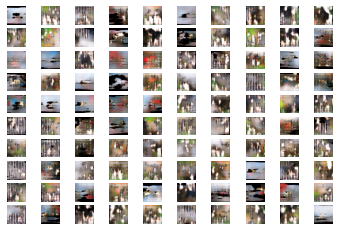

>43, 1/101, d1=0.787, d2=0.474 g=1.341
>43, 2/101, d1=0.772, d2=0.420 g=1.413
>43, 3/101, d1=0.706, d2=0.555 g=1.262
>43, 4/101, d1=0.610, d2=0.555 g=1.121
>43, 5/101, d1=0.655, d2=0.752 g=1.158
>43, 6/101, d1=0.631, d2=0.622 g=1.143
>43, 7/101, d1=0.589, d2=0.617 g=1.164
>43, 8/101, d1=0.659, d2=0.590 g=1.130
>43, 9/101, d1=0.618, d2=0.570 g=1.159
>43, 10/101, d1=0.577, d2=0.562 g=1.237
>43, 11/101, d1=0.583, d2=0.600 g=1.150
>43, 12/101, d1=0.520, d2=0.573 g=1.151
>43, 13/101, d1=0.627, d2=0.584 g=1.025
>43, 14/101, d1=0.648, d2=0.705 g=1.037
>43, 15/101, d1=0.608, d2=0.622 g=1.157
>43, 16/101, d1=0.641, d2=0.547 g=1.248
>43, 17/101, d1=0.609, d2=0.537 g=1.137
>43, 18/101, d1=0.555, d2=0.545 g=1.243
>43, 19/101, d1=0.568, d2=0.565 g=1.242
>43, 20/101, d1=0.512, d2=0.573 g=1.140
>43, 21/101, d1=0.515, d2=0.589 g=1.122
>43, 22/101, d1=0.477, d2=0.640 g=1.160
>43, 23/101, d1=0.573, d2=0.578 g=1.289
>43, 24/101, d1=0.641, d2=0.513 g=1.235
>43, 25/101, d1=0.616, d2=0.610 g=1.232
>43, 26/1

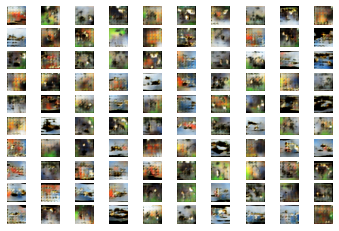

>44, 1/101, d1=0.632, d2=0.657 g=1.059
>44, 2/101, d1=0.765, d2=0.570 g=1.035
>44, 3/101, d1=0.721, d2=0.638 g=1.131
>44, 4/101, d1=0.619, d2=0.509 g=1.240
>44, 5/101, d1=0.642, d2=0.498 g=1.146
>44, 6/101, d1=0.619, d2=0.633 g=1.113
>44, 7/101, d1=0.538, d2=0.530 g=1.154
>44, 8/101, d1=0.612, d2=0.559 g=1.118
>44, 9/101, d1=0.582, d2=0.606 g=1.125
>44, 10/101, d1=0.500, d2=0.524 g=1.307
>44, 11/101, d1=0.598, d2=0.541 g=1.330
>44, 12/101, d1=0.553, d2=0.572 g=1.233
>44, 13/101, d1=0.619, d2=0.600 g=1.089
>44, 14/101, d1=0.579, d2=0.519 g=1.198
>44, 15/101, d1=0.603, d2=0.578 g=1.019
>44, 16/101, d1=0.571, d2=0.647 g=1.063
>44, 17/101, d1=0.522, d2=0.603 g=1.120
>44, 18/101, d1=0.465, d2=0.487 g=1.232
>44, 19/101, d1=0.472, d2=0.574 g=1.235
>44, 20/101, d1=0.588, d2=0.576 g=1.235
>44, 21/101, d1=0.505, d2=0.557 g=1.195
>44, 22/101, d1=0.473, d2=0.630 g=1.191
>44, 23/101, d1=0.503, d2=0.610 g=1.199
>44, 24/101, d1=0.513, d2=0.677 g=1.274
>44, 25/101, d1=0.662, d2=0.570 g=1.337
>44, 26/1

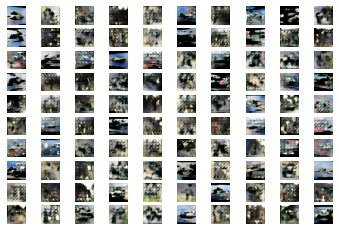

>45, 1/101, d1=0.727, d2=0.487 g=1.293
>45, 2/101, d1=0.668, d2=0.599 g=1.159
>45, 3/101, d1=0.615, d2=0.579 g=1.186
>45, 4/101, d1=0.675, d2=0.584 g=1.160
>45, 5/101, d1=0.610, d2=0.600 g=1.146
>45, 6/101, d1=0.563, d2=0.526 g=1.143
>45, 7/101, d1=0.577, d2=0.565 g=1.072
>45, 8/101, d1=0.490, d2=0.604 g=1.013
>45, 9/101, d1=0.514, d2=0.561 g=1.141
>45, 10/101, d1=0.502, d2=0.663 g=1.143
>45, 11/101, d1=0.497, d2=0.549 g=1.198
>45, 12/101, d1=0.471, d2=0.636 g=1.165
>45, 13/101, d1=0.540, d2=0.608 g=1.139
>45, 14/101, d1=0.601, d2=0.580 g=1.160
>45, 15/101, d1=0.497, d2=0.596 g=1.163
>45, 16/101, d1=0.582, d2=0.617 g=1.219
>45, 17/101, d1=0.530, d2=0.607 g=1.343
>45, 18/101, d1=0.629, d2=0.506 g=1.349
>45, 19/101, d1=0.761, d2=0.715 g=1.264
>45, 20/101, d1=0.833, d2=0.577 g=1.437
>45, 21/101, d1=0.805, d2=0.543 g=1.501
>45, 22/101, d1=0.667, d2=0.542 g=1.182
>45, 23/101, d1=0.724, d2=0.699 g=1.133
>45, 24/101, d1=0.652, d2=0.628 g=1.235
>45, 25/101, d1=0.761, d2=0.660 g=1.235
>45, 26/1

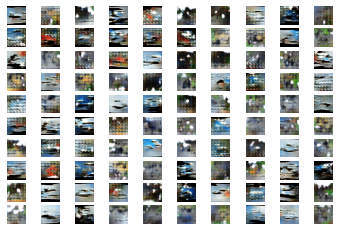

>46, 1/101, d1=0.558, d2=0.500 g=1.293
>46, 2/101, d1=0.548, d2=0.635 g=1.225
>46, 3/101, d1=0.475, d2=0.612 g=1.184
>46, 4/101, d1=0.508, d2=0.556 g=1.170
>46, 5/101, d1=0.544, d2=0.586 g=1.142
>46, 6/101, d1=0.518, d2=0.520 g=1.249
>46, 7/101, d1=0.450, d2=0.511 g=1.270
>46, 8/101, d1=0.516, d2=0.519 g=1.121
>46, 9/101, d1=0.459, d2=0.661 g=1.272
>46, 10/101, d1=0.502, d2=0.483 g=1.498
>46, 11/101, d1=0.585, d2=0.466 g=1.415
>46, 12/101, d1=0.639, d2=0.599 g=1.325
>46, 13/101, d1=0.568, d2=0.663 g=1.373
>46, 14/101, d1=0.657, d2=0.642 g=1.628
>46, 15/101, d1=0.768, d2=0.437 g=1.441
>46, 16/101, d1=0.777, d2=0.774 g=1.534
>46, 17/101, d1=0.741, d2=0.662 g=1.429
>46, 18/101, d1=0.845, d2=0.487 g=1.370
>46, 19/101, d1=0.736, d2=0.704 g=1.444
>46, 20/101, d1=0.788, d2=0.431 g=1.406
>46, 21/101, d1=0.762, d2=0.535 g=1.225
>46, 22/101, d1=0.706, d2=0.547 g=1.172
>46, 23/101, d1=0.704, d2=0.603 g=1.198
>46, 24/101, d1=0.630, d2=0.547 g=1.359
>46, 25/101, d1=0.638, d2=0.471 g=1.275
>46, 26/1

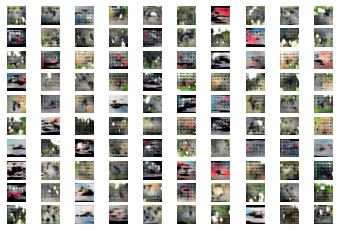

>47, 1/101, d1=0.666, d2=0.506 g=1.305
>47, 2/101, d1=0.606, d2=0.477 g=1.269
>47, 3/101, d1=0.632, d2=0.486 g=1.203
>47, 4/101, d1=0.628, d2=0.519 g=1.189
>47, 5/101, d1=0.586, d2=0.552 g=1.163
>47, 6/101, d1=0.573, d2=0.534 g=1.243
>47, 7/101, d1=0.537, d2=0.500 g=1.160
>47, 8/101, d1=0.462, d2=0.545 g=1.241
>47, 9/101, d1=0.526, d2=0.567 g=1.237
>47, 10/101, d1=0.569, d2=0.617 g=1.232
>47, 11/101, d1=0.584, d2=0.540 g=1.311
>47, 12/101, d1=0.694, d2=0.551 g=1.290
>47, 13/101, d1=0.608, d2=0.571 g=1.254
>47, 14/101, d1=0.538, d2=0.525 g=1.236
>47, 15/101, d1=0.517, d2=0.585 g=1.298
>47, 16/101, d1=0.598, d2=0.585 g=1.306
>47, 17/101, d1=0.576, d2=0.600 g=1.445
>47, 18/101, d1=0.649, d2=0.445 g=1.299
>47, 19/101, d1=0.564, d2=0.599 g=1.231
>47, 20/101, d1=0.621, d2=0.647 g=1.302
>47, 21/101, d1=0.668, d2=0.525 g=1.314
>47, 22/101, d1=0.533, d2=0.654 g=1.404
>47, 23/101, d1=0.558, d2=0.486 g=1.395
>47, 24/101, d1=0.681, d2=0.526 g=1.457
>47, 25/101, d1=0.741, d2=0.504 g=1.315
>47, 26/1

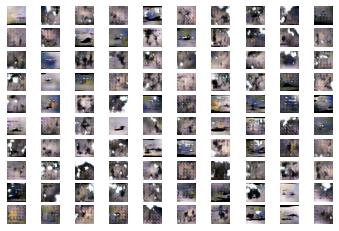

>48, 1/101, d1=0.560, d2=0.721 g=1.195
>48, 2/101, d1=0.708, d2=0.560 g=1.160
>48, 3/101, d1=0.652, d2=0.546 g=1.095
>48, 4/101, d1=0.622, d2=0.634 g=1.173
>48, 5/101, d1=0.585, d2=0.562 g=1.298
>48, 6/101, d1=0.620, d2=0.518 g=1.310
>48, 7/101, d1=0.666, d2=0.522 g=1.305
>48, 8/101, d1=0.643, d2=0.550 g=1.269
>48, 9/101, d1=0.644, d2=0.674 g=1.277
>48, 10/101, d1=0.636, d2=0.547 g=1.224
>48, 11/101, d1=0.604, d2=0.510 g=1.157
>48, 12/101, d1=0.572, d2=0.591 g=1.191
>48, 13/101, d1=0.621, d2=0.614 g=1.253
>48, 14/101, d1=0.679, d2=0.555 g=1.232
>48, 15/101, d1=0.679, d2=0.592 g=1.253
>48, 16/101, d1=0.594, d2=0.637 g=1.328
>48, 17/101, d1=0.681, d2=0.538 g=1.578
>48, 18/101, d1=0.597, d2=0.290 g=1.727
>48, 19/101, d1=0.531, d2=0.511 g=1.382
>48, 20/101, d1=0.580, d2=0.590 g=1.066
>48, 21/101, d1=0.622, d2=0.663 g=1.160
>48, 22/101, d1=0.693, d2=0.617 g=1.235
>48, 23/101, d1=0.643, d2=0.536 g=1.324
>48, 24/101, d1=0.634, d2=0.488 g=1.324
>48, 25/101, d1=0.574, d2=0.576 g=1.182
>48, 26/1

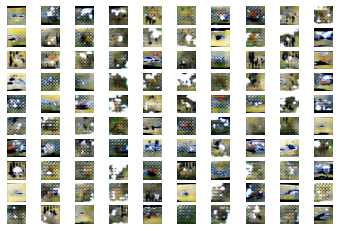

>49, 1/101, d1=0.532, d2=0.488 g=1.327
>49, 2/101, d1=0.639, d2=0.559 g=1.288
>49, 3/101, d1=0.463, d2=0.572 g=1.236
>49, 4/101, d1=0.574, d2=0.623 g=1.271
>49, 5/101, d1=0.610, d2=0.620 g=1.258
>49, 6/101, d1=0.634, d2=0.555 g=1.179
>49, 7/101, d1=0.649, d2=0.685 g=1.116
>49, 8/101, d1=0.664, d2=0.744 g=1.404
>49, 9/101, d1=0.812, d2=0.609 g=1.481
>49, 10/101, d1=0.843, d2=0.512 g=1.541
>49, 11/101, d1=0.694, d2=0.537 g=1.473
>49, 12/101, d1=0.573, d2=0.500 g=1.476
>49, 13/101, d1=0.531, d2=0.554 g=1.418
>49, 14/101, d1=0.497, d2=0.609 g=1.339
>49, 15/101, d1=0.556, d2=0.700 g=1.360
>49, 16/101, d1=0.670, d2=0.663 g=1.621
>49, 17/101, d1=0.671, d2=0.430 g=1.644
>49, 18/101, d1=0.544, d2=0.470 g=1.607
>49, 19/101, d1=0.422, d2=0.450 g=1.535
>49, 20/101, d1=0.484, d2=0.508 g=1.425
>49, 21/101, d1=0.407, d2=0.548 g=1.435
>49, 22/101, d1=0.542, d2=0.564 g=1.431
>49, 23/101, d1=0.446, d2=0.505 g=1.375
>49, 24/101, d1=0.521, d2=0.516 g=1.340
>49, 25/101, d1=0.506, d2=0.567 g=1.409
>49, 26/1

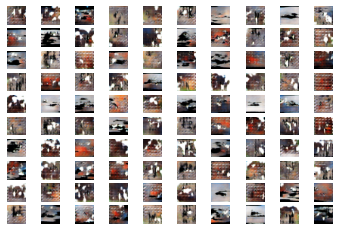

>50, 1/101, d1=0.629, d2=0.500 g=1.272
>50, 2/101, d1=0.563, d2=0.569 g=1.139
>50, 3/101, d1=0.512, d2=0.571 g=1.170
>50, 4/101, d1=0.605, d2=0.574 g=1.086
>50, 5/101, d1=0.579, d2=0.602 g=1.133
>50, 6/101, d1=0.547, d2=0.627 g=1.295
>50, 7/101, d1=0.541, d2=0.517 g=1.391
>50, 8/101, d1=0.665, d2=0.471 g=1.440
>50, 9/101, d1=0.606, d2=0.494 g=1.623
>50, 10/101, d1=0.494, d2=0.363 g=1.588
>50, 11/101, d1=0.590, d2=0.493 g=1.596
>50, 12/101, d1=0.460, d2=0.518 g=1.498
>50, 13/101, d1=0.430, d2=0.599 g=1.640
>50, 14/101, d1=0.709, d2=0.640 g=1.579
>50, 15/101, d1=0.736, d2=0.501 g=1.569
>50, 16/101, d1=0.921, d2=0.474 g=1.388
>50, 17/101, d1=0.632, d2=0.483 g=1.248
>50, 18/101, d1=0.600, d2=0.603 g=1.213
>50, 19/101, d1=0.564, d2=0.577 g=1.291
>50, 20/101, d1=0.552, d2=0.624 g=1.167
>50, 21/101, d1=0.485, d2=0.546 g=1.234
>50, 22/101, d1=0.609, d2=0.737 g=1.218
>50, 23/101, d1=0.574, d2=0.564 g=1.328
>50, 24/101, d1=0.584, d2=0.612 g=1.233
>50, 25/101, d1=0.787, d2=0.636 g=1.222
>50, 26/1

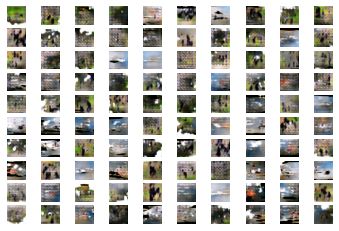

>51, 1/101, d1=0.588, d2=0.531 g=1.151
>51, 2/101, d1=0.641, d2=0.525 g=1.184
>51, 3/101, d1=0.521, d2=0.580 g=1.235
>51, 4/101, d1=0.600, d2=0.582 g=1.249
>51, 5/101, d1=0.661, d2=0.526 g=1.195
>51, 6/101, d1=0.522, d2=0.590 g=1.159
>51, 7/101, d1=0.489, d2=0.540 g=1.162
>51, 8/101, d1=0.602, d2=0.636 g=1.174
>51, 9/101, d1=0.579, d2=0.563 g=1.211
>51, 10/101, d1=0.552, d2=0.528 g=1.151
>51, 11/101, d1=0.641, d2=0.496 g=1.262
>51, 12/101, d1=0.657, d2=0.652 g=1.163
>51, 13/101, d1=0.655, d2=0.517 g=1.200
>51, 14/101, d1=0.610, d2=0.616 g=1.225
>51, 15/101, d1=0.700, d2=0.566 g=1.210
>51, 16/101, d1=0.503, d2=0.598 g=1.249
>51, 17/101, d1=0.598, d2=0.549 g=1.162
>51, 18/101, d1=0.592, d2=0.582 g=1.191
>51, 19/101, d1=0.558, d2=0.621 g=1.151
>51, 20/101, d1=0.595, d2=0.570 g=1.195
>51, 21/101, d1=0.610, d2=0.547 g=1.295
>51, 22/101, d1=0.565, d2=0.517 g=1.238
>51, 23/101, d1=0.655, d2=0.576 g=1.160
>51, 24/101, d1=0.624, d2=0.601 g=1.017
>51, 25/101, d1=0.531, d2=0.646 g=1.038
>51, 26/1

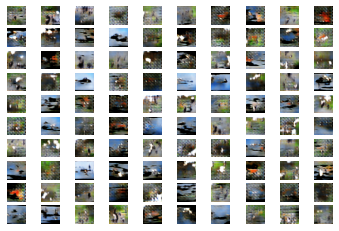

>52, 1/101, d1=0.663, d2=0.641 g=1.201
>52, 2/101, d1=0.617, d2=0.655 g=1.122
>52, 3/101, d1=0.585, d2=0.628 g=1.230
>52, 4/101, d1=0.649, d2=0.542 g=1.228
>52, 5/101, d1=0.646, d2=0.568 g=1.220
>52, 6/101, d1=0.713, d2=0.581 g=1.072
>52, 7/101, d1=0.611, d2=0.605 g=1.029
>52, 8/101, d1=0.578, d2=0.624 g=1.146
>52, 9/101, d1=0.548, d2=0.568 g=1.194
>52, 10/101, d1=0.541, d2=0.565 g=1.182
>52, 11/101, d1=0.639, d2=0.605 g=1.190
>52, 12/101, d1=0.589, d2=0.573 g=1.142
>52, 13/101, d1=0.554, d2=0.618 g=1.180
>52, 14/101, d1=0.687, d2=0.521 g=1.255
>52, 15/101, d1=0.627, d2=0.594 g=1.293
>52, 16/101, d1=0.616, d2=0.467 g=1.283
>52, 17/101, d1=0.746, d2=0.530 g=1.278
>52, 18/101, d1=0.600, d2=0.499 g=1.139
>52, 19/101, d1=0.547, d2=0.547 g=1.139
>52, 20/101, d1=0.554, d2=0.546 g=1.205
>52, 21/101, d1=0.670, d2=0.610 g=1.209
>52, 22/101, d1=0.604, d2=0.571 g=1.242
>52, 23/101, d1=0.623, d2=0.573 g=1.172
>52, 24/101, d1=0.533, d2=0.514 g=1.170
>52, 25/101, d1=0.676, d2=0.547 g=1.088
>52, 26/1

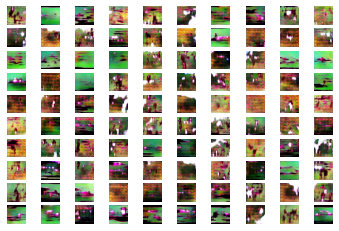

>53, 1/101, d1=0.625, d2=0.326 g=1.935
>53, 2/101, d1=0.504, d2=0.378 g=1.605
>53, 3/101, d1=0.467, d2=0.637 g=1.388
>53, 4/101, d1=0.635, d2=0.559 g=1.578
>53, 5/101, d1=0.673, d2=0.557 g=1.533
>53, 6/101, d1=0.655, d2=0.618 g=1.468
>53, 7/101, d1=0.665, d2=0.570 g=1.447
>53, 8/101, d1=0.683, d2=0.546 g=1.401
>53, 9/101, d1=0.726, d2=0.595 g=1.349
>53, 10/101, d1=0.642, d2=0.438 g=1.473
>53, 11/101, d1=0.693, d2=0.533 g=1.390
>53, 12/101, d1=0.687, d2=0.644 g=1.221
>53, 13/101, d1=0.564, d2=0.633 g=1.158
>53, 14/101, d1=0.704, d2=0.606 g=1.094
>53, 15/101, d1=0.677, d2=0.595 g=1.212
>53, 16/101, d1=0.575, d2=0.602 g=1.114
>53, 17/101, d1=0.513, d2=0.619 g=1.195
>53, 18/101, d1=0.666, d2=0.669 g=1.145
>53, 19/101, d1=0.495, d2=0.637 g=1.339
>53, 20/101, d1=0.614, d2=0.521 g=1.427
>53, 21/101, d1=0.690, d2=0.498 g=1.353
>53, 22/101, d1=0.794, d2=0.565 g=1.276
>53, 23/101, d1=0.546, d2=0.590 g=1.348
>53, 24/101, d1=0.729, d2=0.595 g=1.126
>53, 25/101, d1=0.572, d2=0.695 g=1.104
>53, 26/1

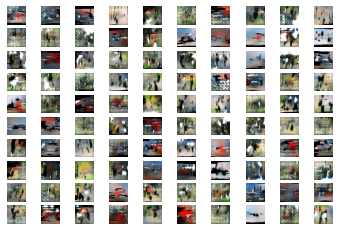

>54, 1/101, d1=0.674, d2=0.571 g=1.227
>54, 2/101, d1=0.731, d2=0.651 g=1.227
>54, 3/101, d1=0.679, d2=0.532 g=1.248
>54, 4/101, d1=0.680, d2=0.580 g=1.247
>54, 5/101, d1=0.631, d2=0.596 g=1.051
>54, 6/101, d1=0.672, d2=0.709 g=1.081
>54, 7/101, d1=0.577, d2=0.677 g=1.025
>54, 8/101, d1=0.600, d2=0.657 g=1.061
>54, 9/101, d1=0.645, d2=0.614 g=1.085
>54, 10/101, d1=0.634, d2=0.635 g=1.102
>54, 11/101, d1=0.610, d2=0.653 g=1.140
>54, 12/101, d1=0.504, d2=0.537 g=1.124
>54, 13/101, d1=0.660, d2=0.627 g=1.212
>54, 14/101, d1=0.697, d2=0.618 g=1.121
>54, 15/101, d1=0.594, d2=0.564 g=1.151
>54, 16/101, d1=0.567, d2=0.513 g=1.215
>54, 17/101, d1=0.709, d2=0.599 g=1.123
>54, 18/101, d1=0.535, d2=0.510 g=1.090
>54, 19/101, d1=0.515, d2=0.568 g=1.113
>54, 20/101, d1=0.581, d2=0.611 g=1.209
>54, 21/101, d1=0.654, d2=0.481 g=1.304
>54, 22/101, d1=0.696, d2=0.608 g=1.187
>54, 23/101, d1=0.596, d2=0.603 g=1.180
>54, 24/101, d1=0.570, d2=0.636 g=1.173
>54, 25/101, d1=0.690, d2=0.594 g=1.141
>54, 26/1

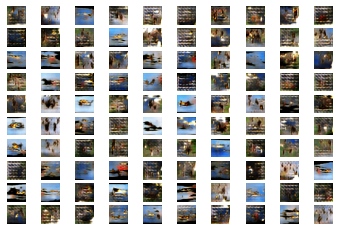

>55, 1/101, d1=0.715, d2=0.467 g=1.445
>55, 2/101, d1=0.585, d2=0.459 g=1.148
>55, 3/101, d1=0.558, d2=0.550 g=1.201
>55, 4/101, d1=0.675, d2=0.609 g=1.092
>55, 5/101, d1=0.547, d2=0.583 g=1.176
>55, 6/101, d1=0.504, d2=0.568 g=1.284
>55, 7/101, d1=0.657, d2=0.494 g=1.196
>55, 8/101, d1=0.478, d2=0.529 g=1.237
>55, 9/101, d1=0.663, d2=0.517 g=1.160
>55, 10/101, d1=0.495, d2=0.618 g=1.199
>55, 11/101, d1=0.485, d2=0.696 g=1.272
>55, 12/101, d1=0.744, d2=0.612 g=1.366
>55, 13/101, d1=0.782, d2=0.612 g=1.463
>55, 14/101, d1=0.759, d2=0.421 g=1.474
>55, 15/101, d1=0.653, d2=0.441 g=1.326
>55, 16/101, d1=0.617, d2=0.520 g=1.448
>55, 17/101, d1=0.653, d2=0.500 g=1.415
>55, 18/101, d1=0.559, d2=0.520 g=1.305
>55, 19/101, d1=0.533, d2=0.503 g=1.445
>55, 20/101, d1=0.649, d2=0.464 g=1.326
>55, 21/101, d1=0.564, d2=0.545 g=1.204
>55, 22/101, d1=0.549, d2=0.728 g=1.160
>55, 23/101, d1=0.692, d2=0.594 g=1.325
>55, 24/101, d1=0.598, d2=0.548 g=1.247
>55, 25/101, d1=0.722, d2=0.611 g=1.208
>55, 26/1

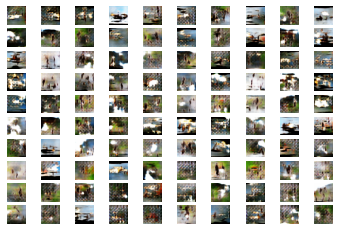

>56, 1/101, d1=0.689, d2=0.673 g=1.115
>56, 2/101, d1=0.729, d2=0.534 g=1.098
>56, 3/101, d1=0.603, d2=0.618 g=1.153
>56, 4/101, d1=0.604, d2=0.591 g=1.165
>56, 5/101, d1=0.636, d2=0.461 g=1.088
>56, 6/101, d1=0.605, d2=0.563 g=1.059
>56, 7/101, d1=0.581, d2=0.655 g=1.109
>56, 8/101, d1=0.585, d2=0.558 g=1.182
>56, 9/101, d1=0.641, d2=0.525 g=1.151
>56, 10/101, d1=0.575, d2=0.608 g=1.121
>56, 11/101, d1=0.521, d2=0.604 g=1.109
>56, 12/101, d1=0.577, d2=0.659 g=1.182
>56, 13/101, d1=0.752, d2=0.596 g=1.186
>56, 14/101, d1=0.610, d2=0.542 g=1.245
>56, 15/101, d1=0.710, d2=0.629 g=1.069
>56, 16/101, d1=0.608, d2=0.596 g=1.167
>56, 17/101, d1=0.656, d2=0.465 g=1.257
>56, 18/101, d1=0.567, d2=0.519 g=1.222
>56, 19/101, d1=0.643, d2=0.568 g=1.127
>56, 20/101, d1=0.654, d2=0.620 g=1.086
>56, 21/101, d1=0.712, d2=0.527 g=1.053
>56, 22/101, d1=0.513, d2=0.643 g=1.055
>56, 23/101, d1=0.536, d2=0.673 g=1.110
>56, 24/101, d1=0.668, d2=0.614 g=1.123
>56, 25/101, d1=0.683, d2=0.703 g=1.101
>56, 26/1

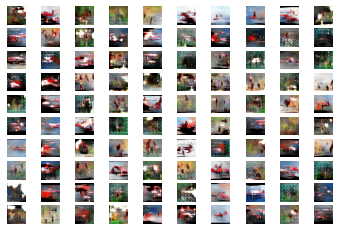

>57, 1/101, d1=0.572, d2=0.560 g=1.164
>57, 2/101, d1=0.600, d2=0.625 g=1.159
>57, 3/101, d1=0.737, d2=0.623 g=1.174
>57, 4/101, d1=0.709, d2=0.581 g=1.116
>57, 5/101, d1=0.595, d2=0.577 g=1.079
>57, 6/101, d1=0.663, d2=0.591 g=1.129
>57, 7/101, d1=0.697, d2=0.634 g=1.204
>57, 8/101, d1=0.736, d2=0.540 g=1.283
>57, 9/101, d1=0.665, d2=0.572 g=1.153
>57, 10/101, d1=0.625, d2=0.603 g=1.050
>57, 11/101, d1=0.535, d2=0.769 g=0.951
>57, 12/101, d1=0.620, d2=0.618 g=1.036
>57, 13/101, d1=0.675, d2=0.585 g=1.096
>57, 14/101, d1=0.685, d2=0.612 g=1.160
>57, 15/101, d1=0.626, d2=0.622 g=1.081
>57, 16/101, d1=0.647, d2=0.556 g=1.132
>57, 17/101, d1=0.606, d2=0.590 g=1.230
>57, 18/101, d1=0.699, d2=0.560 g=1.224
>57, 19/101, d1=0.656, d2=0.585 g=1.101
>57, 20/101, d1=0.636, d2=0.596 g=1.213
>57, 21/101, d1=0.563, d2=0.489 g=1.231
>57, 22/101, d1=0.561, d2=0.589 g=1.192
>57, 23/101, d1=0.623, d2=0.607 g=1.113
>57, 24/101, d1=0.688, d2=0.544 g=1.132
>57, 25/101, d1=0.600, d2=0.530 g=1.201
>57, 26/1

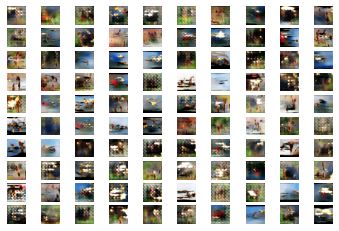

>58, 1/101, d1=0.536, d2=0.604 g=1.096
>58, 2/101, d1=0.576, d2=0.552 g=1.089
>58, 3/101, d1=0.451, d2=0.518 g=1.199
>58, 4/101, d1=0.619, d2=0.597 g=1.152
>58, 5/101, d1=0.583, d2=0.618 g=1.128
>58, 6/101, d1=0.562, d2=0.655 g=1.121
>58, 7/101, d1=0.554, d2=0.605 g=1.144
>58, 8/101, d1=0.679, d2=0.527 g=1.129
>58, 9/101, d1=0.611, d2=0.694 g=1.072
>58, 10/101, d1=0.589, d2=0.604 g=1.112
>58, 11/101, d1=0.607, d2=0.660 g=1.296
>58, 12/101, d1=0.651, d2=0.508 g=1.308
>58, 13/101, d1=0.678, d2=0.482 g=1.195
>58, 14/101, d1=0.568, d2=0.533 g=1.082
>58, 15/101, d1=0.538, d2=0.756 g=1.044
>58, 16/101, d1=0.671, d2=0.683 g=1.181
>58, 17/101, d1=0.716, d2=0.903 g=1.239
>58, 18/101, d1=0.681, d2=0.432 g=1.261
>58, 19/101, d1=0.778, d2=0.693 g=1.161
>58, 20/101, d1=0.673, d2=0.568 g=1.154
>58, 21/101, d1=0.655, d2=0.572 g=1.068
>58, 22/101, d1=0.653, d2=0.653 g=0.992
>58, 23/101, d1=0.591, d2=0.644 g=0.994
>58, 24/101, d1=0.470, d2=0.610 g=1.107
>58, 25/101, d1=0.636, d2=0.671 g=1.109
>58, 26/1

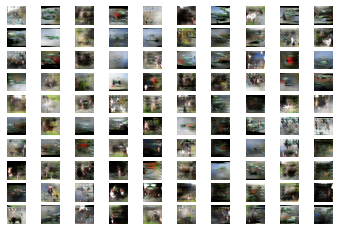

>59, 1/101, d1=0.577, d2=0.658 g=1.196
>59, 2/101, d1=0.718, d2=0.527 g=1.189
>59, 3/101, d1=0.756, d2=0.608 g=1.107
>59, 4/101, d1=0.742, d2=0.578 g=1.147
>59, 5/101, d1=0.665, d2=0.594 g=1.214
>59, 6/101, d1=0.603, d2=0.547 g=1.191
>59, 7/101, d1=0.644, d2=0.500 g=1.144
>59, 8/101, d1=0.674, d2=0.632 g=1.117
>59, 9/101, d1=0.590, d2=0.747 g=1.118
>59, 10/101, d1=0.682, d2=0.768 g=1.318
>59, 11/101, d1=0.720, d2=0.390 g=1.361
>59, 12/101, d1=0.755, d2=0.537 g=1.205
>59, 13/101, d1=0.663, d2=0.606 g=1.094
>59, 14/101, d1=0.607, d2=0.617 g=1.152
>59, 15/101, d1=0.652, d2=0.548 g=1.132
>59, 16/101, d1=0.547, d2=0.627 g=1.090
>59, 17/101, d1=0.549, d2=0.677 g=1.264
>59, 18/101, d1=0.609, d2=0.482 g=1.364
>59, 19/101, d1=0.652, d2=0.449 g=1.321
>59, 20/101, d1=0.726, d2=0.844 g=1.161
>59, 21/101, d1=0.615, d2=0.568 g=1.148
>59, 22/101, d1=0.622, d2=0.552 g=1.147
>59, 23/101, d1=0.635, d2=0.542 g=1.034
>59, 24/101, d1=0.640, d2=0.549 g=0.961
>59, 25/101, d1=0.526, d2=0.761 g=1.003
>59, 26/1

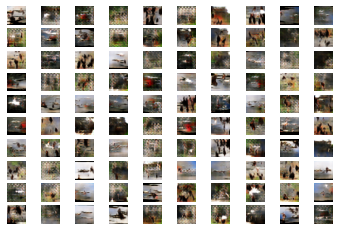

>60, 1/101, d1=0.684, d2=0.488 g=1.041
>60, 2/101, d1=0.789, d2=0.608 g=1.017
>60, 3/101, d1=0.644, d2=0.602 g=0.978
>60, 4/101, d1=0.588, d2=0.610 g=0.966
>60, 5/101, d1=0.583, d2=0.579 g=0.967
>60, 6/101, d1=0.601, d2=0.661 g=1.043
>60, 7/101, d1=0.602, d2=0.653 g=1.103
>60, 8/101, d1=0.548, d2=0.611 g=1.144
>60, 9/101, d1=0.661, d2=0.532 g=1.208
>60, 10/101, d1=0.667, d2=0.547 g=1.081
>60, 11/101, d1=0.670, d2=0.640 g=1.058
>60, 12/101, d1=0.623, d2=0.624 g=0.984
>60, 13/101, d1=0.595, d2=0.702 g=1.069
>60, 14/101, d1=0.569, d2=0.587 g=1.052
>60, 15/101, d1=0.589, d2=0.605 g=1.118
>60, 16/101, d1=0.622, d2=0.565 g=1.112
>60, 17/101, d1=0.580, d2=0.563 g=1.098
>60, 18/101, d1=0.623, d2=0.580 g=1.057
>60, 19/101, d1=0.631, d2=0.637 g=1.074
>60, 20/101, d1=0.602, d2=0.581 g=1.013
>60, 21/101, d1=0.650, d2=0.571 g=1.019
>60, 22/101, d1=0.572, d2=0.605 g=1.014
>60, 23/101, d1=0.581, d2=0.597 g=1.031
>60, 24/101, d1=0.545, d2=0.579 g=1.039
>60, 25/101, d1=0.627, d2=0.530 g=1.061
>60, 26/1

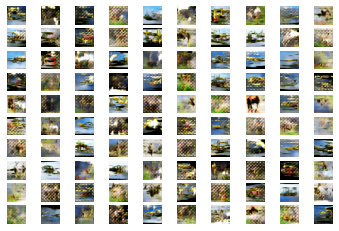

>61, 1/101, d1=0.648, d2=0.530 g=1.186
>61, 2/101, d1=0.596, d2=0.533 g=1.164
>61, 3/101, d1=0.636, d2=0.556 g=1.042
>61, 4/101, d1=0.625, d2=0.696 g=1.101
>61, 5/101, d1=0.575, d2=0.693 g=1.110
>61, 6/101, d1=0.667, d2=0.553 g=1.071
>61, 7/101, d1=0.650, d2=0.596 g=1.054
>61, 8/101, d1=0.702, d2=0.594 g=0.966
>61, 9/101, d1=0.657, d2=0.669 g=0.977
>61, 10/101, d1=0.630, d2=0.592 g=0.974
>61, 11/101, d1=0.604, d2=0.607 g=1.065
>61, 12/101, d1=0.698, d2=0.612 g=1.021
>61, 13/101, d1=0.555, d2=0.572 g=1.051
>61, 14/101, d1=0.614, d2=0.591 g=0.946
>61, 15/101, d1=0.489, d2=0.593 g=1.116
>61, 16/101, d1=0.713, d2=0.565 g=1.107
>61, 17/101, d1=0.738, d2=0.548 g=1.121
>61, 18/101, d1=0.802, d2=0.542 g=1.057
>61, 19/101, d1=0.620, d2=0.617 g=1.064
>61, 20/101, d1=0.631, d2=0.661 g=1.033
>61, 21/101, d1=0.642, d2=0.608 g=1.066
>61, 22/101, d1=0.702, d2=0.575 g=1.068
>61, 23/101, d1=0.687, d2=0.588 g=1.092
>61, 24/101, d1=0.614, d2=0.624 g=1.158
>61, 25/101, d1=0.716, d2=0.521 g=1.149
>61, 26/1

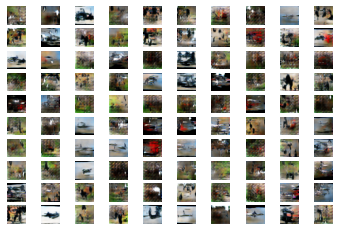

>62, 1/101, d1=0.694, d2=0.493 g=1.212
>62, 2/101, d1=0.574, d2=0.564 g=1.093
>62, 3/101, d1=0.640, d2=0.621 g=1.050
>62, 4/101, d1=0.563, d2=0.584 g=1.014
>62, 5/101, d1=0.503, d2=0.649 g=1.066
>62, 6/101, d1=0.592, d2=0.658 g=1.042
>62, 7/101, d1=0.647, d2=0.626 g=1.217
>62, 8/101, d1=0.730, d2=0.555 g=1.231
>62, 9/101, d1=0.857, d2=0.516 g=1.218
>62, 10/101, d1=0.725, d2=0.627 g=1.095
>62, 11/101, d1=0.713, d2=0.634 g=1.100
>62, 12/101, d1=0.697, d2=0.475 g=1.194
>62, 13/101, d1=0.694, d2=0.547 g=1.047
>62, 14/101, d1=0.546, d2=0.750 g=1.002
>62, 15/101, d1=0.710, d2=0.593 g=1.108
>62, 16/101, d1=0.707, d2=0.544 g=1.052
>62, 17/101, d1=0.659, d2=0.735 g=1.130
>62, 18/101, d1=0.628, d2=0.570 g=1.050
>62, 19/101, d1=0.630, d2=0.768 g=0.985
>62, 20/101, d1=0.651, d2=0.624 g=1.010
>62, 21/101, d1=0.588, d2=0.602 g=1.060
>62, 22/101, d1=0.691, d2=0.607 g=1.056
>62, 23/101, d1=0.617, d2=0.606 g=1.042
>62, 24/101, d1=0.596, d2=0.610 g=1.012
>62, 25/101, d1=0.656, d2=0.600 g=1.021
>62, 26/1

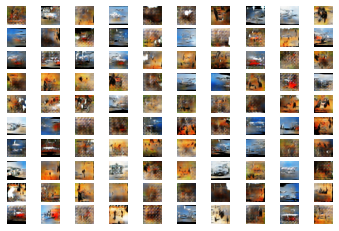

>63, 1/101, d1=0.723, d2=0.573 g=1.082
>63, 2/101, d1=0.813, d2=0.593 g=1.124
>63, 3/101, d1=0.669, d2=0.564 g=1.006
>63, 4/101, d1=0.707, d2=0.679 g=0.995
>63, 5/101, d1=0.639, d2=0.739 g=1.134
>63, 6/101, d1=0.716, d2=0.536 g=1.204
>63, 7/101, d1=0.804, d2=0.639 g=1.016
>63, 8/101, d1=0.683, d2=0.645 g=1.009
>63, 9/101, d1=0.640, d2=0.598 g=1.008
>63, 10/101, d1=0.591, d2=0.578 g=1.068
>63, 11/101, d1=0.603, d2=0.575 g=1.013
>63, 12/101, d1=0.640, d2=0.597 g=1.030
>63, 13/101, d1=0.635, d2=0.639 g=0.983
>63, 14/101, d1=0.623, d2=0.600 g=1.086
>63, 15/101, d1=0.601, d2=0.601 g=1.041
>63, 16/101, d1=0.609, d2=0.573 g=0.988
>63, 17/101, d1=0.588, d2=0.600 g=0.958
>63, 18/101, d1=0.508, d2=0.591 g=1.082
>63, 19/101, d1=0.600, d2=0.576 g=0.982
>63, 20/101, d1=0.610, d2=0.634 g=0.945
>63, 21/101, d1=0.503, d2=0.653 g=1.068
>63, 22/101, d1=0.623, d2=0.574 g=1.095
>63, 23/101, d1=0.732, d2=0.550 g=1.109
>63, 24/101, d1=0.649, d2=0.580 g=0.994
>63, 25/101, d1=0.613, d2=0.551 g=1.029
>63, 26/1

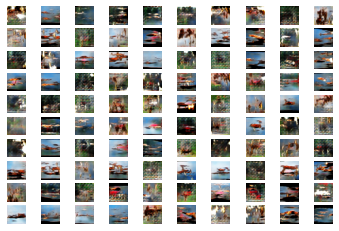

>64, 1/101, d1=0.619, d2=0.585 g=1.060
>64, 2/101, d1=0.661, d2=0.576 g=1.039
>64, 3/101, d1=0.640, d2=0.578 g=1.083
>64, 4/101, d1=0.557, d2=0.622 g=1.097
>64, 5/101, d1=0.572, d2=0.610 g=1.061
>64, 6/101, d1=0.673, d2=0.547 g=1.227
>64, 7/101, d1=0.575, d2=0.548 g=1.067
>64, 8/101, d1=0.637, d2=0.665 g=0.957
>64, 9/101, d1=0.617, d2=0.668 g=0.968
>64, 10/101, d1=0.628, d2=0.624 g=0.982
>64, 11/101, d1=0.668, d2=0.635 g=1.036
>64, 12/101, d1=0.683, d2=0.530 g=1.064
>64, 13/101, d1=0.541, d2=0.586 g=1.066
>64, 14/101, d1=0.707, d2=0.557 g=0.990
>64, 15/101, d1=0.604, d2=0.621 g=0.966
>64, 16/101, d1=0.519, d2=0.673 g=1.022
>64, 17/101, d1=0.623, d2=0.566 g=1.042
>64, 18/101, d1=0.688, d2=0.567 g=1.092
>64, 19/101, d1=0.598, d2=0.586 g=1.011
>64, 20/101, d1=0.660, d2=0.610 g=0.984
>64, 21/101, d1=0.613, d2=0.614 g=1.042
>64, 22/101, d1=0.703, d2=0.624 g=1.041
>64, 23/101, d1=0.616, d2=0.642 g=1.054
>64, 24/101, d1=0.733, d2=0.619 g=0.982
>64, 25/101, d1=0.674, d2=0.655 g=1.035
>64, 26/1

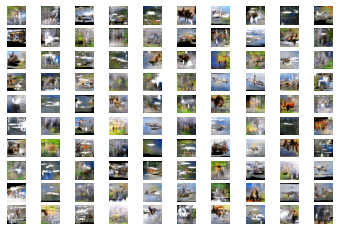

>65, 1/101, d1=0.686, d2=0.592 g=1.077
>65, 2/101, d1=0.670, d2=0.558 g=0.986
>65, 3/101, d1=0.649, d2=0.583 g=1.034
>65, 4/101, d1=0.549, d2=0.551 g=1.043
>65, 5/101, d1=0.620, d2=0.602 g=1.076
>65, 6/101, d1=0.707, d2=0.607 g=1.020
>65, 7/101, d1=0.694, d2=0.655 g=1.021
>65, 8/101, d1=0.701, d2=0.580 g=0.961
>65, 9/101, d1=0.666, d2=0.580 g=1.001
>65, 10/101, d1=0.628, d2=0.660 g=1.040
>65, 11/101, d1=0.628, d2=0.609 g=1.041
>65, 12/101, d1=0.636, d2=0.570 g=1.127
>65, 13/101, d1=0.687, d2=0.574 g=1.122
>65, 14/101, d1=0.747, d2=0.689 g=1.050
>65, 15/101, d1=0.661, d2=0.585 g=0.979
>65, 16/101, d1=0.549, d2=0.633 g=0.998
>65, 17/101, d1=0.699, d2=0.626 g=0.955
>65, 18/101, d1=0.654, d2=0.663 g=0.990
>65, 19/101, d1=0.654, d2=0.616 g=1.020
>65, 20/101, d1=0.753, d2=0.575 g=0.955
>65, 21/101, d1=0.610, d2=0.699 g=0.972
>65, 22/101, d1=0.658, d2=0.638 g=1.048
>65, 23/101, d1=0.620, d2=0.554 g=0.972
>65, 24/101, d1=0.602, d2=0.615 g=0.997
>65, 25/101, d1=0.587, d2=0.577 g=0.953
>65, 26/1

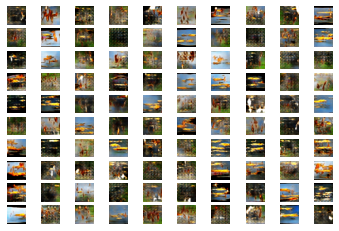

>66, 1/101, d1=0.644, d2=0.592 g=1.162
>66, 2/101, d1=0.597, d2=0.556 g=1.146
>66, 3/101, d1=0.615, d2=0.595 g=1.046
>66, 4/101, d1=0.601, d2=0.607 g=1.017
>66, 5/101, d1=0.627, d2=0.654 g=1.026
>66, 6/101, d1=0.720, d2=0.723 g=1.219
>66, 7/101, d1=0.746, d2=0.427 g=1.431
>66, 8/101, d1=0.702, d2=0.450 g=1.333
>66, 9/101, d1=0.629, d2=0.532 g=1.109
>66, 10/101, d1=0.586, d2=0.649 g=0.934
>66, 11/101, d1=0.528, d2=0.655 g=0.998
>66, 12/101, d1=0.653, d2=0.562 g=1.158
>66, 13/101, d1=0.644, d2=0.563 g=1.056
>66, 14/101, d1=0.648, d2=0.659 g=0.990
>66, 15/101, d1=0.574, d2=0.609 g=1.020
>66, 16/101, d1=0.628, d2=0.609 g=1.065
>66, 17/101, d1=0.542, d2=0.571 g=1.161
>66, 18/101, d1=0.616, d2=0.543 g=1.183
>66, 19/101, d1=0.623, d2=0.504 g=1.170
>66, 20/101, d1=0.510, d2=0.575 g=1.144
>66, 21/101, d1=0.564, d2=0.632 g=1.090
>66, 22/101, d1=0.695, d2=0.629 g=0.996
>66, 23/101, d1=0.615, d2=0.627 g=1.050
>66, 24/101, d1=0.705, d2=0.565 g=1.084
>66, 25/101, d1=0.627, d2=0.662 g=1.074
>66, 26/1

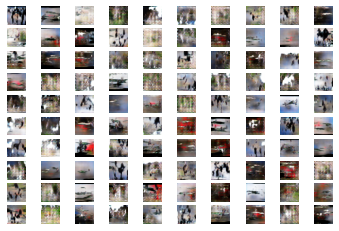

>67, 1/101, d1=0.618, d2=0.634 g=1.014
>67, 2/101, d1=0.561, d2=0.623 g=1.105
>67, 3/101, d1=0.632, d2=0.582 g=1.159
>67, 4/101, d1=0.728, d2=0.584 g=1.119
>67, 5/101, d1=0.670, d2=0.554 g=1.078
>67, 6/101, d1=0.592, d2=0.559 g=1.026
>67, 7/101, d1=0.649, d2=0.644 g=1.030
>67, 8/101, d1=0.578, d2=0.638 g=1.065
>67, 9/101, d1=0.663, d2=0.629 g=1.078
>67, 10/101, d1=0.591, d2=0.628 g=1.085
>67, 11/101, d1=0.582, d2=0.576 g=1.098
>67, 12/101, d1=0.715, d2=0.611 g=1.110
>67, 13/101, d1=0.625, d2=0.647 g=1.022
>67, 14/101, d1=0.629, d2=0.696 g=1.168
>67, 15/101, d1=0.689, d2=0.567 g=1.223
>67, 16/101, d1=0.679, d2=0.631 g=1.210
>67, 17/101, d1=0.667, d2=0.562 g=1.207
>67, 18/101, d1=0.576, d2=0.587 g=1.186
>67, 19/101, d1=0.558, d2=0.542 g=1.093
>67, 20/101, d1=0.665, d2=0.620 g=1.077
>67, 21/101, d1=0.623, d2=0.581 g=1.103
>67, 22/101, d1=0.590, d2=0.535 g=1.075
>67, 23/101, d1=0.626, d2=0.574 g=1.108
>67, 24/101, d1=0.574, d2=0.570 g=1.133
>67, 25/101, d1=0.687, d2=0.601 g=1.128
>67, 26/1

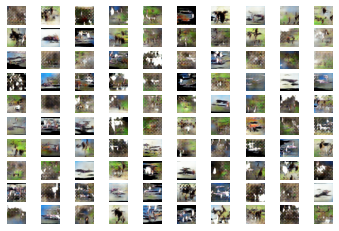

>68, 1/101, d1=0.524, d2=0.739 g=1.098
>68, 2/101, d1=0.581, d2=0.553 g=1.129
>68, 3/101, d1=0.634, d2=0.615 g=1.188
>68, 4/101, d1=0.714, d2=0.495 g=1.201
>68, 5/101, d1=0.626, d2=0.552 g=1.129
>68, 6/101, d1=0.594, d2=0.599 g=1.080
>68, 7/101, d1=0.610, d2=0.594 g=1.167
>68, 8/101, d1=0.668, d2=0.540 g=1.079
>68, 9/101, d1=0.676, d2=0.677 g=0.976
>68, 10/101, d1=0.661, d2=0.583 g=1.035
>68, 11/101, d1=0.514, d2=0.570 g=0.980
>68, 12/101, d1=0.573, d2=0.669 g=1.106
>68, 13/101, d1=0.562, d2=0.556 g=1.099
>68, 14/101, d1=0.592, d2=0.632 g=1.099
>68, 15/101, d1=0.620, d2=0.629 g=1.058
>68, 16/101, d1=0.672, d2=0.575 g=1.038
>68, 17/101, d1=0.655, d2=0.582 g=1.097
>68, 18/101, d1=0.638, d2=0.609 g=1.115
>68, 19/101, d1=0.620, d2=0.491 g=1.229
>68, 20/101, d1=0.687, d2=0.539 g=1.070
>68, 21/101, d1=0.646, d2=0.580 g=0.990
>68, 22/101, d1=0.661, d2=0.704 g=0.913
>68, 23/101, d1=0.565, d2=0.788 g=1.037
>68, 24/101, d1=0.659, d2=0.487 g=1.235
>68, 25/101, d1=0.617, d2=0.495 g=1.347
>68, 26/1

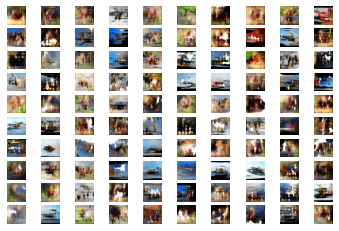

>69, 1/101, d1=0.680, d2=0.568 g=1.157
>69, 2/101, d1=0.593, d2=0.550 g=1.054
>69, 3/101, d1=0.543, d2=0.583 g=1.047
>69, 4/101, d1=0.547, d2=0.578 g=1.036
>69, 5/101, d1=0.654, d2=0.658 g=1.027
>69, 6/101, d1=0.580, d2=0.596 g=1.059
>69, 7/101, d1=0.638, d2=0.610 g=1.047
>69, 8/101, d1=0.653, d2=0.577 g=1.072
>69, 9/101, d1=0.650, d2=0.624 g=1.051
>69, 10/101, d1=0.592, d2=0.570 g=1.105
>69, 11/101, d1=0.584, d2=0.619 g=1.077
>69, 12/101, d1=0.590, d2=0.582 g=1.123
>69, 13/101, d1=0.604, d2=0.550 g=1.167
>69, 14/101, d1=0.521, d2=0.593 g=1.094
>69, 15/101, d1=0.662, d2=0.588 g=1.094
>69, 16/101, d1=0.623, d2=0.519 g=1.115
>69, 17/101, d1=0.629, d2=0.538 g=1.082
>69, 18/101, d1=0.612, d2=0.615 g=1.089
>69, 19/101, d1=0.633, d2=0.675 g=1.242
>69, 20/101, d1=0.661, d2=0.521 g=1.240
>69, 21/101, d1=0.671, d2=0.524 g=1.250
>69, 22/101, d1=0.701, d2=0.711 g=1.042
>69, 23/101, d1=0.665, d2=0.565 g=1.119
>69, 24/101, d1=0.603, d2=0.563 g=1.134
>69, 25/101, d1=0.698, d2=0.604 g=1.122
>69, 26/1

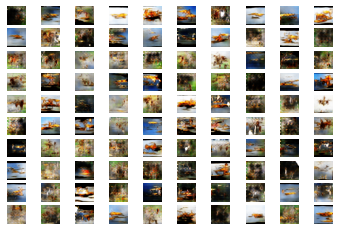

>70, 1/101, d1=0.566, d2=0.616 g=1.100
>70, 2/101, d1=0.579, d2=0.562 g=1.102
>70, 3/101, d1=0.568, d2=0.564 g=1.046
>70, 4/101, d1=0.538, d2=0.691 g=1.074
>70, 5/101, d1=0.668, d2=0.626 g=1.086
>70, 6/101, d1=0.607, d2=0.567 g=1.073
>70, 7/101, d1=0.621, d2=0.624 g=0.994
>70, 8/101, d1=0.582, d2=0.787 g=0.939
>70, 9/101, d1=0.703, d2=0.762 g=1.326
>70, 10/101, d1=0.851, d2=0.387 g=1.322
>70, 11/101, d1=0.875, d2=0.558 g=1.046
>70, 12/101, d1=0.598, d2=0.646 g=1.070
>70, 13/101, d1=0.662, d2=0.562 g=1.109
>70, 14/101, d1=0.653, d2=0.637 g=1.124
>70, 15/101, d1=0.643, d2=0.571 g=0.979
>70, 16/101, d1=0.621, d2=0.557 g=1.082
>70, 17/101, d1=0.541, d2=0.580 g=1.076
>70, 18/101, d1=0.638, d2=0.521 g=1.042
>70, 19/101, d1=0.598, d2=0.640 g=1.005
>70, 20/101, d1=0.522, d2=0.606 g=1.072
>70, 21/101, d1=0.608, d2=0.549 g=1.081
>70, 22/101, d1=0.584, d2=0.605 g=1.087
>70, 23/101, d1=0.616, d2=0.630 g=1.023
>70, 24/101, d1=0.555, d2=0.595 g=1.040
>70, 25/101, d1=0.609, d2=0.598 g=1.056
>70, 26/1

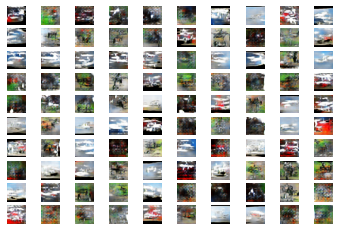

>71, 1/101, d1=0.527, d2=0.540 g=1.155
>71, 2/101, d1=0.601, d2=0.490 g=1.143
>71, 3/101, d1=0.511, d2=0.610 g=1.151
>71, 4/101, d1=0.546, d2=0.602 g=1.190
>71, 5/101, d1=0.565, d2=0.777 g=1.202
>71, 6/101, d1=0.701, d2=0.544 g=1.062
>71, 7/101, d1=0.637, d2=0.594 g=1.021
>71, 8/101, d1=0.622, d2=0.595 g=1.049
>71, 9/101, d1=0.645, d2=0.641 g=0.996
>71, 10/101, d1=0.621, d2=0.643 g=1.037
>71, 11/101, d1=0.554, d2=0.623 g=1.110
>71, 12/101, d1=0.642, d2=0.638 g=1.091
>71, 13/101, d1=0.653, d2=0.588 g=1.094
>71, 14/101, d1=0.731, d2=0.583 g=0.998
>71, 15/101, d1=0.671, d2=0.645 g=0.995
>71, 16/101, d1=0.637, d2=0.609 g=1.001
>71, 17/101, d1=0.576, d2=0.632 g=1.088
>71, 18/101, d1=0.663, d2=0.534 g=1.088
>71, 19/101, d1=0.695, d2=0.604 g=1.043
>71, 20/101, d1=0.651, d2=0.595 g=0.941
>71, 21/101, d1=0.560, d2=0.623 g=0.962
>71, 22/101, d1=0.555, d2=0.566 g=1.039
>71, 23/101, d1=0.598, d2=0.557 g=1.000
>71, 24/101, d1=0.486, d2=0.586 g=1.015
>71, 25/101, d1=0.593, d2=0.598 g=1.080
>71, 26/1

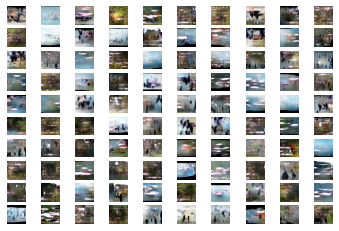

>72, 1/101, d1=0.547, d2=0.670 g=1.005
>72, 2/101, d1=0.534, d2=0.662 g=1.059
>72, 3/101, d1=0.636, d2=0.594 g=1.074
>72, 4/101, d1=0.643, d2=0.536 g=1.062
>72, 5/101, d1=0.589, d2=0.577 g=1.130
>72, 6/101, d1=0.558, d2=0.546 g=1.088
>72, 7/101, d1=0.643, d2=0.619 g=1.039
>72, 8/101, d1=0.586, d2=0.628 g=1.067
>72, 9/101, d1=0.523, d2=0.647 g=1.070
>72, 10/101, d1=0.605, d2=0.566 g=1.041
>72, 11/101, d1=0.514, d2=0.586 g=1.125
>72, 12/101, d1=0.548, d2=0.697 g=1.162
>72, 13/101, d1=0.665, d2=0.678 g=1.248
>72, 14/101, d1=0.666, d2=0.462 g=1.285
>72, 15/101, d1=0.717, d2=0.546 g=1.221
>72, 16/101, d1=0.740, d2=0.702 g=1.247
>72, 17/101, d1=0.666, d2=0.551 g=1.328
>72, 18/101, d1=0.802, d2=0.516 g=1.290
>72, 19/101, d1=0.688, d2=0.492 g=1.254
>72, 20/101, d1=0.847, d2=0.710 g=0.883
>72, 21/101, d1=0.574, d2=0.664 g=0.832
>72, 22/101, d1=0.570, d2=0.776 g=0.957
>72, 23/101, d1=0.580, d2=0.594 g=0.966
>72, 24/101, d1=0.549, d2=0.582 g=1.005
>72, 25/101, d1=0.624, d2=0.697 g=1.031
>72, 26/1

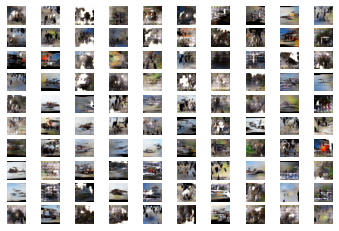

>73, 1/101, d1=0.646, d2=0.589 g=1.095
>73, 2/101, d1=0.616, d2=0.575 g=1.104
>73, 3/101, d1=0.534, d2=0.566 g=1.076
>73, 4/101, d1=0.651, d2=0.560 g=1.069
>73, 5/101, d1=0.614, d2=0.588 g=1.065
>73, 6/101, d1=0.584, d2=0.585 g=1.004
>73, 7/101, d1=0.626, d2=0.575 g=1.035
>73, 8/101, d1=0.536, d2=0.608 g=1.094
>73, 9/101, d1=0.564, d2=0.620 g=1.065
>73, 10/101, d1=0.520, d2=0.606 g=1.115
>73, 11/101, d1=0.617, d2=0.530 g=1.082
>73, 12/101, d1=0.620, d2=0.678 g=1.040
>73, 13/101, d1=0.678, d2=0.585 g=1.142
>73, 14/101, d1=0.660, d2=0.561 g=1.064
>73, 15/101, d1=0.616, d2=0.565 g=1.104
>73, 16/101, d1=0.588, d2=0.563 g=1.132
>73, 17/101, d1=0.593, d2=0.588 g=1.094
>73, 18/101, d1=0.638, d2=0.557 g=1.044
>73, 19/101, d1=0.684, d2=0.707 g=1.135
>73, 20/101, d1=0.723, d2=0.612 g=1.120
>73, 21/101, d1=0.647, d2=0.629 g=1.056
>73, 22/101, d1=0.747, d2=0.571 g=1.076
>73, 23/101, d1=0.588, d2=0.565 g=1.111
>73, 24/101, d1=0.540, d2=0.553 g=1.110
>73, 25/101, d1=0.591, d2=0.553 g=1.100
>73, 26/1

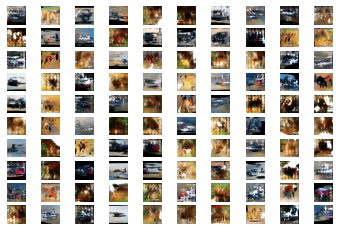

>74, 1/101, d1=0.675, d2=0.644 g=1.143
>74, 2/101, d1=0.602, d2=0.582 g=1.230
>74, 3/101, d1=0.698, d2=0.524 g=1.130
>74, 4/101, d1=0.625, d2=0.567 g=1.109
>74, 5/101, d1=0.618, d2=0.572 g=1.070
>74, 6/101, d1=0.608, d2=0.616 g=1.085
>74, 7/101, d1=0.639, d2=0.633 g=1.220
>74, 8/101, d1=0.634, d2=0.534 g=1.243
>74, 9/101, d1=0.718, d2=0.550 g=1.162
>74, 10/101, d1=0.610, d2=0.586 g=1.144
>74, 11/101, d1=0.618, d2=0.596 g=1.150
>74, 12/101, d1=0.710, d2=0.609 g=1.074
>74, 13/101, d1=0.672, d2=0.672 g=0.983
>74, 14/101, d1=0.627, d2=0.645 g=0.973
>74, 15/101, d1=0.474, d2=0.675 g=1.085
>74, 16/101, d1=0.639, d2=0.577 g=1.177
>74, 17/101, d1=0.575, d2=0.581 g=1.090
>74, 18/101, d1=0.564, d2=0.536 g=1.130
>74, 19/101, d1=0.535, d2=0.593 g=1.116
>74, 20/101, d1=0.571, d2=0.636 g=1.127
>74, 21/101, d1=0.645, d2=0.584 g=1.118
>74, 22/101, d1=0.633, d2=0.543 g=1.120
>74, 23/101, d1=0.556, d2=0.513 g=1.204
>74, 24/101, d1=0.619, d2=0.534 g=1.244
>74, 25/101, d1=0.653, d2=0.621 g=1.160
>74, 26/1

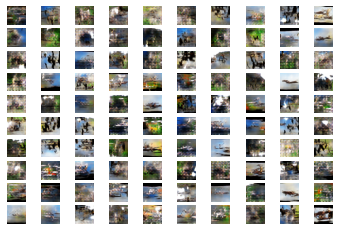

>75, 1/101, d1=0.642, d2=0.478 g=1.035
>75, 2/101, d1=0.566, d2=0.589 g=1.078
>75, 3/101, d1=0.592, d2=0.542 g=1.192
>75, 4/101, d1=0.680, d2=0.591 g=1.055
>75, 5/101, d1=0.611, d2=0.587 g=1.031
>75, 6/101, d1=0.610, d2=0.581 g=1.056
>75, 7/101, d1=0.634, d2=0.524 g=1.107
>75, 8/101, d1=0.725, d2=0.577 g=1.133
>75, 9/101, d1=0.596, d2=0.542 g=1.060
>75, 10/101, d1=0.578, d2=0.527 g=1.087
>75, 11/101, d1=0.556, d2=0.582 g=1.100
>75, 12/101, d1=0.557, d2=0.577 g=1.053
>75, 13/101, d1=0.555, d2=0.646 g=1.034
>75, 14/101, d1=0.572, d2=0.633 g=1.047
>75, 15/101, d1=0.634, d2=0.667 g=1.057
>75, 16/101, d1=0.669, d2=0.636 g=1.189
>75, 17/101, d1=0.611, d2=0.539 g=1.152
>75, 18/101, d1=0.549, d2=0.609 g=1.063
>75, 19/101, d1=0.589, d2=0.576 g=1.098
>75, 20/101, d1=0.562, d2=0.552 g=1.246
>75, 21/101, d1=0.617, d2=0.514 g=1.116
>75, 22/101, d1=0.628, d2=0.586 g=1.122
>75, 23/101, d1=0.595, d2=0.513 g=1.118
>75, 24/101, d1=0.595, d2=0.582 g=1.077
>75, 25/101, d1=0.593, d2=0.649 g=1.086
>75, 26/1

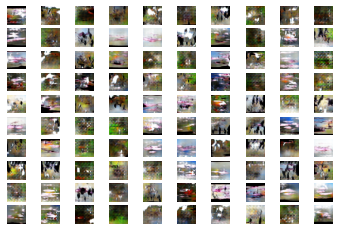

>76, 1/101, d1=0.627, d2=0.664 g=1.069
>76, 2/101, d1=0.584, d2=0.654 g=1.148
>76, 3/101, d1=0.519, d2=0.601 g=1.277
>76, 4/101, d1=0.627, d2=0.489 g=1.287
>76, 5/101, d1=0.649, d2=0.603 g=1.161
>76, 6/101, d1=0.591, d2=0.621 g=1.097
>76, 7/101, d1=0.578, d2=0.593 g=1.149
>76, 8/101, d1=0.616, d2=0.638 g=1.182
>76, 9/101, d1=0.685, d2=0.495 g=1.109
>76, 10/101, d1=0.551, d2=0.495 g=1.153
>76, 11/101, d1=0.517, d2=0.536 g=1.167
>76, 12/101, d1=0.566, d2=0.567 g=1.199
>76, 13/101, d1=0.562, d2=0.675 g=1.105
>76, 14/101, d1=0.664, d2=0.585 g=1.126
>76, 15/101, d1=0.577, d2=0.557 g=1.041
>76, 16/101, d1=0.602, d2=0.605 g=1.088
>76, 17/101, d1=0.551, d2=0.563 g=1.133
>76, 18/101, d1=0.575, d2=0.624 g=1.055
>76, 19/101, d1=0.514, d2=0.668 g=1.207
>76, 20/101, d1=0.564, d2=0.532 g=1.309
>76, 21/101, d1=0.666, d2=0.513 g=1.308
>76, 22/101, d1=0.717, d2=0.549 g=1.131
>76, 23/101, d1=0.697, d2=0.621 g=1.175
>76, 24/101, d1=0.618, d2=0.701 g=1.235
>76, 25/101, d1=0.662, d2=0.555 g=1.315
>76, 26/1

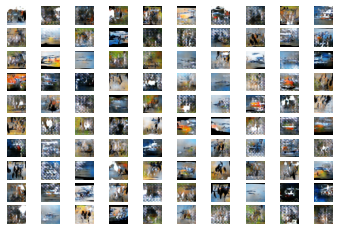

>77, 1/101, d1=0.595, d2=0.597 g=1.176
>77, 2/101, d1=0.626, d2=0.507 g=1.220
>77, 3/101, d1=0.610, d2=0.547 g=1.214
>77, 4/101, d1=0.706, d2=0.524 g=1.057
>77, 5/101, d1=0.618, d2=0.669 g=1.080
>77, 6/101, d1=0.641, d2=0.580 g=1.004
>77, 7/101, d1=0.540, d2=0.595 g=1.043
>77, 8/101, d1=0.577, d2=0.652 g=1.091
>77, 9/101, d1=0.651, d2=0.498 g=1.077
>77, 10/101, d1=0.649, d2=0.578 g=1.084
>77, 11/101, d1=0.501, d2=0.680 g=1.137
>77, 12/101, d1=0.608, d2=0.634 g=1.139
>77, 13/101, d1=0.737, d2=0.514 g=1.103
>77, 14/101, d1=0.657, d2=0.586 g=1.157
>77, 15/101, d1=0.645, d2=0.523 g=1.120
>77, 16/101, d1=0.617, d2=0.604 g=1.086
>77, 17/101, d1=0.525, d2=0.581 g=1.111
>77, 18/101, d1=0.577, d2=0.570 g=1.100
>77, 19/101, d1=0.640, d2=0.619 g=1.079
>77, 20/101, d1=0.582, d2=0.668 g=1.119
>77, 21/101, d1=0.604, d2=0.546 g=1.168
>77, 22/101, d1=0.651, d2=0.527 g=1.111
>77, 23/101, d1=0.639, d2=0.539 g=1.078
>77, 24/101, d1=0.606, d2=0.664 g=1.074
>77, 25/101, d1=0.456, d2=0.564 g=1.149
>77, 26/1

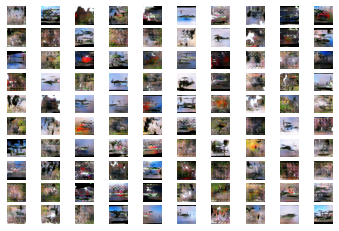

>78, 1/101, d1=0.690, d2=0.608 g=1.152
>78, 2/101, d1=0.581, d2=0.555 g=1.208
>78, 3/101, d1=0.570, d2=0.654 g=1.159
>78, 4/101, d1=0.551, d2=0.529 g=1.237
>78, 5/101, d1=0.680, d2=0.496 g=1.247
>78, 6/101, d1=0.554, d2=0.585 g=1.244
>78, 7/101, d1=0.607, d2=0.525 g=1.181
>78, 8/101, d1=0.614, d2=0.637 g=1.115
>78, 9/101, d1=0.630, d2=0.627 g=1.133
>78, 10/101, d1=0.583, d2=0.592 g=1.186
>78, 11/101, d1=0.728, d2=0.546 g=1.122
>78, 12/101, d1=0.632, d2=0.566 g=1.137
>78, 13/101, d1=0.679, d2=0.566 g=1.209
>78, 14/101, d1=0.710, d2=0.596 g=1.155
>78, 15/101, d1=0.640, d2=0.668 g=1.030
>78, 16/101, d1=0.708, d2=0.616 g=1.107
>78, 17/101, d1=0.646, d2=0.546 g=1.050
>78, 18/101, d1=0.588, d2=0.604 g=1.078
>78, 19/101, d1=0.557, d2=0.572 g=1.077
>78, 20/101, d1=0.596, d2=0.584 g=1.123
>78, 21/101, d1=0.509, d2=0.646 g=1.202
>78, 22/101, d1=0.660, d2=0.608 g=1.232
>78, 23/101, d1=0.572, d2=0.618 g=1.117
>78, 24/101, d1=0.652, d2=0.551 g=1.249
>78, 25/101, d1=0.760, d2=0.621 g=1.072
>78, 26/1

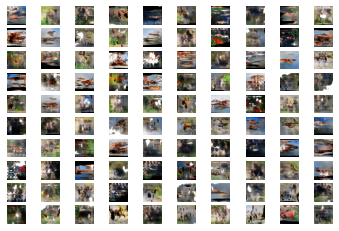

>79, 1/101, d1=0.609, d2=0.629 g=1.095
>79, 2/101, d1=0.690, d2=0.605 g=1.057
>79, 3/101, d1=0.590, d2=0.586 g=1.127
>79, 4/101, d1=0.486, d2=0.529 g=1.136
>79, 5/101, d1=0.582, d2=0.547 g=1.106
>79, 6/101, d1=0.686, d2=0.590 g=1.101
>79, 7/101, d1=0.624, d2=0.609 g=1.115
>79, 8/101, d1=0.497, d2=0.577 g=1.137
>79, 9/101, d1=0.797, d2=0.559 g=1.136
>79, 10/101, d1=0.669, d2=0.537 g=1.109
>79, 11/101, d1=0.650, d2=0.675 g=1.062
>79, 12/101, d1=0.540, d2=0.706 g=1.130
>79, 13/101, d1=0.645, d2=0.537 g=1.147
>79, 14/101, d1=0.708, d2=0.552 g=1.066
>79, 15/101, d1=0.581, d2=0.609 g=0.965
>79, 16/101, d1=0.537, d2=0.621 g=1.082
>79, 17/101, d1=0.535, d2=0.613 g=1.132
>79, 18/101, d1=0.578, d2=0.523 g=1.141
>79, 19/101, d1=0.638, d2=0.635 g=1.200
>79, 20/101, d1=0.662, d2=0.519 g=1.083
>79, 21/101, d1=0.562, d2=0.566 g=1.077
>79, 22/101, d1=0.541, d2=0.682 g=1.109
>79, 23/101, d1=0.752, d2=0.629 g=1.126
>79, 24/101, d1=0.699, d2=0.558 g=1.092
>79, 25/101, d1=0.668, d2=0.581 g=1.000
>79, 26/1

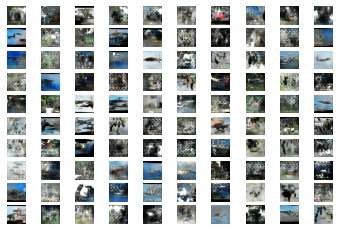

>80, 1/101, d1=0.688, d2=0.539 g=1.113
>80, 2/101, d1=0.673, d2=0.574 g=1.138
>80, 3/101, d1=0.681, d2=0.629 g=1.055
>80, 4/101, d1=0.564, d2=0.619 g=1.042
>80, 5/101, d1=0.575, d2=0.640 g=1.049
>80, 6/101, d1=0.516, d2=0.682 g=1.036
>80, 7/101, d1=0.548, d2=0.614 g=1.090
>80, 8/101, d1=0.614, d2=0.560 g=1.146
>80, 9/101, d1=0.701, d2=0.490 g=1.140
>80, 10/101, d1=0.550, d2=0.470 g=1.104
>80, 11/101, d1=0.513, d2=0.581 g=1.067
>80, 12/101, d1=0.496, d2=1.130 g=1.229
>80, 13/101, d1=0.674, d2=0.558 g=1.284
>80, 14/101, d1=0.770, d2=0.497 g=1.154
>80, 15/101, d1=0.703, d2=0.575 g=1.118
>80, 16/101, d1=0.699, d2=0.581 g=1.070
>80, 17/101, d1=0.728, d2=0.649 g=1.079
>80, 18/101, d1=0.634, d2=0.545 g=1.091
>80, 19/101, d1=0.614, d2=0.614 g=1.157
>80, 20/101, d1=0.649, d2=0.633 g=1.188
>80, 21/101, d1=0.634, d2=0.497 g=1.261
>80, 22/101, d1=0.692, d2=0.565 g=1.166
>80, 23/101, d1=0.561, d2=0.515 g=1.151
>80, 24/101, d1=0.562, d2=0.557 g=1.088
>80, 25/101, d1=0.484, d2=0.707 g=1.020
>80, 26/1

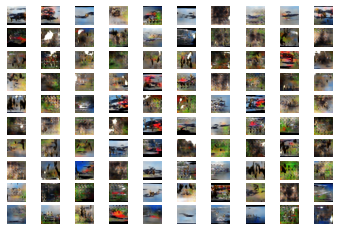

>81, 1/101, d1=0.626, d2=0.560 g=1.148
>81, 2/101, d1=0.608, d2=0.608 g=1.143
>81, 3/101, d1=0.628, d2=0.521 g=1.084
>81, 4/101, d1=0.616, d2=0.663 g=1.057
>81, 5/101, d1=0.612, d2=0.657 g=1.071
>81, 6/101, d1=0.636, d2=0.523 g=1.161
>81, 7/101, d1=0.664, d2=0.566 g=0.991
>81, 8/101, d1=0.573, d2=0.648 g=1.054
>81, 9/101, d1=0.552, d2=0.556 g=1.132
>81, 10/101, d1=0.650, d2=0.558 g=1.006
>81, 11/101, d1=0.594, d2=0.627 g=1.035
>81, 12/101, d1=0.626, d2=0.606 g=1.049
>81, 13/101, d1=0.627, d2=0.550 g=1.115
>81, 14/101, d1=0.681, d2=0.642 g=1.125
>81, 15/101, d1=0.553, d2=0.585 g=1.049
>81, 16/101, d1=0.639, d2=0.632 g=0.991
>81, 17/101, d1=0.560, d2=0.639 g=1.067
>81, 18/101, d1=0.567, d2=0.578 g=1.129
>81, 19/101, d1=0.618, d2=0.541 g=1.245
>81, 20/101, d1=0.709, d2=0.553 g=1.131
>81, 21/101, d1=0.643, d2=0.651 g=1.122
>81, 22/101, d1=0.684, d2=0.550 g=1.116
>81, 23/101, d1=0.646, d2=0.558 g=1.069
>81, 24/101, d1=0.582, d2=0.675 g=1.119
>81, 25/101, d1=0.588, d2=0.514 g=1.154
>81, 26/1

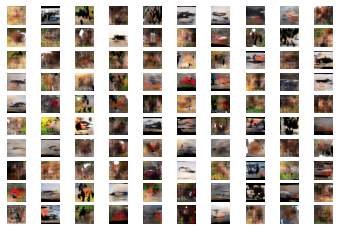

>82, 1/101, d1=0.685, d2=0.540 g=1.165
>82, 2/101, d1=0.668, d2=0.572 g=1.179
>82, 3/101, d1=0.566, d2=0.479 g=1.123
>82, 4/101, d1=0.473, d2=0.548 g=1.088
>82, 5/101, d1=0.458, d2=0.701 g=1.157
>82, 6/101, d1=0.679, d2=0.603 g=1.136
>82, 7/101, d1=0.705, d2=0.562 g=1.205
>82, 8/101, d1=0.554, d2=0.453 g=1.263
>82, 9/101, d1=0.497, d2=0.534 g=1.240
>82, 10/101, d1=0.561, d2=0.548 g=1.178
>82, 11/101, d1=0.463, d2=0.664 g=1.171
>82, 12/101, d1=0.634, d2=0.632 g=1.198
>82, 13/101, d1=0.604, d2=0.619 g=1.175
>82, 14/101, d1=0.717, d2=0.535 g=1.137
>82, 15/101, d1=0.658, d2=0.651 g=1.267
>82, 16/101, d1=0.738, d2=0.452 g=1.259
>82, 17/101, d1=0.606, d2=0.514 g=1.139
>82, 18/101, d1=0.552, d2=0.616 g=1.004
>82, 19/101, d1=0.438, d2=0.597 g=1.110
>82, 20/101, d1=0.592, d2=0.661 g=1.089
>82, 21/101, d1=0.664, d2=0.582 g=1.077
>82, 22/101, d1=0.663, d2=0.600 g=1.111
>82, 23/101, d1=0.650, d2=0.570 g=1.215
>82, 24/101, d1=0.707, d2=0.488 g=1.262
>82, 25/101, d1=0.690, d2=0.550 g=1.185
>82, 26/1

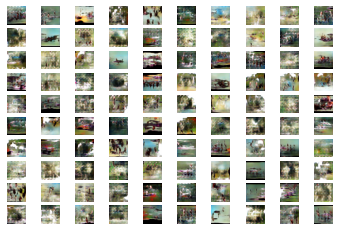

>83, 1/101, d1=0.768, d2=0.597 g=1.071
>83, 2/101, d1=0.616, d2=0.609 g=1.184
>83, 3/101, d1=0.617, d2=0.543 g=1.314
>83, 4/101, d1=0.543, d2=0.550 g=1.179
>83, 5/101, d1=0.591, d2=0.504 g=1.246
>83, 6/101, d1=0.556, d2=0.512 g=1.178
>83, 7/101, d1=0.583, d2=0.520 g=1.171
>83, 8/101, d1=0.528, d2=0.718 g=1.143
>83, 9/101, d1=0.557, d2=0.535 g=1.254
>83, 10/101, d1=0.617, d2=0.917 g=1.334
>83, 11/101, d1=0.730, d2=0.400 g=1.299
>83, 12/101, d1=0.776, d2=0.638 g=1.105
>83, 13/101, d1=0.634, d2=0.534 g=1.205
>83, 14/101, d1=0.598, d2=0.584 g=1.126
>83, 15/101, d1=0.584, d2=0.652 g=1.031
>83, 16/101, d1=0.542, d2=0.621 g=1.076
>83, 17/101, d1=0.499, d2=0.588 g=0.955
>83, 18/101, d1=0.582, d2=0.716 g=1.013
>83, 19/101, d1=0.598, d2=0.640 g=1.251
>83, 20/101, d1=0.687, d2=0.529 g=1.168
>83, 21/101, d1=0.644, d2=0.591 g=1.156
>83, 22/101, d1=0.624, d2=0.680 g=1.202
>83, 23/101, d1=0.695, d2=0.540 g=1.162
>83, 24/101, d1=0.646, d2=0.650 g=1.074
>83, 25/101, d1=0.562, d2=0.506 g=1.174
>83, 26/1

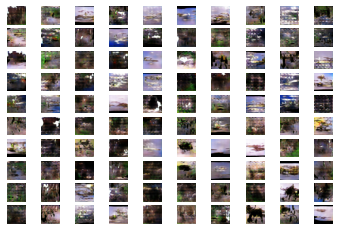

>84, 1/101, d1=0.560, d2=0.551 g=1.095
>84, 2/101, d1=0.630, d2=0.599 g=1.060
>84, 3/101, d1=0.525, d2=0.583 g=1.101
>84, 4/101, d1=0.597, d2=0.618 g=1.092
>84, 5/101, d1=0.591, d2=0.585 g=1.050
>84, 6/101, d1=0.536, d2=0.539 g=1.102
>84, 7/101, d1=0.697, d2=0.695 g=1.157
>84, 8/101, d1=0.544, d2=0.556 g=1.142
>84, 9/101, d1=0.554, d2=0.474 g=1.155
>84, 10/101, d1=0.603, d2=0.736 g=1.166
>84, 11/101, d1=0.642, d2=0.543 g=1.236
>84, 12/101, d1=0.640, d2=0.496 g=1.194
>84, 13/101, d1=0.569, d2=0.588 g=1.032
>84, 14/101, d1=0.549, d2=0.678 g=1.016
>84, 15/101, d1=0.607, d2=0.630 g=1.070
>84, 16/101, d1=0.522, d2=0.627 g=1.057
>84, 17/101, d1=0.545, d2=0.589 g=1.127
>84, 18/101, d1=0.608, d2=0.593 g=1.125
>84, 19/101, d1=0.551, d2=0.575 g=1.154
>84, 20/101, d1=0.538, d2=0.616 g=1.193
>84, 21/101, d1=0.619, d2=0.616 g=1.130
>84, 22/101, d1=0.633, d2=0.721 g=1.213
>84, 23/101, d1=0.642, d2=0.583 g=1.349
>84, 24/101, d1=0.730, d2=0.454 g=1.366
>84, 25/101, d1=0.711, d2=0.444 g=1.253
>84, 26/1

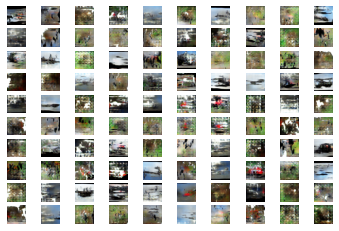

>85, 1/101, d1=0.586, d2=0.654 g=1.078
>85, 2/101, d1=0.628, d2=0.608 g=1.098
>85, 3/101, d1=0.631, d2=0.518 g=1.209
>85, 4/101, d1=0.560, d2=0.564 g=1.206
>85, 5/101, d1=0.614, d2=0.599 g=1.163
>85, 6/101, d1=0.720, d2=0.558 g=1.119
>85, 7/101, d1=0.723, d2=0.568 g=1.193
>85, 8/101, d1=0.706, d2=0.616 g=1.194
>85, 9/101, d1=0.648, d2=0.495 g=1.208
>85, 10/101, d1=0.613, d2=0.494 g=1.220
>85, 11/101, d1=0.566, d2=0.578 g=1.141
>85, 12/101, d1=0.553, d2=0.465 g=1.099
>85, 13/101, d1=0.598, d2=0.637 g=1.059
>85, 14/101, d1=0.616, d2=0.519 g=1.075
>85, 15/101, d1=0.556, d2=0.634 g=1.146
>85, 16/101, d1=0.504, d2=0.537 g=1.157
>85, 17/101, d1=0.577, d2=0.552 g=1.139
>85, 18/101, d1=0.591, d2=0.568 g=1.097
>85, 19/101, d1=0.603, d2=0.572 g=1.143
>85, 20/101, d1=0.568, d2=0.595 g=1.198
>85, 21/101, d1=0.633, d2=0.589 g=1.168
>85, 22/101, d1=0.563, d2=0.599 g=1.146
>85, 23/101, d1=0.534, d2=0.533 g=1.143
>85, 24/101, d1=0.593, d2=0.638 g=1.038
>85, 25/101, d1=0.542, d2=0.539 g=1.170
>85, 26/1

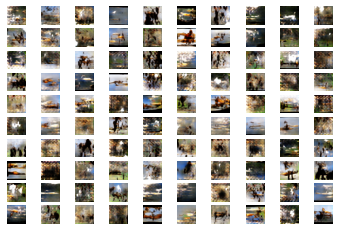

>86, 1/101, d1=0.624, d2=0.525 g=1.157
>86, 2/101, d1=0.671, d2=0.662 g=0.963
>86, 3/101, d1=0.700, d2=0.709 g=1.214
>86, 4/101, d1=0.576, d2=0.575 g=1.144
>86, 5/101, d1=0.640, d2=0.568 g=1.140
>86, 6/101, d1=0.577, d2=0.613 g=1.110
>86, 7/101, d1=0.580, d2=0.559 g=1.127
>86, 8/101, d1=0.502, d2=0.600 g=1.134
>86, 9/101, d1=0.595, d2=0.702 g=1.231
>86, 10/101, d1=0.699, d2=0.524 g=1.101
>86, 11/101, d1=0.629, d2=0.525 g=1.172
>86, 12/101, d1=0.612, d2=0.549 g=1.152
>86, 13/101, d1=0.571, d2=0.625 g=1.139
>86, 14/101, d1=0.544, d2=0.572 g=1.198
>86, 15/101, d1=0.584, d2=0.584 g=1.465
>86, 16/101, d1=0.497, d2=0.401 g=1.462
>86, 17/101, d1=0.568, d2=0.572 g=1.125
>86, 18/101, d1=0.420, d2=0.580 g=1.287
>86, 19/101, d1=0.587, d2=0.601 g=1.359
>86, 20/101, d1=0.594, d2=0.736 g=1.265
>86, 21/101, d1=0.640, d2=0.509 g=1.165
>86, 22/101, d1=0.711, d2=0.627 g=1.151
>86, 23/101, d1=0.627, d2=0.548 g=1.099
>86, 24/101, d1=0.639, d2=0.527 g=1.192
>86, 25/101, d1=0.533, d2=0.649 g=1.126
>86, 26/1

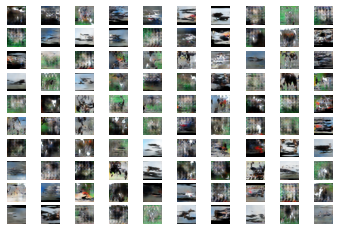

>87, 1/101, d1=0.519, d2=0.508 g=1.052
>87, 2/101, d1=0.570, d2=0.644 g=1.060
>87, 3/101, d1=0.565, d2=0.672 g=1.066
>87, 4/101, d1=0.651, d2=0.600 g=1.092
>87, 5/101, d1=0.564, d2=0.590 g=1.063
>87, 6/101, d1=0.638, d2=0.583 g=1.046
>87, 7/101, d1=0.543, d2=0.673 g=1.203
>87, 8/101, d1=0.577, d2=0.575 g=1.119
>87, 9/101, d1=0.646, d2=0.560 g=1.168
>87, 10/101, d1=0.605, d2=0.550 g=1.214
>87, 11/101, d1=0.623, d2=0.513 g=1.276
>87, 12/101, d1=0.570, d2=0.571 g=1.254
>87, 13/101, d1=0.722, d2=0.474 g=1.192
>87, 14/101, d1=0.525, d2=0.522 g=1.194
>87, 15/101, d1=0.609, d2=0.596 g=1.204
>87, 16/101, d1=0.584, d2=0.510 g=1.269
>87, 17/101, d1=0.722, d2=0.449 g=1.213
>87, 18/101, d1=0.737, d2=0.556 g=1.107
>87, 19/101, d1=0.623, d2=0.578 g=1.073
>87, 20/101, d1=0.505, d2=0.721 g=1.198
>87, 21/101, d1=0.560, d2=0.664 g=1.288
>87, 22/101, d1=0.666, d2=0.531 g=1.242
>87, 23/101, d1=0.534, d2=0.550 g=1.109
>87, 24/101, d1=0.663, d2=0.608 g=1.072
>87, 25/101, d1=0.638, d2=0.593 g=1.053
>87, 26/1

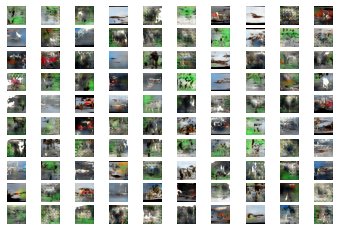

>88, 1/101, d1=0.609, d2=0.621 g=1.053
>88, 2/101, d1=0.557, d2=0.549 g=1.138
>88, 3/101, d1=0.662, d2=0.553 g=1.135
>88, 4/101, d1=0.652, d2=0.552 g=1.146
>88, 5/101, d1=0.519, d2=0.587 g=1.123
>88, 6/101, d1=0.518, d2=0.567 g=1.256
>88, 7/101, d1=0.704, d2=0.495 g=1.174
>88, 8/101, d1=0.540, d2=0.596 g=1.158
>88, 9/101, d1=0.506, d2=0.595 g=1.159
>88, 10/101, d1=0.585, d2=0.583 g=1.103
>88, 11/101, d1=0.581, d2=0.613 g=1.120
>88, 12/101, d1=0.624, d2=0.534 g=1.209
>88, 13/101, d1=0.634, d2=0.558 g=1.083
>88, 14/101, d1=0.662, d2=0.604 g=1.182
>88, 15/101, d1=0.645, d2=0.553 g=1.167
>88, 16/101, d1=0.662, d2=0.531 g=1.179
>88, 17/101, d1=0.523, d2=0.550 g=1.110
>88, 18/101, d1=0.535, d2=0.535 g=1.151
>88, 19/101, d1=0.494, d2=0.555 g=1.205
>88, 20/101, d1=0.606, d2=0.498 g=1.143
>88, 21/101, d1=0.513, d2=0.664 g=1.072
>88, 22/101, d1=0.643, d2=0.667 g=1.155
>88, 23/101, d1=0.634, d2=0.539 g=1.122
>88, 24/101, d1=0.631, d2=0.590 g=1.086
>88, 25/101, d1=0.636, d2=0.655 g=1.299
>88, 26/1

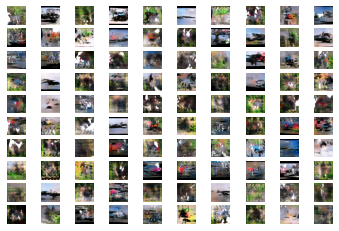

>89, 1/101, d1=0.614, d2=0.607 g=1.066
>89, 2/101, d1=0.610, d2=0.573 g=1.010
>89, 3/101, d1=0.527, d2=0.593 g=1.028
>89, 4/101, d1=0.595, d2=0.575 g=1.101
>89, 5/101, d1=0.683, d2=0.603 g=1.103
>89, 6/101, d1=0.673, d2=0.654 g=1.155
>89, 7/101, d1=0.633, d2=0.592 g=1.240
>89, 8/101, d1=0.635, d2=0.539 g=1.198
>89, 9/101, d1=0.739, d2=0.464 g=1.207
>89, 10/101, d1=0.623, d2=0.590 g=1.056
>89, 11/101, d1=0.673, d2=0.514 g=1.060
>89, 12/101, d1=0.547, d2=0.581 g=1.107
>89, 13/101, d1=0.488, d2=0.619 g=1.019
>89, 14/101, d1=0.483, d2=0.582 g=1.090
>89, 15/101, d1=0.576, d2=0.585 g=1.168
>89, 16/101, d1=0.520, d2=0.551 g=1.242
>89, 17/101, d1=0.495, d2=0.670 g=1.228
>89, 18/101, d1=0.571, d2=0.507 g=1.152
>89, 19/101, d1=0.605, d2=0.526 g=1.193
>89, 20/101, d1=0.564, d2=0.505 g=1.151
>89, 21/101, d1=0.621, d2=0.637 g=1.152
>89, 22/101, d1=0.653, d2=0.529 g=1.243
>89, 23/101, d1=0.608, d2=0.490 g=1.266
>89, 24/101, d1=0.704, d2=0.547 g=1.166
>89, 25/101, d1=0.579, d2=0.658 g=1.251
>89, 26/1

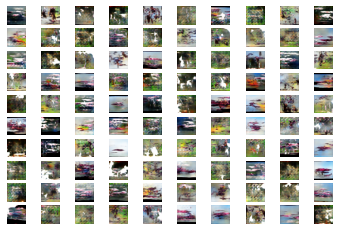

>90, 1/101, d1=0.598, d2=0.618 g=1.290
>90, 2/101, d1=0.641, d2=0.501 g=1.314
>90, 3/101, d1=0.616, d2=0.513 g=1.313
>90, 4/101, d1=0.595, d2=0.615 g=1.183
>90, 5/101, d1=0.638, d2=0.609 g=1.161
>90, 6/101, d1=0.624, d2=0.519 g=1.117
>90, 7/101, d1=0.571, d2=0.585 g=1.016
>90, 8/101, d1=0.567, d2=0.622 g=1.058
>90, 9/101, d1=0.534, d2=0.594 g=1.190
>90, 10/101, d1=0.642, d2=0.599 g=1.229
>90, 11/101, d1=0.742, d2=0.589 g=1.152
>90, 12/101, d1=0.590, d2=0.559 g=1.141
>90, 13/101, d1=0.639, d2=0.545 g=1.113
>90, 14/101, d1=0.647, d2=0.549 g=1.067
>90, 15/101, d1=0.593, d2=0.659 g=1.159
>90, 16/101, d1=0.606, d2=0.607 g=1.153
>90, 17/101, d1=0.573, d2=0.637 g=1.196
>90, 18/101, d1=0.519, d2=0.499 g=1.271
>90, 19/101, d1=0.531, d2=0.536 g=1.323
>90, 20/101, d1=0.743, d2=0.503 g=1.090
>90, 21/101, d1=0.585, d2=0.652 g=1.199
>90, 22/101, d1=0.564, d2=0.637 g=1.306
>90, 23/101, d1=0.690, d2=0.524 g=1.362
>90, 24/101, d1=0.663, d2=0.465 g=1.332
>90, 25/101, d1=0.699, d2=0.517 g=1.147
>90, 26/1

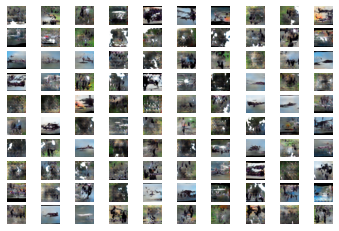

>91, 1/101, d1=0.716, d2=0.520 g=1.017
>91, 2/101, d1=0.519, d2=0.723 g=1.114
>91, 3/101, d1=0.651, d2=0.527 g=1.087
>91, 4/101, d1=0.611, d2=0.561 g=1.137
>91, 5/101, d1=0.541, d2=0.609 g=1.084
>91, 6/101, d1=0.582, d2=0.585 g=1.063
>91, 7/101, d1=0.554, d2=0.595 g=1.160
>91, 8/101, d1=0.606, d2=0.543 g=1.249
>91, 9/101, d1=0.605, d2=0.477 g=1.173
>91, 10/101, d1=0.585, d2=0.545 g=1.120
>91, 11/101, d1=0.522, d2=0.670 g=1.063
>91, 12/101, d1=0.506, d2=0.570 g=1.191
>91, 13/101, d1=0.490, d2=0.489 g=1.181
>91, 14/101, d1=0.676, d2=0.526 g=1.172
>91, 15/101, d1=0.595, d2=0.785 g=1.259
>91, 16/101, d1=0.703, d2=0.511 g=1.306
>91, 17/101, d1=0.752, d2=0.538 g=1.222
>91, 18/101, d1=0.582, d2=0.651 g=1.140
>91, 19/101, d1=0.565, d2=0.611 g=1.097
>91, 20/101, d1=0.652, d2=0.611 g=1.125
>91, 21/101, d1=0.637, d2=0.520 g=1.127
>91, 22/101, d1=0.527, d2=0.543 g=1.218
>91, 23/101, d1=0.538, d2=0.407 g=1.250
>91, 24/101, d1=0.453, d2=0.567 g=1.272
>91, 25/101, d1=0.460, d2=0.649 g=1.207
>91, 26/1

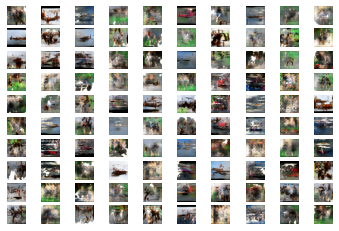

>92, 1/101, d1=0.581, d2=0.481 g=1.159
>92, 2/101, d1=0.671, d2=0.550 g=1.159
>92, 3/101, d1=0.595, d2=0.630 g=1.072
>92, 4/101, d1=0.606, d2=0.588 g=1.186
>92, 5/101, d1=0.707, d2=0.538 g=1.198
>92, 6/101, d1=0.611, d2=0.538 g=1.250
>92, 7/101, d1=0.580, d2=0.576 g=1.153
>92, 8/101, d1=0.521, d2=0.543 g=1.171
>92, 9/101, d1=0.688, d2=0.546 g=1.260
>92, 10/101, d1=0.634, d2=0.614 g=1.270
>92, 11/101, d1=0.672, d2=0.459 g=1.165
>92, 12/101, d1=0.742, d2=0.559 g=1.084
>92, 13/101, d1=0.515, d2=0.639 g=1.132
>92, 14/101, d1=0.567, d2=0.556 g=1.186
>92, 15/101, d1=0.505, d2=0.546 g=1.099
>92, 16/101, d1=0.466, d2=0.600 g=1.218
>92, 17/101, d1=0.519, d2=0.592 g=1.188
>92, 18/101, d1=0.472, d2=0.519 g=1.338
>92, 19/101, d1=0.709, d2=0.486 g=1.292
>92, 20/101, d1=0.681, d2=0.461 g=1.242
>92, 21/101, d1=0.702, d2=0.542 g=1.216
>92, 22/101, d1=0.623, d2=0.542 g=1.224
>92, 23/101, d1=0.594, d2=0.529 g=1.216
>92, 24/101, d1=0.515, d2=0.664 g=1.236
>92, 25/101, d1=0.572, d2=0.656 g=1.167
>92, 26/1

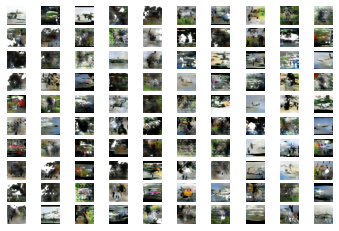

>93, 1/101, d1=0.641, d2=0.544 g=1.260
>93, 2/101, d1=0.570, d2=0.541 g=1.213
>93, 3/101, d1=0.670, d2=0.539 g=1.164
>93, 4/101, d1=0.592, d2=0.657 g=1.233
>93, 5/101, d1=0.696, d2=0.579 g=1.239
>93, 6/101, d1=0.648, d2=0.613 g=1.267
>93, 7/101, d1=0.627, d2=0.591 g=1.298
>93, 8/101, d1=0.661, d2=0.510 g=1.258
>93, 9/101, d1=0.658, d2=0.534 g=1.190
>93, 10/101, d1=0.565, d2=0.593 g=1.144
>93, 11/101, d1=0.600, d2=0.541 g=1.131
>93, 12/101, d1=0.617, d2=0.629 g=1.147
>93, 13/101, d1=0.621, d2=0.512 g=1.129
>93, 14/101, d1=0.600, d2=0.571 g=1.117
>93, 15/101, d1=0.600, d2=0.528 g=1.160
>93, 16/101, d1=0.663, d2=0.535 g=1.068
>93, 17/101, d1=0.591, d2=0.617 g=1.064
>93, 18/101, d1=0.556, d2=0.636 g=1.150
>93, 19/101, d1=0.543, d2=0.650 g=1.175
>93, 20/101, d1=0.577, d2=0.543 g=1.191
>93, 21/101, d1=0.650, d2=0.522 g=1.168
>93, 22/101, d1=0.635, d2=0.488 g=1.130
>93, 23/101, d1=0.463, d2=0.598 g=1.095
>93, 24/101, d1=0.526, d2=0.531 g=1.109
>93, 25/101, d1=0.658, d2=0.574 g=1.111
>93, 26/1

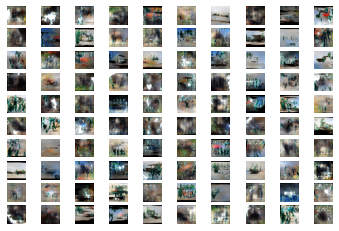

>94, 1/101, d1=0.827, d2=0.677 g=1.264
>94, 2/101, d1=0.712, d2=0.526 g=1.271
>94, 3/101, d1=0.562, d2=0.474 g=1.268
>94, 4/101, d1=0.601, d2=0.531 g=1.223
>94, 5/101, d1=0.536, d2=0.625 g=1.198
>94, 6/101, d1=0.436, d2=0.550 g=1.194
>94, 7/101, d1=0.478, d2=0.568 g=1.201
>94, 8/101, d1=0.612, d2=0.545 g=1.284
>94, 9/101, d1=0.522, d2=0.591 g=1.234
>94, 10/101, d1=0.492, d2=0.521 g=1.322
>94, 11/101, d1=0.652, d2=0.582 g=1.234
>94, 12/101, d1=0.623, d2=0.580 g=1.180
>94, 13/101, d1=0.684, d2=0.613 g=1.190
>94, 14/101, d1=0.573, d2=0.604 g=1.300
>94, 15/101, d1=0.612, d2=0.488 g=1.350
>94, 16/101, d1=0.600, d2=0.562 g=1.200
>94, 17/101, d1=0.503, d2=0.617 g=1.319
>94, 18/101, d1=0.639, d2=0.467 g=1.303
>94, 19/101, d1=0.752, d2=0.574 g=1.270
>94, 20/101, d1=0.652, d2=0.565 g=1.217
>94, 21/101, d1=0.544, d2=0.532 g=1.134
>94, 22/101, d1=0.566, d2=0.505 g=1.116
>94, 23/101, d1=0.528, d2=0.536 g=1.189
>94, 24/101, d1=0.541, d2=0.587 g=1.153
>94, 25/101, d1=0.628, d2=0.485 g=1.267
>94, 26/1

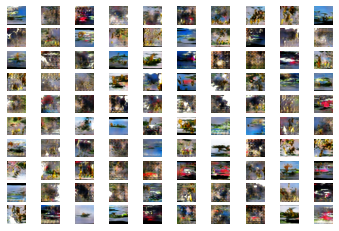

>95, 1/101, d1=0.486, d2=0.555 g=1.180
>95, 2/101, d1=0.596, d2=0.647 g=1.226
>95, 3/101, d1=0.555, d2=0.539 g=1.312
>95, 4/101, d1=0.738, d2=0.510 g=1.200
>95, 5/101, d1=0.672, d2=0.674 g=1.091
>95, 6/101, d1=0.685, d2=0.556 g=1.078
>95, 7/101, d1=0.708, d2=0.743 g=1.181
>95, 8/101, d1=0.697, d2=0.503 g=1.253
>95, 9/101, d1=0.682, d2=0.563 g=1.098
>95, 10/101, d1=0.594, d2=0.516 g=1.076
>95, 11/101, d1=0.561, d2=0.584 g=1.085
>95, 12/101, d1=0.562, d2=0.669 g=1.079
>95, 13/101, d1=0.563, d2=0.510 g=1.140
>95, 14/101, d1=0.547, d2=0.494 g=1.053
>95, 15/101, d1=0.620, d2=0.654 g=1.148
>95, 16/101, d1=0.626, d2=0.535 g=1.189
>95, 17/101, d1=0.641, d2=0.507 g=1.146
>95, 18/101, d1=0.596, d2=0.544 g=1.077
>95, 19/101, d1=0.591, d2=0.582 g=0.984
>95, 20/101, d1=0.502, d2=0.712 g=1.033
>95, 21/101, d1=0.490, d2=0.612 g=1.134
>95, 22/101, d1=0.690, d2=0.525 g=1.164
>95, 23/101, d1=0.624, d2=0.581 g=1.243
>95, 24/101, d1=0.678, d2=0.544 g=1.218
>95, 25/101, d1=0.592, d2=0.593 g=1.128
>95, 26/1

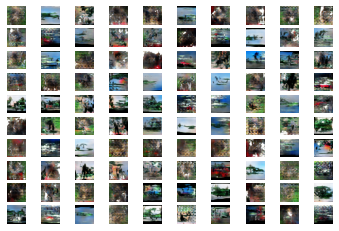

>96, 1/101, d1=0.654, d2=0.645 g=1.244
>96, 2/101, d1=0.680, d2=0.472 g=1.221
>96, 3/101, d1=0.529, d2=0.588 g=1.260
>96, 4/101, d1=0.718, d2=0.494 g=1.219
>96, 5/101, d1=0.560, d2=0.496 g=1.210
>96, 6/101, d1=0.599, d2=0.579 g=1.094
>96, 7/101, d1=0.405, d2=0.636 g=1.052
>96, 8/101, d1=0.499, d2=0.539 g=1.140
>96, 9/101, d1=0.590, d2=0.609 g=1.163
>96, 10/101, d1=0.584, d2=0.569 g=1.209
>96, 11/101, d1=0.627, d2=0.543 g=1.232
>96, 12/101, d1=0.648, d2=0.500 g=1.189
>96, 13/101, d1=0.607, d2=0.476 g=1.241
>96, 14/101, d1=0.615, d2=0.527 g=1.164
>96, 15/101, d1=0.566, d2=0.683 g=1.180
>96, 16/101, d1=0.573, d2=0.580 g=1.244
>96, 17/101, d1=0.578, d2=0.497 g=1.399
>96, 18/101, d1=0.705, d2=0.496 g=1.323
>96, 19/101, d1=0.606, d2=0.550 g=1.159
>96, 20/101, d1=0.587, d2=0.613 g=1.029
>96, 21/101, d1=0.592, d2=0.756 g=1.001
>96, 22/101, d1=0.574, d2=0.566 g=1.145
>96, 23/101, d1=0.574, d2=0.552 g=1.258
>96, 24/101, d1=0.591, d2=0.574 g=1.230
>96, 25/101, d1=0.629, d2=0.511 g=1.172
>96, 26/1

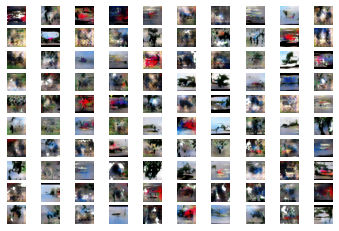

>97, 1/101, d1=0.703, d2=0.506 g=1.209
>97, 2/101, d1=0.654, d2=0.585 g=1.032
>97, 3/101, d1=0.554, d2=0.588 g=1.076
>97, 4/101, d1=0.514, d2=0.632 g=1.152
>97, 5/101, d1=0.615, d2=0.605 g=1.185
>97, 6/101, d1=0.584, d2=0.517 g=1.284
>97, 7/101, d1=0.650, d2=0.456 g=1.221
>97, 8/101, d1=0.664, d2=0.529 g=1.163
>97, 9/101, d1=0.494, d2=0.628 g=1.248
>97, 10/101, d1=0.604, d2=0.519 g=1.185
>97, 11/101, d1=0.535, d2=0.544 g=1.201
>97, 12/101, d1=0.531, d2=0.584 g=1.121
>97, 13/101, d1=0.552, d2=0.620 g=1.154
>97, 14/101, d1=0.601, d2=0.540 g=1.210
>97, 15/101, d1=0.561, d2=0.661 g=1.232
>97, 16/101, d1=0.623, d2=0.473 g=1.318
>97, 17/101, d1=0.769, d2=0.525 g=1.260
>97, 18/101, d1=0.656, d2=0.606 g=1.228
>97, 19/101, d1=0.678, d2=0.584 g=1.262
>97, 20/101, d1=0.561, d2=0.615 g=1.226
>97, 21/101, d1=0.513, d2=0.571 g=1.099
>97, 22/101, d1=0.547, d2=0.595 g=1.099
>97, 23/101, d1=0.592, d2=0.601 g=1.217
>97, 24/101, d1=0.534, d2=0.512 g=1.289
>97, 25/101, d1=0.623, d2=0.519 g=1.251
>97, 26/1

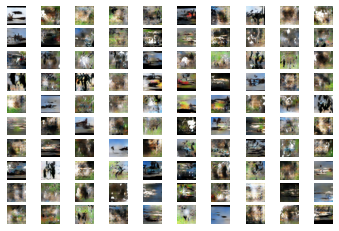

>98, 1/101, d1=0.701, d2=0.580 g=1.082
>98, 2/101, d1=0.581, d2=0.623 g=1.069
>98, 3/101, d1=0.596, d2=0.547 g=1.020
>98, 4/101, d1=0.583, d2=0.552 g=1.121
>98, 5/101, d1=0.548, d2=0.640 g=1.103
>98, 6/101, d1=0.526, d2=0.548 g=1.099
>98, 7/101, d1=0.589, d2=0.581 g=1.150
>98, 8/101, d1=0.520, d2=0.540 g=1.110
>98, 9/101, d1=0.633, d2=0.552 g=1.198
>98, 10/101, d1=0.557, d2=0.550 g=1.141
>98, 11/101, d1=0.578, d2=0.630 g=1.158
>98, 12/101, d1=0.562, d2=0.603 g=1.201
>98, 13/101, d1=0.635, d2=0.569 g=1.162
>98, 14/101, d1=0.655, d2=0.496 g=1.155
>98, 15/101, d1=0.559, d2=0.612 g=1.176
>98, 16/101, d1=0.643, d2=0.541 g=1.286
>98, 17/101, d1=0.641, d2=0.480 g=1.168
>98, 18/101, d1=0.700, d2=0.613 g=1.163
>98, 19/101, d1=0.542, d2=0.540 g=1.171
>98, 20/101, d1=0.499, d2=0.550 g=1.204
>98, 21/101, d1=0.534, d2=0.501 g=1.263
>98, 22/101, d1=0.590, d2=0.505 g=1.132
>98, 23/101, d1=0.570, d2=0.585 g=1.222
>98, 24/101, d1=0.596, d2=0.569 g=1.242
>98, 25/101, d1=0.557, d2=0.478 g=1.143
>98, 26/1

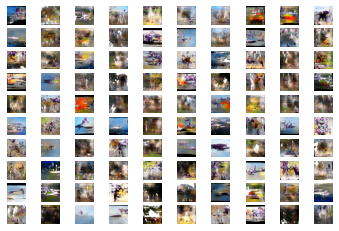

>99, 1/101, d1=0.726, d2=0.597 g=1.310
>99, 2/101, d1=0.576, d2=0.541 g=1.201
>99, 3/101, d1=0.589, d2=0.575 g=1.142
>99, 4/101, d1=0.606, d2=0.610 g=1.211
>99, 5/101, d1=0.655, d2=0.538 g=1.164
>99, 6/101, d1=0.623, d2=0.577 g=1.246
>99, 7/101, d1=0.615, d2=0.488 g=1.201
>99, 8/101, d1=0.547, d2=0.558 g=1.299
>99, 9/101, d1=0.641, d2=0.419 g=1.247
>99, 10/101, d1=0.632, d2=0.519 g=1.193
>99, 11/101, d1=0.579, d2=0.496 g=1.235
>99, 12/101, d1=0.505, d2=0.605 g=1.162
>99, 13/101, d1=0.563, d2=0.603 g=1.064
>99, 14/101, d1=0.599, d2=0.697 g=1.169
>99, 15/101, d1=0.538, d2=0.515 g=1.193
>99, 16/101, d1=0.592, d2=0.585 g=1.143
>99, 17/101, d1=0.546, d2=0.545 g=1.106
>99, 18/101, d1=0.545, d2=0.599 g=1.159
>99, 19/101, d1=0.533, d2=0.562 g=1.299
>99, 20/101, d1=0.599, d2=0.467 g=1.392
>99, 21/101, d1=0.587, d2=0.482 g=1.303
>99, 22/101, d1=0.631, d2=0.450 g=1.251
>99, 23/101, d1=0.591, d2=0.582 g=1.237
>99, 24/101, d1=0.557, d2=0.647 g=1.130
>99, 25/101, d1=0.576, d2=0.594 g=1.093
>99, 26/1

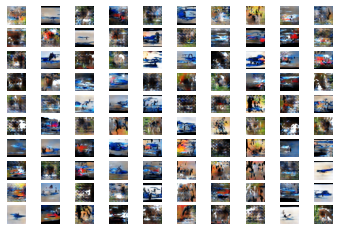

>100, 1/101, d1=0.435, d2=0.478 g=1.269
>100, 2/101, d1=0.641, d2=0.567 g=1.298
>100, 3/101, d1=0.725, d2=0.539 g=1.323
>100, 4/101, d1=0.659, d2=0.524 g=1.364
>100, 5/101, d1=0.596, d2=0.549 g=1.367
>100, 6/101, d1=0.636, d2=0.502 g=1.151
>100, 7/101, d1=0.542, d2=0.659 g=1.090
>100, 8/101, d1=0.590, d2=0.697 g=1.109
>100, 9/101, d1=0.542, d2=0.497 g=1.218
>100, 10/101, d1=0.617, d2=0.528 g=1.159
>100, 11/101, d1=0.551, d2=0.498 g=1.263
>100, 12/101, d1=0.538, d2=0.533 g=1.257
>100, 13/101, d1=0.558, d2=0.531 g=1.353
>100, 14/101, d1=0.453, d2=0.481 g=1.316
>100, 15/101, d1=0.531, d2=0.491 g=1.400
>100, 16/101, d1=0.531, d2=0.600 g=1.342
>100, 17/101, d1=0.611, d2=0.586 g=1.299
>100, 18/101, d1=0.556, d2=0.587 g=1.332
>100, 19/101, d1=0.701, d2=0.528 g=1.371
>100, 20/101, d1=0.722, d2=0.490 g=1.205
>100, 21/101, d1=0.558, d2=0.621 g=1.199
>100, 22/101, d1=0.511, d2=0.539 g=1.176
>100, 23/101, d1=0.516, d2=0.596 g=1.281
>100, 24/101, d1=0.501, d2=0.519 g=1.307
>100, 25/101, d1=0.539, d

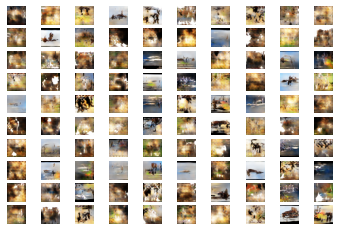

In [68]:
# train model
all_disc_loss, all_gen_loss = train(g_model, d_model, gan_model, dataset, latent_dim)

#### Step 5 | Generating Samples and Analysis

- Generate random noise samples and their corresponding fake images. For you convience, you can find some samples here [Real Samples](https://drive.google.com/file/d/1bNiPFu4StxBvdhqslM5d7ad3-mycwrMu/view?usp=sharing)
[Fake Samples](https://drive.google.com/file/d/12fIGZ_6NAC58KEgQuQfeOYVOFw45AjdD/view?usp=sharing)
These are just fake samples, you can generate better images. 

In [57]:
def plot_loss(gen_loss,disc_loss):
    plt.plot(gen_loss)
    plt.plot(disc_loss)
    plt.title('GAN Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Generator', 'Discriminator'], loc='upper left')
    plt.show()

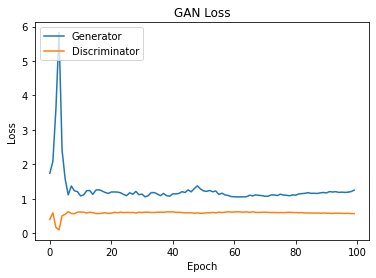

In [69]:
# WRITE YOU CODE HERE TO PLOT HISTORY

plot_loss(all_gen_loss, all_disc_loss)

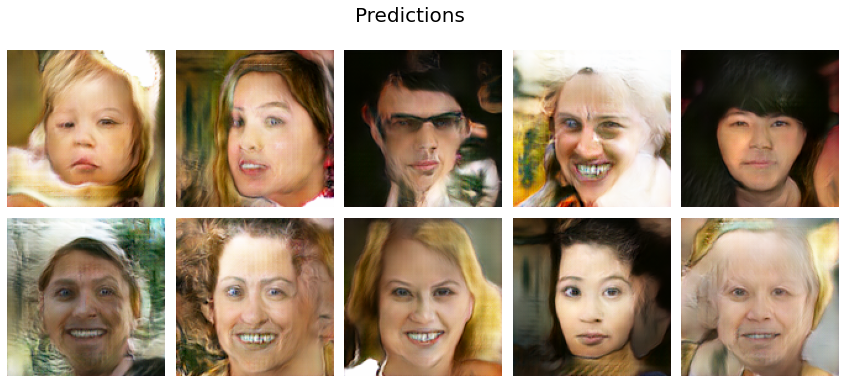

In [91]:
# Predicting and displaying

g_model = define_generator(100)
g_model.load_weights('/drive/MyDrive/CS437_Deep_Learning/HW5_21100157/part1_cgan_generator.h5')

latent_points = generate_latent_point(100, 100)
X = g_model.predict(latent_points)
display_image_grid(X, 2, 5, "Predictions")

## Task 1| Part (b) - [Grads Only/ 10% Bonus marks for Undergradudates ]

Use Mean squared Error Loss function for CGANs and differentiate between generated images.
Add your answer which Loss function (MSE, BCE) is better for stl10 classification and why.





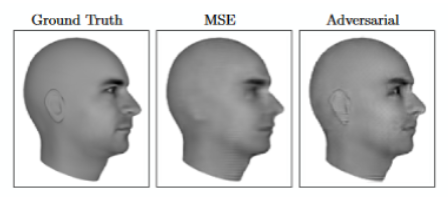

In [ ]:
# WRITE YOUR CODE HERE
'''
Modify you networks
'''

## Task 2 | Interpolation

We'll use the same dataset as used for assignment 4. Model Weight is provided

In [ ]:
from google.colab import drive
drive.mount('/drive', force_remount=True)

Mounted at /drive


In [ ]:
import os
import keras
import random
import numpy as np
from glob import glob
import tensorflow as tf
import keras.backend as K
from keras.layers import *
from scipy.stats import norm
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import tensorflow_datasets as tfds
from keras.utils import to_categorical
from keras.models import Sequential, Model
from keras.initializers import RandomNormal
from mpl_toolkits.axes_grid1 import ImageGrid
from keras.utils.generic_utils import Progbar
from keras.optimizers import Adam, SGD, RMSprop
from keras.preprocessing.image import ImageDataGenerator
from google_drive_downloader import GoogleDriveDownloader as gdd
import os.path
import os
from numpy.random import randn
from numpy.random import randint

In [86]:
## Helper Functions
def sample_noise():
    return np.reshape(np.random.randn(NOISE_DIM * BATCH_SIZE),(BATCH_SIZE,NOISE_DIM))

def load_data():
    dataloader = tfds.load("Stl10", as_supervised=True)
    train, test = dataloader["train"], dataloader["test"]
    return (train, test)

def create_image_grid(array, ncols=None):
    num_images, cell_h, cell_w, channels = array.shape
    if not ncols:
        ncols = int(np.sqrt(num_images))
    nrows = int(np.math.floor(num_images / float(ncols)))
    result = np.zeros((cell_h*nrows, cell_w*ncols, channels), dtype=array.dtype)
    for i in range(0, nrows):
        for j in range(0, ncols):
            result[i*cell_h:(i+1)*cell_h, j*cell_w:(j+1)*cell_w, :] = array[i*ncols+j]

    if channels == 1:
        result = result.squeeze()
    return result

def display_image_grid(images, num_rows, num_cols, title_text):

    fig = plt.figure(figsize=(num_cols*3., num_rows*3.), )
    grid = ImageGrid(fig, 111, nrows_ncols=(num_rows, num_cols), axes_pad=0.15)

    for ax, im in zip(grid, images):
        im = im/np.amax(im)
        im = np.clip(im, 0, 1)
        ax.imshow(im)
        ax.axis("off")
    
    plt.suptitle(title_text, fontsize=20)
    plt.show()

In [ ]:
# Dataset link: https://tinyurl.com/hw04dataset
if not os.path.isfile('/content/ffhq-dataset.zip'):
  gdd.download_file_from_google_drive(file_id='1lhIylJPa9H3yS0iGyYZqK01JtYRQvjr1', dest_path='/content/ffhq-dataset.zip', unzip=False)

In [ ]:
# replace this your google drive path of the zip file of dataset provided with this homework
if not os.path.isdir('/content/data'):
  !unzip -o -q "/content/ffhq-dataset.zip" -d "/content/data/"

In [ ]:
# data folder path in colab runtime enviroment
DATA_FOLDER = '/content/data/'

# fetching all the filenmaes to read them later in generator
filenames = np.array(glob(os.path.join(DATA_FOLDER, '*/*.png')))

# total images in directory
NUM_IMAGES = len(filenames)
print("Total number of images : " + str(NUM_IMAGES))

Total number of images : 70000


In [ ]:
INPUT_DIM = (128, 128, 3) 
BATCH_SIZE = 512        
Z_DIM = 100             

data_flow = ImageDataGenerator(rescale=1./255).flow_from_directory(DATA_FOLDER, target_size = INPUT_DIM[:2], 
                                                                   batch_size = BATCH_SIZE, shuffle = True, 
                                                                   class_mode = 'input', subset = 'training')

Found 70000 images belonging to 1 classes.


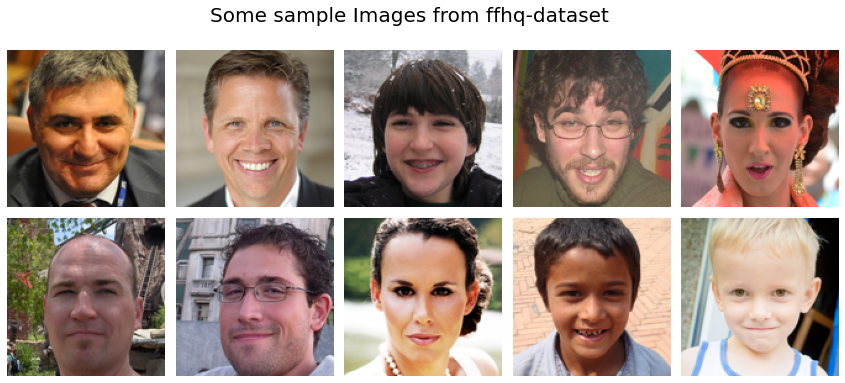

In [ ]:
# a batch of 512 images returned by data generator
sample_images = next(data_flow)[0] 

# only taking 10 of those to display
sample_images = sample_images[:10]

# displaying the images
display_image_grid(sample_images, 2, 5, "Some sample Images from ffhq-dataset")

*  Model weights are provided to you, use that model and interpolate 5 images.
*  If you want to train the model from scratch it's up to you.



In [84]:
def define_generator(latent_dim):
	model = Sequential()
	n_nodes = 128 * 4 * 4
	model.add(Dense(n_nodes, input_dim=latent_dim))
	model.add(LeakyReLU(alpha=0.2))
	model.add(Reshape((4, 4, 128)))
	model.add(Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
	model.add(Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
	model.add(Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
	model.add(Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
	model.add(Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
	model.add(Conv2D(3, (5, 5), activation='tanh', padding='same'))
	return model

In [87]:
def generate_latent_points(latent_dim, n_samples):
	x_input = randn(latent_dim * n_samples)
	x_input = x_input.reshape(n_samples, latent_dim)
	return x_input

In [88]:
def show_plot(examples, n):
	for i in range(n * n):
		plt.subplot(n, n, 1 + i)
		plt.axis('off')
		plt.imshow(examples[i, :, :, 0], cmap='gray_r')
	plt.show()

In [ ]:
g_model = define_generator(100)
g_model.load_weights("/drive/MyDrive/CS437_Deep_Learning/HW5_21100157/generator.h5")

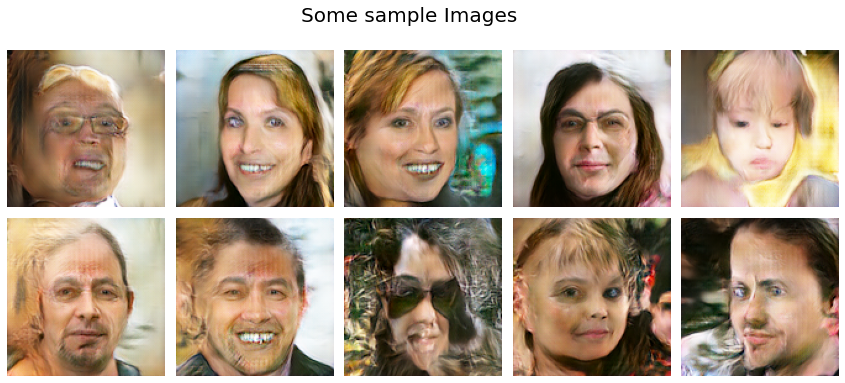

In [ ]:
# Some Fake Samples
latent_points = generate_latent_points(100, 100)
X = g_model.predict(latent_points)
display_image_grid(X, 2, 5, "Some sample Images")

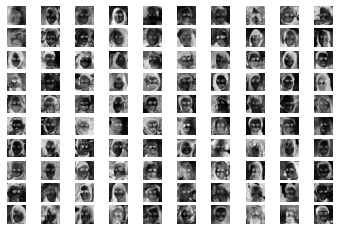

In [ ]:
show_plot(X, 10)

You can play around with the images for example:
	
1.  *Glasses on Woman - Neutral Woman + Neutral Man = Glasses on Man*
2.  *Smile on Woman - Neutral Woman + Neutral Man = smile on Man*

Create 10 different scenarios and display

In [ ]:
# WRITE YOUR CODE HERE

def interpolation(firstPoint, secondPoint):
  sequence = np.linspace(0, 1, 10)
  interpolated = []
  for point in sequence:
    v = ((1.0 - point) * firstPoint) + (point * secondPoint)
    interpolated.append(v)
  return np.array(interpolated)

#### Display Results

In [ ]:
# WRITE YOUR CODE HERE

def displayScenerios(g_model):
  latent_points = generate_latent_points(100, 20)

  interpolated = interpolation(latent_points[0], latent_points[0 + 1])
  X = g_model.predict(interpolated)
  firstArray = X

  interpolated = interpolation(latent_points[2], latent_points[2 + 1])
  X = g_model.predict(interpolated)
  secondArray = X

  stacked = np.vstack((firstArray, secondArray))

  for i in range(4, 20, 2):
    interpolated = interpolation(latent_points[i], latent_points[i + 1])
    X = g_model.predict(interpolated)
    stacked = np.vstack((stacked, X))
  
  display_image_grid(stacked, 10, 10, "10 Difference Scenerios")

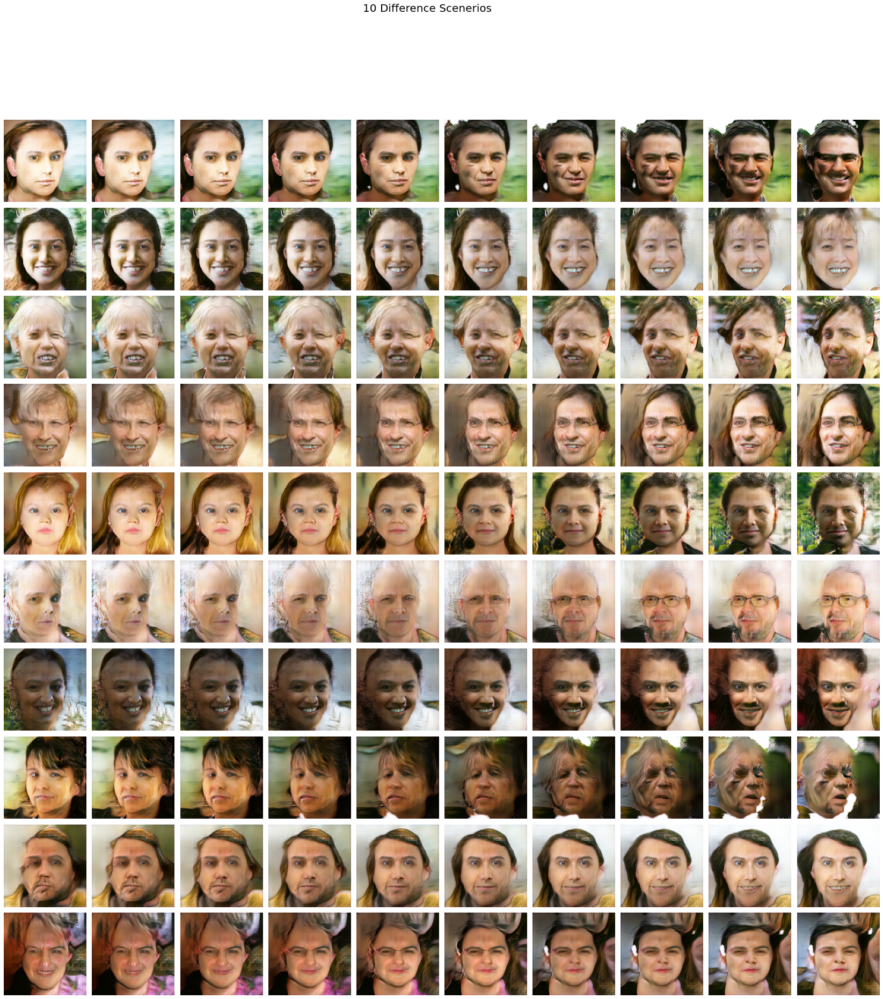

In [ ]:
displayScenerios(g_model)